# Exploring Feature Extraction Capabilities of the STEN Model for Creeping Landslides

## Introduction

This notebook investigates the feature extraction capabilities of our STEN in the context of creeping landslides. The analysis responds to a reviewer's suggestion to delve deeper into the model's ability to process data and extract relevant features, particularly in terms of capturing seasonal and trend-based deformation patterns. By examining the cyclic and trend-related features learned by the network, we aim to gain insights into how the STEN model handles the complex temporal dynamics of slow-moving landslide processes.

### Objective

The primary objective of this study is to explore and interpret the cyclic and trend-based features that the STEN model extracts from creeping landslide deformation data. This investigation will provide a better understanding of the model's data processing capabilities and its potential to capture the multi-scale temporal patterns inherent in landslide phenomena.

## Methods

 ### Feature Visualization  We will visualize the features extracted at different network layers to gain insights into the model's handling of seasonal and trend-related deformation patterns. This analysis will be conducted on data from the following sites:  

- **Site K2_2B2**: This site exhibits clear seasonal deformation patterns, likely related to precipitation fluctuations.
- **Site K3_2B3**: Similar to K2_2B2, this site also displays pronounced seasonal deformation characteristics.
- **Site K1_3B4**: The deformation data from K1_3B4 shows multiple oscillation patterns, suggesting the presence of deformation features with varying periodicities.
- **Site K1_2B3**: Similar to K1_3B4, this site shows multiple oscillation patterns, suggesting the presence of deformation features with varying periodicities.

By analyzing these sites with varying degrees of seasonality and oscillation, we aim to assess the STEN model's ability to extract and interpret the relevant seasonal and trend-based features from the landslide data.  


### Wavelet Function Analysis

Utilizing wavelet analysis techniques, we will examine the features of both observed and predicted deformation values throughout the training process. This approach will allow us to assess the model's ability to capture multiple frequency components in the landslide deformation data, providing a more comprehensive understanding of its feature extraction capabilities.

### Assessment of Predictive Capabilities and Limitations

Based on the feature extraction analysis, this section will discuss the STEN model's capabilities and limitations in predicting the cyclic and trend-based behaviors observed in the creeping landslide data. The insights gained will inform future model development and refinement efforts, aiming to enhance the model's performance in capturing the intricate temporal dynamics of landslide processes.

In [1]:
! pip install PyWavelets

In [2]:
import pickle
import random
from time import time
from typing import Union

import itertools
import warnings

import matplotlib
import matplotlib.pyplot as plt
import numpy as np



import torch
from torch import nn, optim
from torch.nn import functional as F
from torch.nn.functional import mse_loss, l1_loss, binary_cross_entropy, cross_entropy
from torch.optim import Optimizer

warnings.filterwarnings('ignore')
import pywt

# Neural Network Architecture (STEN) Modifications for Improved Feature Extraction in Each Layer

In [3]:
class NBeatsNet2(nn.Module):
    SEASONALITY_BLOCK = 'seasonality'
    TREND_BLOCK = 'trend'
    GENERIC_BLOCK = 'generic'

    def __init__(
            self,
            device=torch.device('cpu'),
            stack_types=(TREND_BLOCK, SEASONALITY_BLOCK),
            nb_blocks_per_stack=3,
            forecast_length=5,
            backcast_length=10,
            thetas_dim=(4, 8),
            share_weights_in_stack=False,
            hidden_layer_units=256,
            nb_harmonics=None
    ):
        super(NBeatsNet2, self).__init__()
        self.forecast_length = forecast_length
        self.backcast_length = backcast_length
        self.hidden_layer_units = hidden_layer_units
        self.nb_blocks_per_stack = nb_blocks_per_stack
        self.share_weights_in_stack = share_weights_in_stack
        self.nb_harmonics = nb_harmonics
        self.stack_types = stack_types
        self.stacks = []
        self.thetas_dim = thetas_dim
        self.parameters = []
        self.device = device
        print('| N-Beats')
        for stack_id in range(len(self.stack_types)):
            self.stacks.append(self.create_stack(stack_id))
        self.parameters = nn.ParameterList(self.parameters)
        self.to(self.device)
        self._loss = None
        self._opt = None
        self._gen_intermediate_outputs = False
        self._intermediary_outputs = []

    def create_stack(self, stack_id):
        stack_type = self.stack_types[stack_id]
        print(f'| --  Stack {stack_type.title()} (#{stack_id}) (share_weights_in_stack={self.share_weights_in_stack})')
        blocks = []
        for block_id in range(self.nb_blocks_per_stack):
            block_init = NBeatsNet2.select_block(stack_type)
            if self.share_weights_in_stack and block_id != 0:
                block = blocks[-1]  # pick up the last one when we share weights.
            else:
                block = block_init(
                    self.hidden_layer_units, self.thetas_dim[stack_id],
                    self.device, self.backcast_length, self.forecast_length,
                    self.nb_harmonics
                )
                self.parameters.extend(block.parameters())
            print(f'     | -- {block}')
            blocks.append(block)
        return blocks

    def disable_intermediate_outputs(self):
        self._gen_intermediate_outputs = False

    def enable_intermediate_outputs(self):
        self._gen_intermediate_outputs = True

    def save(self, filename: str):
        torch.save(self, filename)

    @staticmethod
    def load(f, map_location=None, pickle_module=pickle, **pickle_load_args):
        return torch.load(f, map_location, pickle_module, **pickle_load_args)

    @staticmethod
    def select_block(block_type):
        if block_type == NBeatsNet2.SEASONALITY_BLOCK:
            return SeasonalityBlock
        elif block_type == NBeatsNet2.TREND_BLOCK:
            return TrendBlock
        else:
            return GenericBlock

    def compile(self, loss: str, optimizer: Union[str, Optimizer]):
        if loss == 'mae':
            loss_ = l1_loss
        elif loss == 'mse':
            loss_ = mse_loss
        elif loss == 'cross_entropy':
            loss_ = cross_entropy
        elif loss == 'binary_crossentropy':
            loss_ = binary_cross_entropy
        else:
            raise ValueError(f'Unknown loss name: {loss}.')
        # noinspection PyArgumentList
        if isinstance(optimizer, str):
            if optimizer == 'adam':
                opt_ = optim.Adam
            elif optimizer == 'sgd':
                opt_ = optim.SGD
            elif optimizer == 'rmsprop':
                opt_ = optim.RMSprop
            else:
                raise ValueError(f'Unknown opt name: {optimizer}.')
            opt_ = opt_(lr=1e-4, params=self.parameters())
        else:
            opt_ = optimizer
        self._opt = opt_
        self._loss = loss_

    def fit(self, x_train, y_train, validation_data=None, epochs=10, batch_size=32):

        def split(arr, size):
            arrays = []
            while len(arr) > size:
                slice_ = arr[:size]
                arrays.append(slice_)
                arr = arr[size:]
            arrays.append(arr)
            return arrays

        for epoch in range(epochs):
            x_train_list = split(x_train, batch_size)
            y_train_list = split(y_train, batch_size)
            assert len(x_train_list) == len(y_train_list)
            shuffled_indices = list(range(len(x_train_list)))
            random.shuffle(shuffled_indices)
            self.train()
            train_loss = []
            timer = time()
            for batch_id in shuffled_indices:
                batch_x, batch_y = x_train_list[batch_id], y_train_list[batch_id]
                self._opt.zero_grad()
                _, forecast = self(torch.tensor(batch_x, dtype=torch.float).to(self.device))
                loss = self._loss(forecast, squeeze_last_dim(torch.tensor(batch_y, dtype=torch.float).to(self.device)))
                train_loss.append(loss.item())
                loss.backward()
                self._opt.step()
            elapsed_time = time() - timer
            train_loss = np.mean(train_loss)

            test_loss = '[undefined]'
            if validation_data is not None:
                x_test, y_test = validation_data
                self.eval()
                _, forecast = self(torch.tensor(x_test, dtype=torch.float).to(self.device))
                test_loss = self._loss(forecast, squeeze_last_dim(torch.tensor(y_test, dtype=torch.float))).item()

            num_samples = len(x_train_list)
            time_per_step = int(elapsed_time / num_samples * 1000)
            print(f'Epoch {str(epoch + 1).zfill(len(str(epochs)))}/{epochs}')
            print(f'{num_samples}/{num_samples} [==============================] - '
                  f'{int(elapsed_time)}s {time_per_step}ms/step - '
                  f'loss: {train_loss:.4f} - val_loss: {test_loss:.4f}')

    def predict(self, x, return_backcast=False):
        self.eval()
        b, f = self(torch.tensor(x, dtype=torch.float).to(self.device))
        b, f = b.detach().numpy(), f.detach().numpy()
        if len(x.shape) == 3:
            b = np.expand_dims(b, axis=-1)
            f = np.expand_dims(f, axis=-1)
        if return_backcast:
            return b
        return f

    @staticmethod
    def name():
        return 'NBeatsPytorch'

    # def get_generic_and_interpretable_outputs(self):
    #     g_pred = sum([a['value'][0] for a in self._intermediary_outputs if 'generic' in a['layer'].lower()])
    #     i_pred = sum([a['value'][0] for a in self._intermediary_outputs if 'generic' not in a['layer'].lower()])
    #     outputs = {o['layer']: o['value'][0] for o in self._intermediary_outputs}
    #     return g_pred, i_pred, outputs

    def get_generic_and_interpretable_outputs(self):
        # Initialize arrays for generic and interpretable predictions
        g_pred_forecast = np.zeros((self.forecast_length,))
        i_pred_forecast = np.zeros((self.forecast_length,))
        g_pred_backcast = np.zeros((self.backcast_length,))
        i_pred_backcast = np.zeros((self.backcast_length,))

        # Initialize a dictionary to store outputs by layer
        outputs = {}

        # Iterate over the intermediary outputs to accumulate predictions and store outputs
        for output in self._intermediary_outputs:
            layer = output['layer']
            # Adjust the shape of forecast and backcast
            forecast = np.squeeze(output['forecast'])
            backcast = np.squeeze(output['backcast'])

            # Handle potential batch dimension
            if forecast.ndim == 2:  # Batch dimension present
                forecast = np.mean(forecast, axis=0)
            if backcast.ndim == 2:  # Batch dimension present
                backcast = np.mean(backcast, axis=0)

            # Accumulate the forecasts and backcasts for each time point
            if 'generic' in layer.lower():
                g_pred_forecast += forecast
                g_pred_backcast += backcast
            else:
                i_pred_forecast += forecast
                i_pred_backcast += backcast

            # Store the output for the current layer
            outputs[layer] = {
                'backcast': backcast,
                'forecast': forecast
            }

        # Bundle the generic and interpretable predictions in a dictionary
        predictions = {
            'generic_forecast': g_pred_forecast,
            'interpretable_forecast': i_pred_forecast,
            'generic_backcast': g_pred_backcast,
            'interpretable_backcast': i_pred_backcast
        }

        return predictions, outputs





    def forward(self, backcast):
        self._intermediary_outputs = []
        backcast = squeeze_last_dim(backcast)
        forecast = torch.zeros(size=(backcast.size()[0], self.forecast_length,))  # maybe batch size here.
        for stack_id in range(len(self.stacks)):
            for block_id in range(len(self.stacks[stack_id])):
                block = self.stacks[stack_id][block_id]
                b, f = self.stacks[stack_id][block_id](backcast)
                backcast = backcast.to(self.device) - b
                forecast = forecast.to(self.device) + f
                block_type = self.stacks[stack_id][block_id].__class__.__name__
                layer_name = f'stack_{stack_id}-{block_type}_{block_id}'
                if self._gen_intermediate_outputs:
                    # self._intermediary_outputs.append({'value': f.detach().numpy(), 'layer': layer_name})
                    self._intermediary_outputs.append({'backcast': b.detach().cpu().numpy(),
                                     'forecast': f.detach().cpu().numpy(),
                                     'layer': f'stack_{stack_id}-{block.__class__.__name__}_{block_id}'})
        return backcast, forecast


def squeeze_last_dim(tensor):
    if len(tensor.shape) == 3 and tensor.shape[-1] == 1:  # (128, 10, 1) => (128, 10).
        return tensor[..., 0]
    return tensor


def seasonality_model(thetas, t, device):
    p = thetas.size()[-1]
    assert p <= thetas.shape[1], 'thetas_dim is too big.'
    p1, p2 = (p // 2, p // 2) if p % 2 == 0 else (p // 2, p // 2 + 1)
    s1 = torch.tensor(np.array([np.cos(2 * np.pi * i * t) for i in range(p1)])).float()  # H/2-1
    s2 = torch.tensor(np.array([np.sin(2 * np.pi * i * t) for i in range(p2)])).float()
    S = torch.cat([s1, s2])
    return thetas.mm(S.to(device))


def trend_model(thetas, t, device):
    p = thetas.size()[-1]
    assert p <= 4, 'thetas_dim is too big.'
    T = torch.tensor(np.array([t ** i for i in range(p)])).float()
    return thetas.mm(T.to(device))


def linear_space(backcast_length, forecast_length, is_forecast=True):
    horizon = forecast_length if is_forecast else backcast_length
    return np.arange(0, horizon) / horizon


class Block(nn.Module):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, share_thetas=False,
                 nb_harmonics=None):
        super(Block, self).__init__()
        self.units = units
        self.thetas_dim = thetas_dim
        self.backcast_length = backcast_length
        self.forecast_length = forecast_length
        self.share_thetas = share_thetas
        self.fc1 = nn.Linear(backcast_length, units)
        self.fc2 = nn.Linear(units, units)
        self.fc3 = nn.Linear(units, units)
        self.fc4 = nn.Linear(units, units)
        self.device = device
        self.backcast_linspace = linear_space(backcast_length, forecast_length, is_forecast=False)
        self.forecast_linspace = linear_space(backcast_length, forecast_length, is_forecast=True)
        if share_thetas:
            self.theta_f_fc = self.theta_b_fc = nn.Linear(units, thetas_dim, bias=False)
        else:
            self.theta_b_fc = nn.Linear(units, thetas_dim, bias=False)
            self.theta_f_fc = nn.Linear(units, thetas_dim, bias=False)

    def forward(self, x):
        x = squeeze_last_dim(x)
        x = F.relu(self.fc1(x.to(self.device)))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.relu(self.fc4(x))
        return x

    def __str__(self):
        block_type = type(self).__name__
        return f'{block_type}(units={self.units}, thetas_dim={self.thetas_dim}, ' \
               f'backcast_length={self.backcast_length}, forecast_length={self.forecast_length}, ' \
               f'share_thetas={self.share_thetas}) at @{id(self)}'


class SeasonalityBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        if nb_harmonics:
            super(SeasonalityBlock, self).__init__(units, nb_harmonics, device, backcast_length,
                                                   forecast_length, share_thetas=True)
        else:
            super(SeasonalityBlock, self).__init__(units, forecast_length, device, backcast_length,
                                                   forecast_length, share_thetas=True)

    def forward(self, x):
        x = super(SeasonalityBlock, self).forward(x)
        backcast = seasonality_model(self.theta_b_fc(x), self.backcast_linspace, self.device)
        forecast = seasonality_model(self.theta_f_fc(x), self.forecast_linspace, self.device)
        return backcast, forecast


class TrendBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        super(TrendBlock, self).__init__(units, thetas_dim, device, backcast_length,
                                         forecast_length, share_thetas=True)

    def forward(self, x):
        x = super(TrendBlock, self).forward(x)
        backcast = trend_model(self.theta_b_fc(x), self.backcast_linspace, self.device)
        forecast = trend_model(self.theta_f_fc(x), self.forecast_linspace, self.device)
        return backcast, forecast


class GenericBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        super(GenericBlock, self).__init__(units, thetas_dim, device, backcast_length, forecast_length)

        self.backcast_fc = nn.Linear(thetas_dim, backcast_length)
        self.forecast_fc = nn.Linear(thetas_dim, forecast_length)

    def forward(self, x):
        # no constraint for generic arch.
        x = super(GenericBlock, self).forward(x)

        theta_b = self.theta_b_fc(x)
        theta_f = self.theta_f_fc(x)

        backcast = self.backcast_fc(theta_b)  # generic. 3.3.
        forecast = self.forecast_fc(theta_f)  # generic. 3.3.

        return backcast, forecast

## Utils

In [4]:
import os


# This function visualizes the outputs of each layer, both the backcast and forecast.
# It is imperative for understanding the contribution of each individual layer
# to the model's decision-making process. The time steps are arranged to show
# backcast and forecast values contiguously, and a vertical line demarcates the
# transition from backcast to forecast.
def plot_layer_outputs(outputs,epoch):
    for layer, data in outputs.items():
        # Define the range of time steps, with negative values for backcast and positive for forecast.
        time_steps = np.arange(-len(data['backcast']), len(data['forecast']))
        # Plot the concatenated backcast and forecast values.
        plt.figure(figsize=(4, 3))
        plt.plot(time_steps, np.concatenate([data['backcast'], data['forecast']]), label=f'{layer} Output', linestyle='-')
        plt.axvline(x=0, color='grey', linestyle='--')  # Draw a dividing line at the transition point (time step 0).
        plt.title(f'Layer Output: {layer}',fontweight='bold',fontsize=10)
        plt.xlabel('Time Steps',fontsize=10)
        plt.ylabel('Value',fontsize=10)
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.grid(linestyle=":")
        # plt.legend()
        pdf_filename = f'{layer}_featuremap_in_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()

# This function compares the combined model output against the actual targets,
# serving as an evaluation of the model's forecasting accuracy. The combined
# output is the sum of the generic and interpretable backcast and forecast,
# which provides a comprehensive view of the model's performance.
def plot_combined_forecast_backcast(predictions, sample_y,epoach):
    # Establish the range of time steps for plotting.
    time_steps = np.arange(-len(predictions['generic_backcast']), len(predictions['generic_forecast']))
    # Combine the backcast and forecast predictions for a holistic output representation.
    combined_backcast = predictions['generic_backcast'] + predictions['interpretable_backcast']
    combined_forecast = predictions['generic_forecast'] + predictions['interpretable_forecast']

    # Plot the combined forecast/backcast and actual target values.
    plt.figure(figsize=(4, 3))
    plt.plot(time_steps, np.concatenate([combined_backcast, combined_forecast]), label='Combined Output', color='red', linestyle='--')
    plt.plot(range(len(sample_y)), sample_y, label='Actual Target', color='gold', linewidth=2)
    plt.axvline(x=0, color='grey', linestyle='--')  # Again, demarcate the backcast-forecast transition.
    plt.title('Combined Forecast and Backcast Comparison',fontweight='bold',fontsize=12)
    plt.xlabel('Time Steps',fontsize=10)
    plt.ylabel('Value',fontsize=10)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(linestyle=":")
    # plt.legend()
    pdf_filename = f'combine_forecating_{epoch}.pdf'
    plt.savefig(os.path.join(save_dir, pdf_filename))
    plt.show()

# Neural Network-Based Feature Extraction for Deformation Observations in the Site K2_2B2

In [6]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_24h_climate.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [7]:
data_rainfall_driven_K2_2B2 = data[data.Station_id=='K2_2B2'][['Horizontaldisplacement(mm)']]
data_rainfall_driven_K2_2B2

,Horizontaldisplacement(mm)
date,
2019-06-21,26.91500
2019-06-22,27.57600
2019-06-23,28.12500
2019-06-24,29.29400
2019-06-25,30.00000
...,...
2022-06-27,2553.71116
2022-06-28,2553.71116
2022-06-29,2553.71116


In [8]:
forecast_length = 6
backcast_length = 4 * forecast_length
batch_size = 32  # greater than 4 for viz

data_rainfall_driven_K2_2B2 = data_rainfall_driven_K2_2B2.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_rainfall_driven_K2_2B2) - forecast_length):
    x.append(data_rainfall_driven_K2_2B2[epoch - backcast_length:epoch])
    y.append(data_rainfall_driven_K2_2B2[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

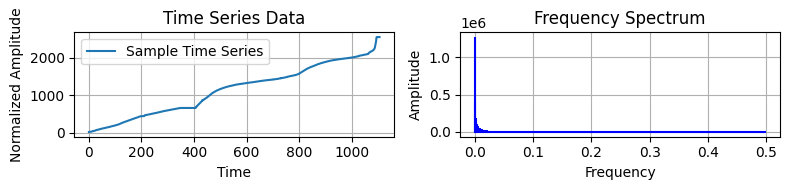

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import os


sample_x = data_rainfall_driven_K2_2B2

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_K2_2B3.pdf'))
plt.show()


The frequency spectrum plot reveals a distinct peak at a frequency around 0.15, indicating a pronounced periodic or cyclic component at that frequency. This suggests the underlying time series data contains a periodic fluctuation or oscillation with a period corresponding to the inverse of this frequency, which would be approximately 6-7 time units.

In [10]:
# plot utils.
def plot_scatter(*args, **kwargs):
    plt.plot(*args, **kwargs)
    plt.scatter(*args, **kwargs)


# simple batcher.
def data_generator(x, y, size):
    assert len(x) == len(y)
    batches = []
    for ii in range(0, len(x), size):
        batches.append((x[ii:ii + size], y[ii:ii + size]))
    for batch in batches:
        yield batch

In [11]:

random_seed = 42
torch.manual_seed(random_seed)
np.random.seed(random_seed)
random.seed(random_seed)


torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed)  # for multi-GPU setups
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138144169679008
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138144169680352
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138144169677568
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138144169684960
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138144168814736
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138144168809552


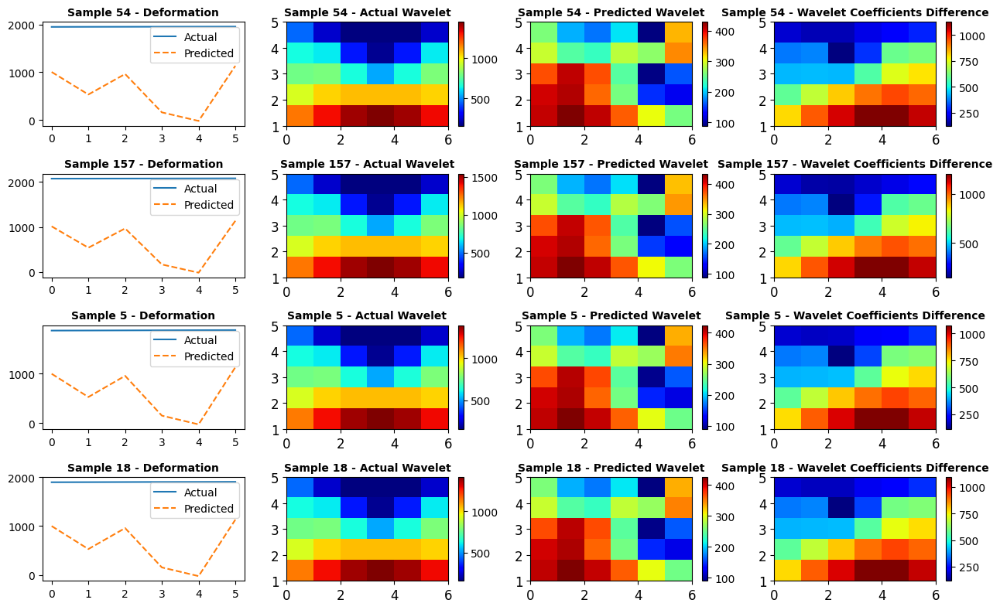

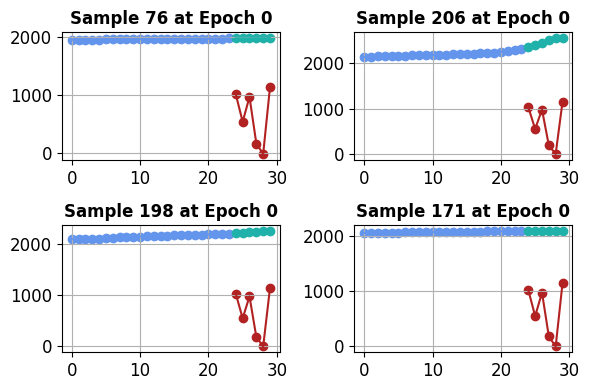

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.04384568, -0.43526718, -0.15695967,  0.01990514, -0.39359105,
        0.28836676, -0.28724682,  0.2566461 ,  0.21987826,  0.15215854,
        0.24950564, -0.09338632, -0.10971335,  0.01682503,  0.0514924 ,
       -0.28678474, -0.38992256,  0.17823927, -0.23663446,  0.37933812,
       -0.22722404,  0.24628438, -0.26386544, -0.3747886 ], dtype=float32), 'forecast': array([ 0.50000614,  0.3937956 ,  0.20826015, -0.42585188, -0.4449772 ,
        0.22814   ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.43021473, -0.29526114,  0.06472924,  0.45258135, -0.4671955 ,
       -0.19206399, -0.37526587,  0.0145859 ,  0.38338855,  0.23273592,
        0.06720176, -0.43662086,  0.5077423 ,  0.09396452, -0.45520785,
       -0.35246044,  0.32881638,  0.42875957, -0.38603988,  0.02916956,
        0.41026604,  0.36115515,  0.09730543, -0.11883949], dtype=float32), 'forecast': array([-0.0485974 , -0.29465917,  0.0

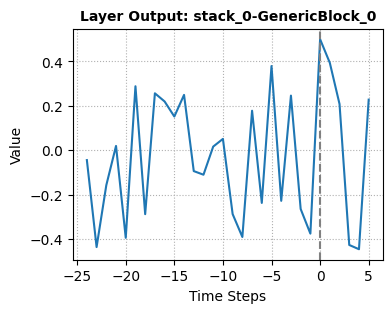

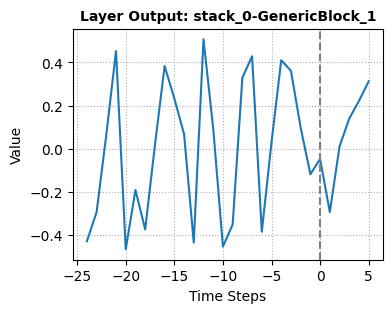

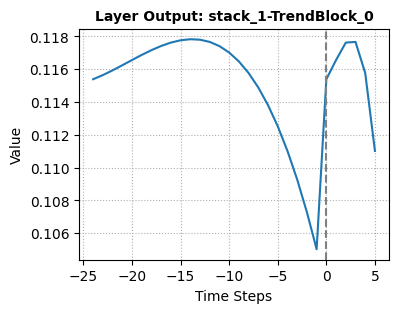

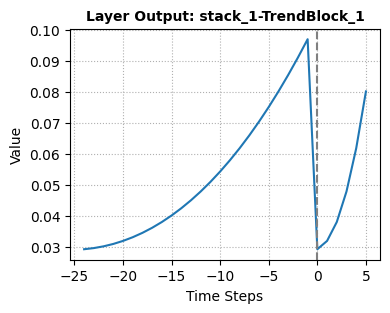

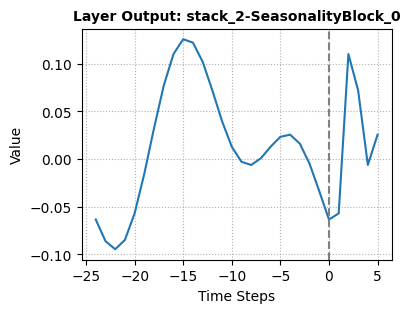

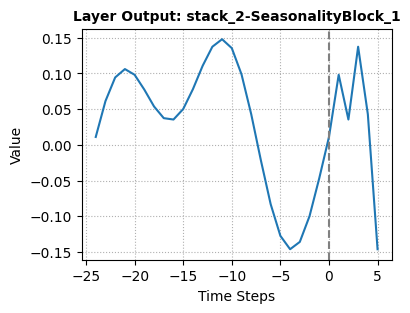

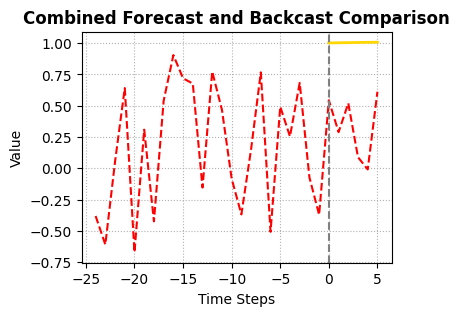

Epoch = 1, Train Loss = 0.2078, Test Loss = 0.6387
Epoch = 2, Train Loss = 0.1367, Test Loss = 0.4734
Epoch = 3, Train Loss = 0.0967, Test Loss = 0.3621
Epoch = 4, Train Loss = 0.0720, Test Loss = 0.2848
Epoch = 5, Train Loss = 0.0562, Test Loss = 0.2261
Epoch = 6, Train Loss = 0.0451, Test Loss = 0.1835
Epoch = 7, Train Loss = 0.0369, Test Loss = 0.1522
Epoch = 8, Train Loss = 0.0304, Test Loss = 0.1284
Epoch = 9, Train Loss = 0.0250, Test Loss = 0.1090
Epoch = 10, Train Loss = 0.0204, Test Loss = 0.0930
Epoch = 11, Train Loss = 0.0163, Test Loss = 0.0789
Epoch = 12, Train Loss = 0.0127, Test Loss = 0.0662
Epoch = 13, Train Loss = 0.0098, Test Loss = 0.0558
Epoch = 14, Train Loss = 0.0075, Test Loss = 0.0474
Epoch = 15, Train Loss = 0.0057, Test Loss = 0.0405
Epoch = 16, Train Loss = 0.0044, Test Loss = 0.0348
Epoch = 17, Train Loss = 0.0033, Test Loss = 0.0300
Epoch = 18, Train Loss = 0.0026, Test Loss = 0.0258
Epoch = 19, Train Loss = 0.0020, Test Loss = 0.0222
Epoch = 20, Train Los

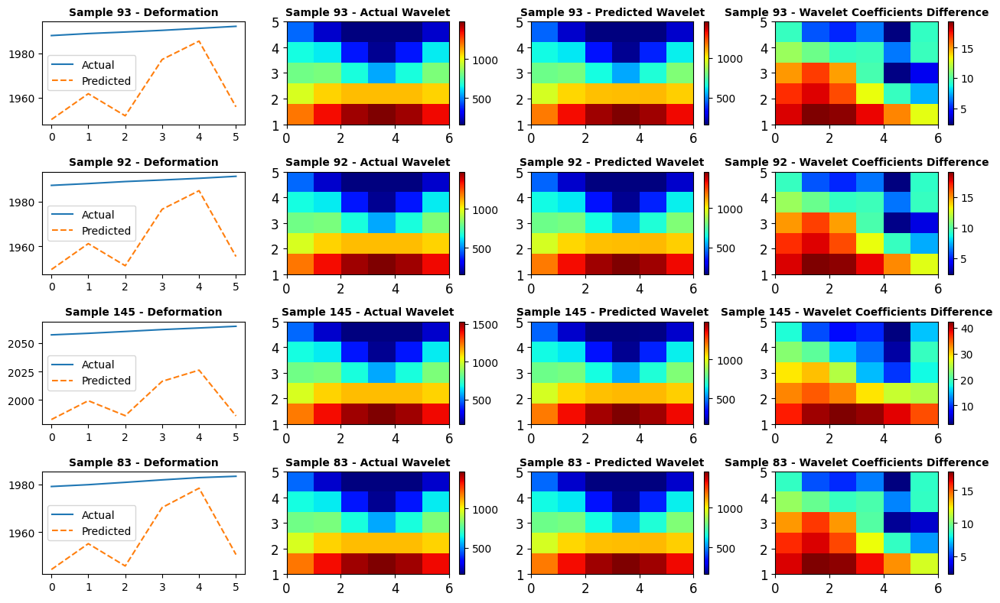

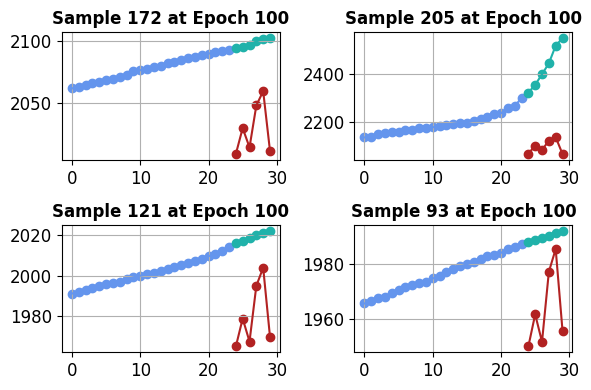

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.05315989, -0.5373779 , -0.13118808,  0.02618105, -0.23184235,
        0.07551603, -0.41317028,  0.15595388, -0.04817151, -0.00843559,
        0.28745094,  0.03526905, -0.37514684, -0.0892216 , -0.18852307,
       -0.40695435, -0.1375896 ,  0.0496681 , -0.21450621,  0.34995323,
       -0.0934769 ,  0.26292196, -0.34445858, -0.5766521 ], dtype=float32), 'forecast': array([ 0.6364605 ,  0.5034051 ,  0.2530643 , -0.23365447, -0.39387152,
        0.139928  ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.40868244, -0.34470183,  0.04145344,  0.42015198, -0.47643387,
       -0.19884785, -0.4161651 ,  0.04473825,  0.33721256,  0.2118277 ,
        0.03120463, -0.45223236,  0.5249802 ,  0.06703417, -0.4355496 ,
       -0.35443082,  0.3482808 ,  0.4179932 , -0.3794514 , -0.00065966,
        0.41455558,  0.38347876,  0.10244111, -0.14610069], dtype=float32), 'forecast': array([-0.03292394, -0.26465023,  0.0

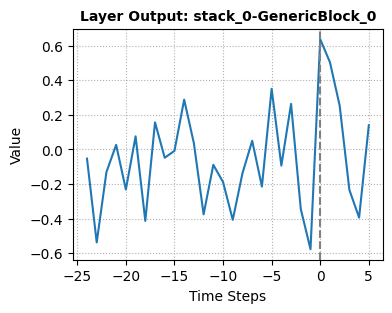

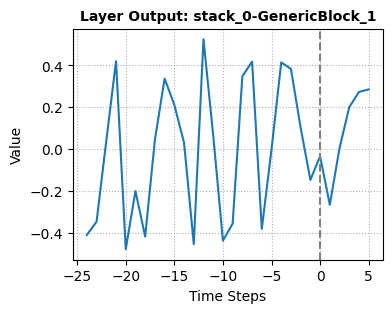

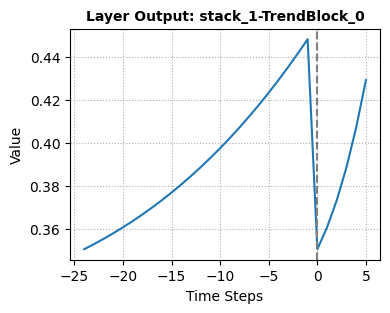

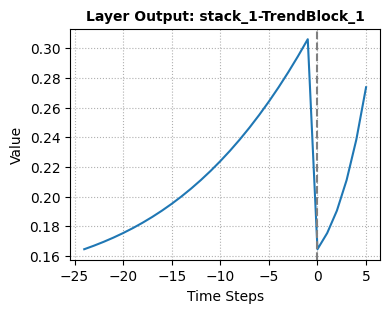

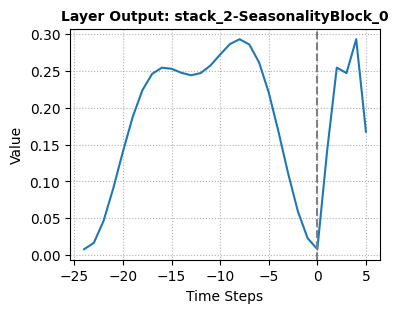

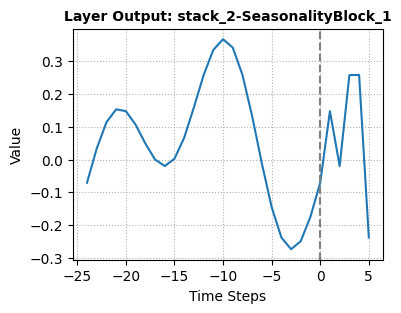

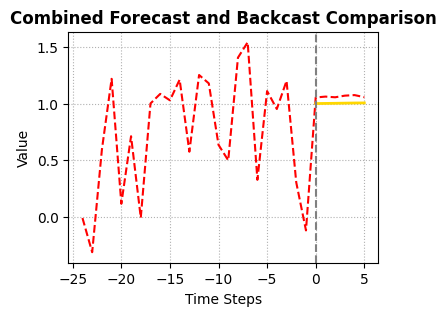

Epoch = 101, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 102, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 103, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 104, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 105, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 106, Train Loss = 0.0002, Test Loss = 0.0038
Epoch = 107, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 108, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 109, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 110, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 111, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 112, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 113, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 114, Train Loss = 0.0002, Test Loss = 0.0037
Epoch = 115, Train Loss = 0.0002, Test Loss = 0.0036
Epoch = 116, Train Loss = 0.0002, Test Loss = 0.0036
Epoch = 117, Train Loss = 0.0002, Test Loss = 0.0036
Epoch = 118, Train Loss = 0.0002, Test Loss = 0.0036
Epoch = 119, Train Loss = 0.0002, Test Loss = 

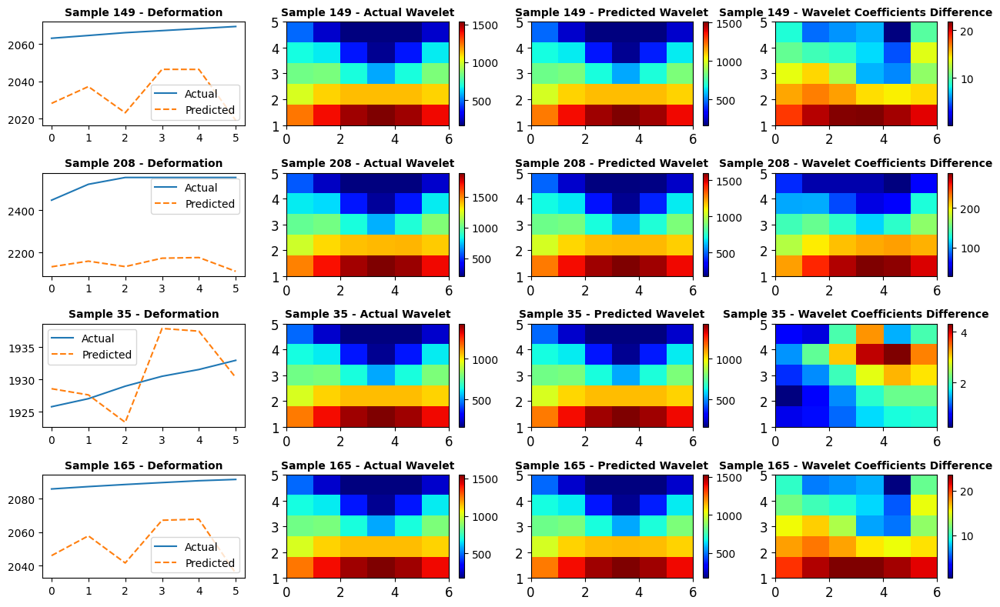

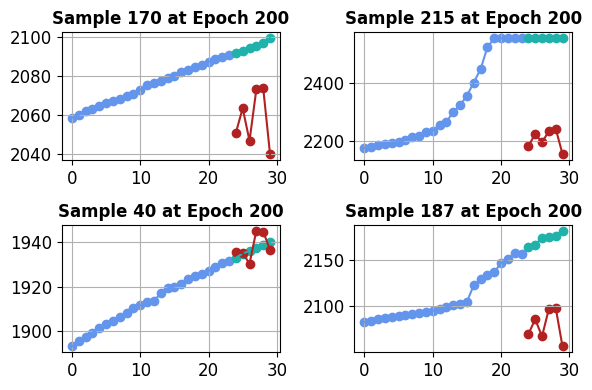

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.06127581, -0.53790814, -0.1248059 ,  0.02525368, -0.240075  ,
        0.07403413, -0.40555027,  0.1569615 , -0.0458164 , -0.0069359 ,
        0.28063068,  0.03057927, -0.37650868, -0.08764316, -0.18340662,
       -0.40549877, -0.13687722,  0.04214777, -0.20739868,  0.34473515,
       -0.09873851,  0.25601384, -0.3390982 , -0.57522833], dtype=float32), 'forecast': array([ 0.63501716,  0.50571334,  0.25949103, -0.23284452, -0.39535108,
        0.13965164], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-4.0740815e-01, -3.4379780e-01,  4.2774897e-02,  4.2098278e-01,
       -4.7441068e-01, -2.0002243e-01, -4.1734195e-01,  4.2934779e-02,
        3.3550373e-01,  2.0918490e-01,  3.0868504e-02, -4.5470425e-01,
        5.2092946e-01,  6.6146754e-02, -4.3535563e-01, -3.5405439e-01,
        3.4533879e-01,  4.1362140e-01, -3.8023007e-01, -1.6848695e-04,
        4.1764569e-01,  3.8044173e-01,  1.0055999e-01, -1.

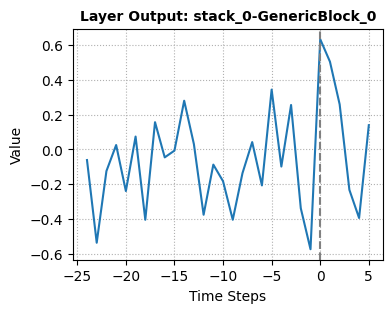

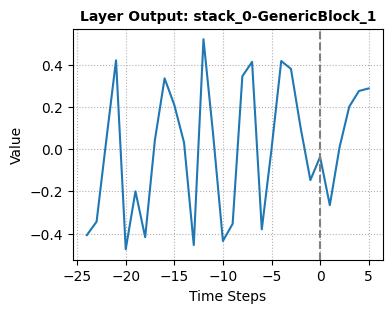

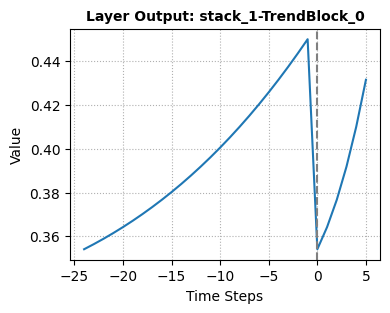

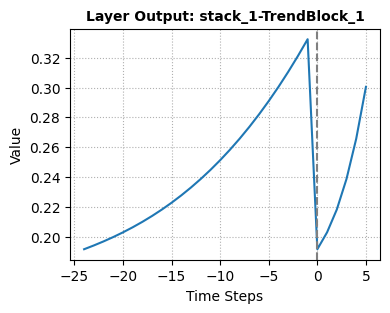

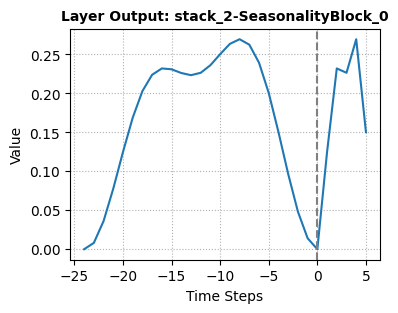

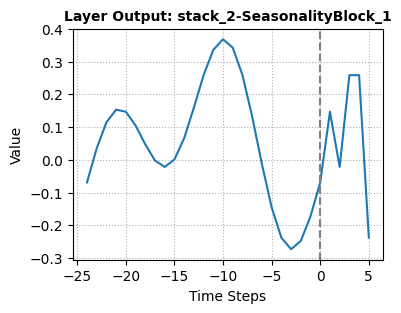

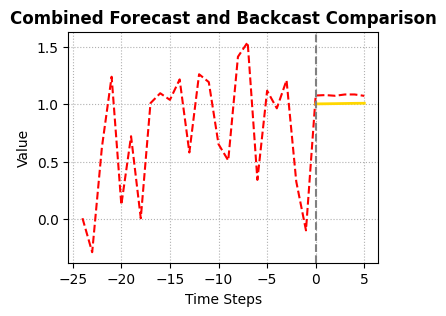

Epoch = 201, Train Loss = 0.0001, Test Loss = 0.0027
Epoch = 202, Train Loss = 0.0001, Test Loss = 0.0027
Epoch = 203, Train Loss = 0.0001, Test Loss = 0.0027
Epoch = 204, Train Loss = 0.0001, Test Loss = 0.0027
Epoch = 205, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 206, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 207, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 208, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 209, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 210, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 211, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 212, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 213, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 214, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 215, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 216, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 217, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 218, Train Loss = 0.0001, Test Loss = 0.0026
Epoch = 219, Train Loss = 0.0001, Test Loss = 

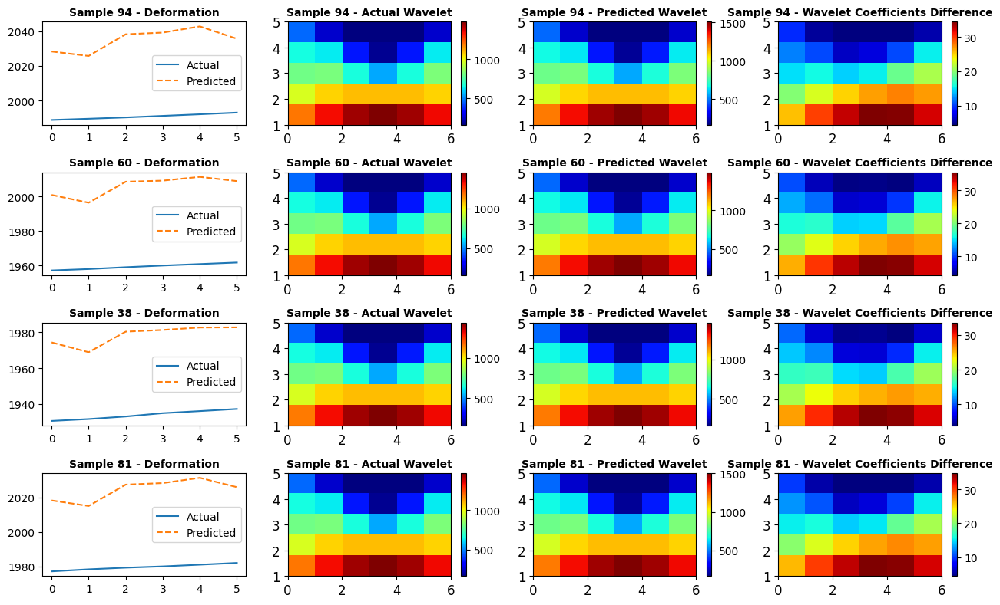

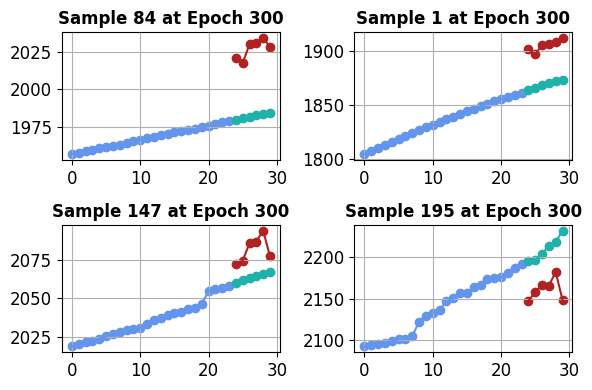

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.07592437, -0.5369277 , -0.11137594,  0.02374603, -0.27626947,
        0.09267019, -0.35648286,  0.18043841, -0.00947231,  0.01394065,
        0.25823197,  0.01139268, -0.34119096, -0.06921732, -0.14077021,
       -0.38813552, -0.15054248,  0.03666038, -0.19390787,  0.33264506,
       -0.12949513,  0.23916979, -0.3167088 , -0.5515225 ], dtype=float32), 'forecast': array([ 0.6291613 ,  0.49624655,  0.26619533, -0.24881963, -0.39569023,
        0.14167525], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.40902707, -0.33809713,  0.06137017,  0.43137488, -0.4730705 ,
       -0.2041799 , -0.41091847,  0.03660808,  0.34625244,  0.20992082,
        0.04423179, -0.45508716,  0.51466095,  0.07392465, -0.44169775,
       -0.361034  ,  0.3469411 ,  0.41299853, -0.37144005,  0.00757109,
        0.41464195,  0.3654122 ,  0.08838432, -0.14068632], dtype=float32), 'forecast': array([-0.04805993, -0.26804668, -0.0

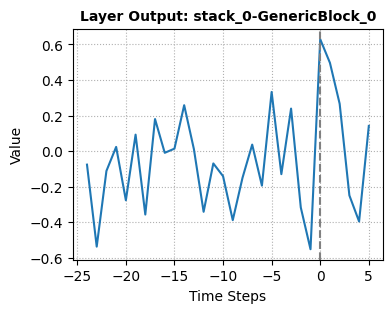

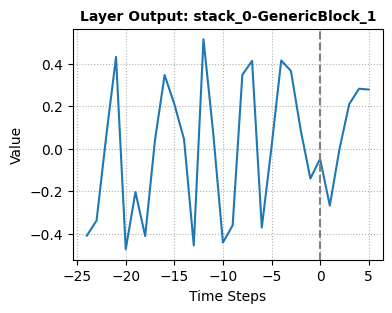

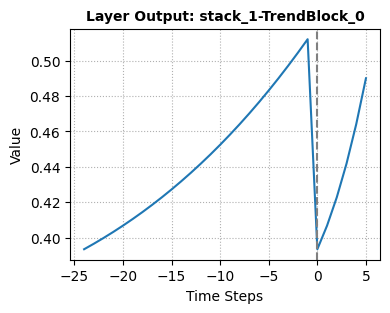

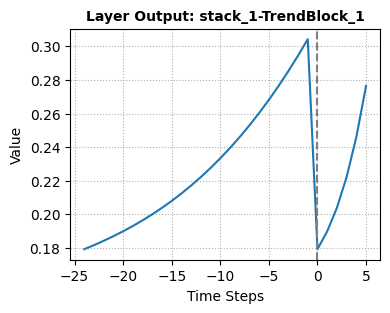

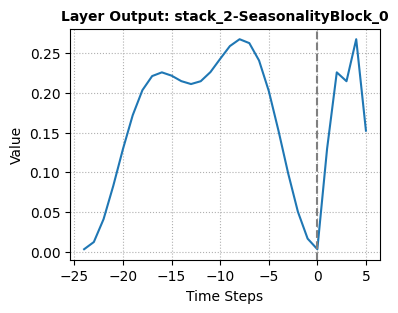

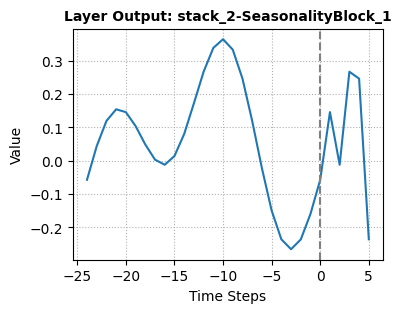

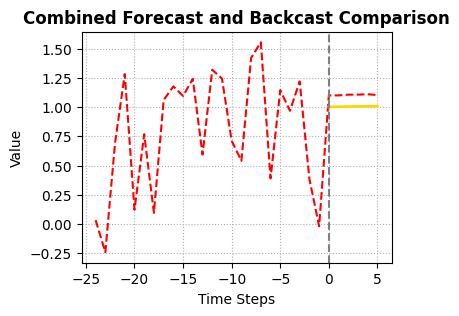

Epoch = 301, Train Loss = 0.0008, Test Loss = 0.0018
Epoch = 302, Train Loss = 0.0006, Test Loss = 0.0019
Epoch = 303, Train Loss = 0.0003, Test Loss = 0.0020
Epoch = 304, Train Loss = 0.0005, Test Loss = 0.0022
Epoch = 305, Train Loss = 0.0003, Test Loss = 0.0023
Epoch = 306, Train Loss = 0.0002, Test Loss = 0.0021
Epoch = 307, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 308, Train Loss = 0.0003, Test Loss = 0.0020
Epoch = 309, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 310, Train Loss = 0.0001, Test Loss = 0.0022
Epoch = 311, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 312, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 313, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 314, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 315, Train Loss = 0.0001, Test Loss = 0.0022
Epoch = 316, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 317, Train Loss = 0.0001, Test Loss = 0.0024
Epoch = 318, Train Loss = 0.0001, Test Loss = 0.0024
Epoch = 319, Train Loss = 0.0001, Test Loss = 

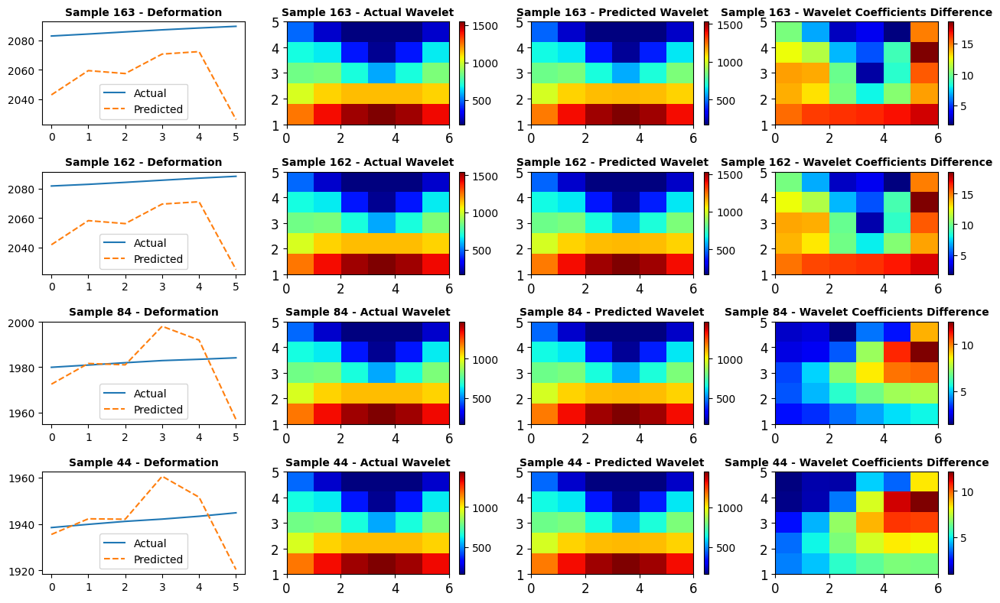

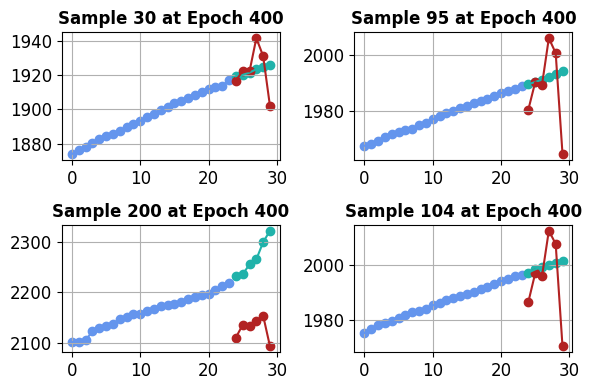

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.07858734, -0.52250224, -0.10436268,  0.02414727, -0.28627267,
        0.10844852, -0.34319535,  0.18919386,  0.00825973,  0.02648567,
        0.2525156 ,  0.0034653 , -0.32399467, -0.05687086, -0.12109963,
       -0.3748919 , -0.16464178,  0.03902216, -0.18307492,  0.32957512,
       -0.13939025,  0.2331748 , -0.30276674, -0.5336823 ], dtype=float32), 'forecast': array([ 0.62042624,  0.4935827 ,  0.27007008, -0.254305  , -0.39693677,
        0.13951145], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.39973748, -0.32797378,  0.0504712 ,  0.4297516 , -0.46212235,
       -0.19774805, -0.40975586,  0.03525439,  0.3363661 ,  0.20854546,
        0.03930388, -0.45204085,  0.5084479 ,  0.07616858, -0.43886608,
       -0.3493873 ,  0.34444633,  0.40131208, -0.37730145,  0.00485822,
        0.42467424,  0.37196293,  0.09263352, -0.1417941 ], dtype=float32), 'forecast': array([-0.05429276, -0.26726186, -0.0

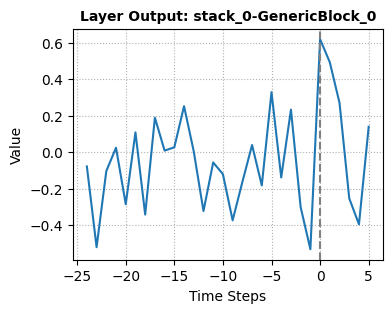

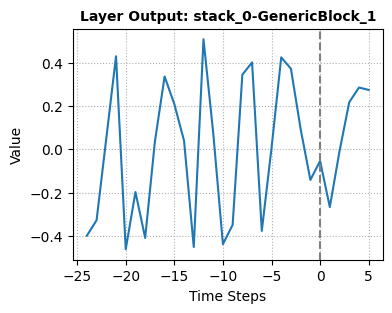

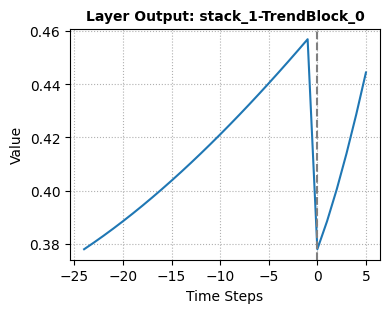

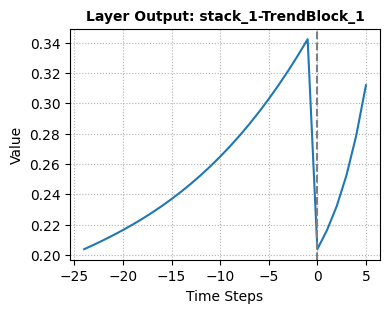

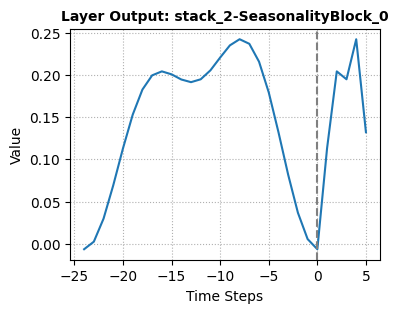

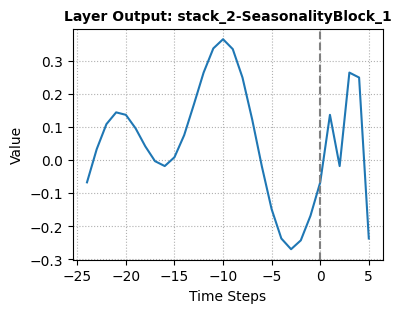

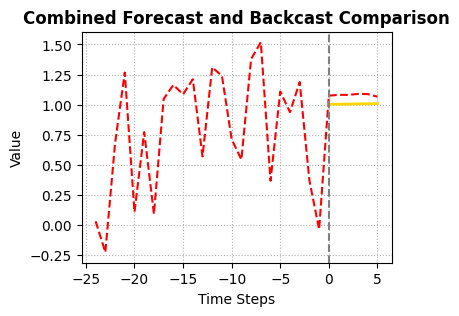

Epoch = 401, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 402, Train Loss = 0.0002, Test Loss = 0.0026
Epoch = 403, Train Loss = 0.0002, Test Loss = 0.0028
Epoch = 404, Train Loss = 0.0001, Test Loss = 0.0022
Epoch = 405, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 406, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 407, Train Loss = 0.0001, Test Loss = 0.0020
Epoch = 408, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 409, Train Loss = 0.0002, Test Loss = 0.0026
Epoch = 410, Train Loss = 0.0002, Test Loss = 0.0027
Epoch = 411, Train Loss = 0.0001, Test Loss = 0.0022
Epoch = 412, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 413, Train Loss = 0.0002, Test Loss = 0.0018
Epoch = 414, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 415, Train Loss = 0.0001, Test Loss = 0.0023
Epoch = 416, Train Loss = 0.0002, Test Loss = 0.0026
Epoch = 417, Train Loss = 0.0001, Test Loss = 0.0027
Epoch = 418, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 419, Train Loss = 0.0001, Test Loss = 

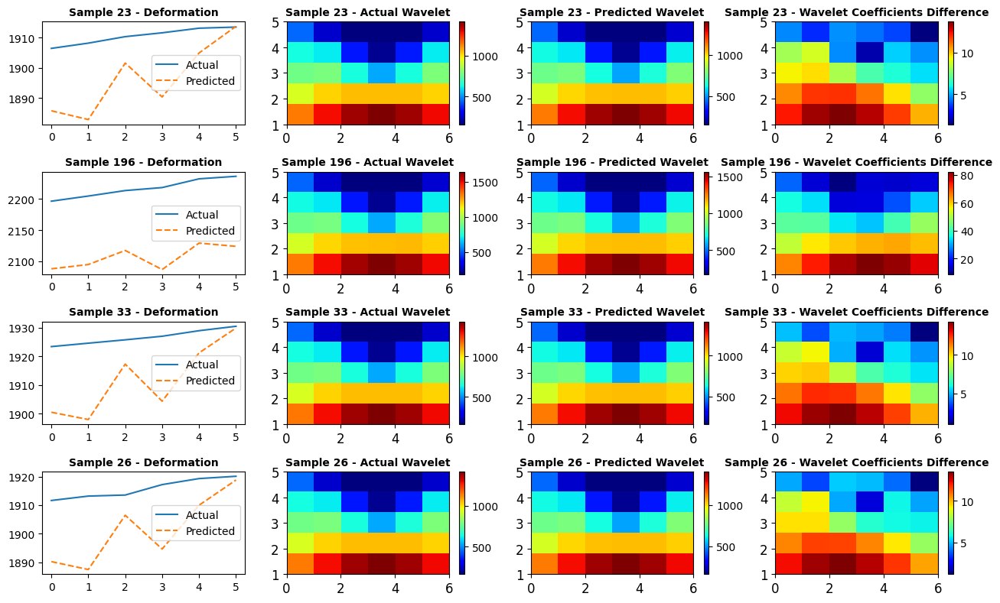

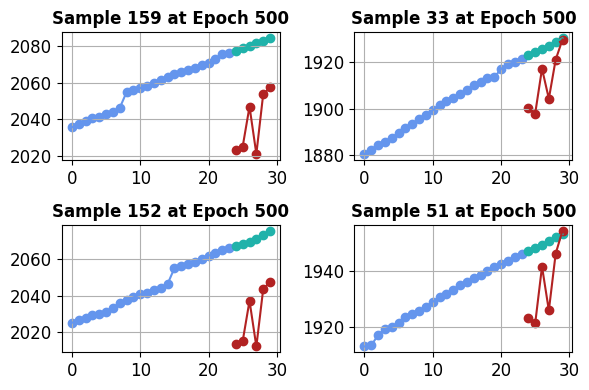

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.06977811, -0.49229953, -0.10365408,  0.02428744, -0.30759087,
        0.15305519, -0.31796405,  0.2122414 ,  0.05941589,  0.05872699,
        0.24632598, -0.01745889, -0.2753519 , -0.03184239, -0.07437032,
       -0.3510711 , -0.20837572,  0.06584174, -0.18057273,  0.3360862 ,
       -0.16290742,  0.23164532, -0.28693244, -0.4922119 ], dtype=float32), 'forecast': array([ 0.58594376,  0.46849605,  0.2616681 , -0.27759922, -0.39936087,
        0.13899037], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.3925794 , -0.3151281 ,  0.04609409,  0.43186405, -0.44872138,
       -0.19426058, -0.40704763,  0.0280305 ,  0.33087078,  0.20772503,
        0.03857948, -0.448692  ,  0.4973559 ,  0.08225301, -0.4400622 ,
       -0.34221134,  0.34243235,  0.38982216, -0.37975478,  0.00522674,
        0.431536  ,  0.37119567,  0.09109493, -0.14096175], dtype=float32), 'forecast': array([-0.06492463, -0.2707779 , -0.0

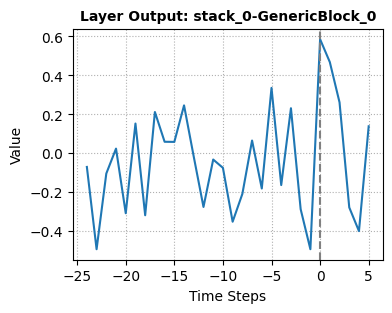

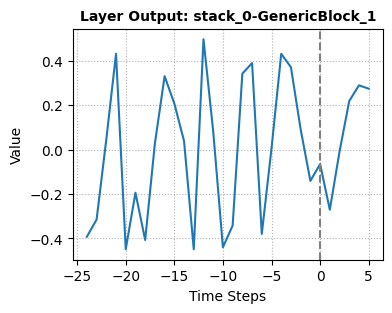

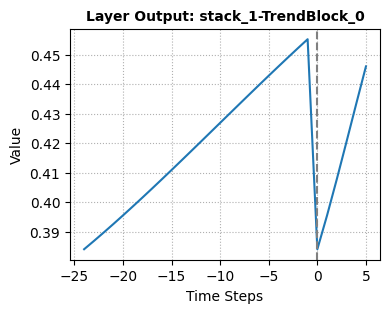

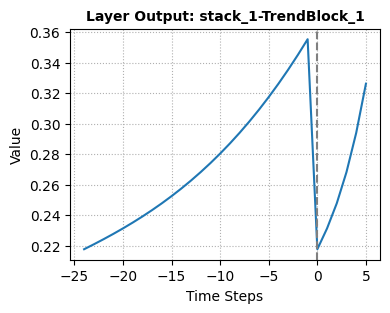

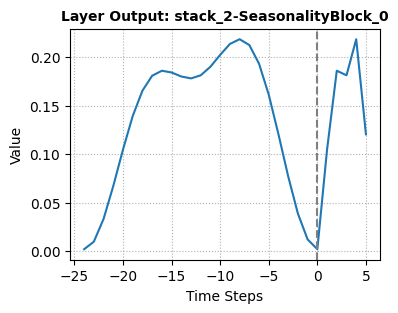

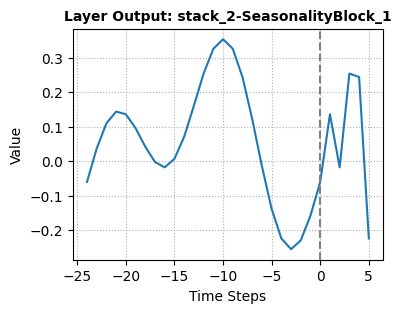

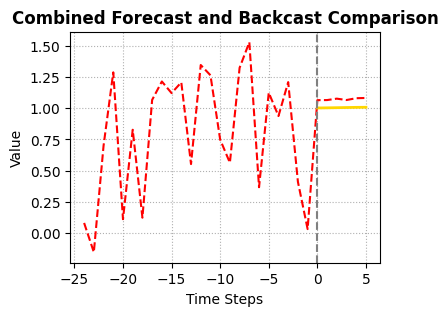

Epoch = 501, Train Loss = 0.0002, Test Loss = 0.0025
Epoch = 502, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 503, Train Loss = 0.0002, Test Loss = 0.0017
Epoch = 504, Train Loss = 0.0002, Test Loss = 0.0016
Epoch = 505, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 506, Train Loss = 0.0002, Test Loss = 0.0022
Epoch = 507, Train Loss = 0.0002, Test Loss = 0.0024
Epoch = 508, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 509, Train Loss = 0.0002, Test Loss = 0.0016
Epoch = 510, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 511, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 512, Train Loss = 0.0002, Test Loss = 0.0022
Epoch = 513, Train Loss = 0.0002, Test Loss = 0.0023
Epoch = 514, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 515, Train Loss = 0.0002, Test Loss = 0.0016
Epoch = 516, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 517, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 518, Train Loss = 0.0002, Test Loss = 0.0023
Epoch = 519, Train Loss = 0.0001, Test Loss = 

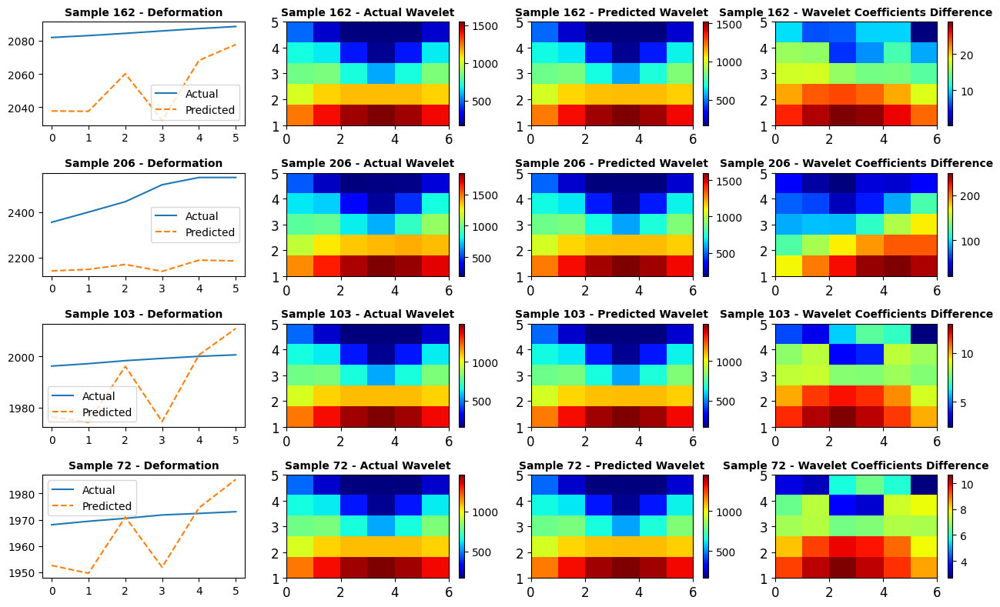

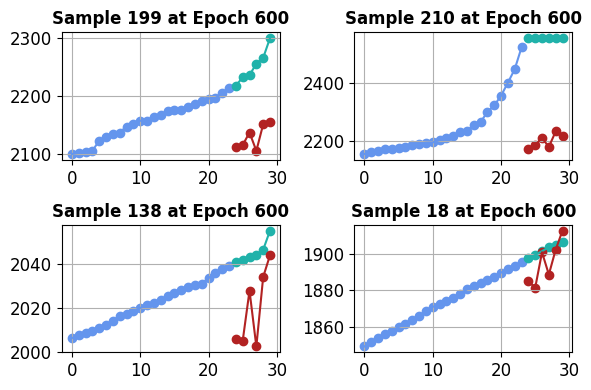

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.06315177, -0.4730332 , -0.1021154 ,  0.02441535, -0.31613258,
        0.1749483 , -0.30548745,  0.22273193,  0.08213638,  0.07313447,
        0.24108757, -0.02735757, -0.25511318, -0.01964913, -0.05325568,
       -0.33867666, -0.22674662,  0.07738528, -0.17787191,  0.3377731 ,
       -0.17487492,  0.22982275, -0.27857995, -0.47160342], dtype=float32), 'forecast': array([ 0.57364464,  0.45711148,  0.25463244, -0.2924561 , -0.39961612,
        0.14071089], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.3838589 , -0.30605084,  0.03860576,  0.43222255, -0.43489766,
       -0.19254825, -0.4090836 ,  0.01929711,  0.3211312 ,  0.2032428 ,
        0.03448329, -0.44886017,  0.4858546 ,  0.08654954, -0.43971336,
       -0.33283105,  0.33902222,  0.37421295, -0.38359872,  0.00351353,
        0.4393126 ,  0.36916578,  0.08927726, -0.14234592], dtype=float32), 'forecast': array([-0.07055376, -0.27134117, -0.0

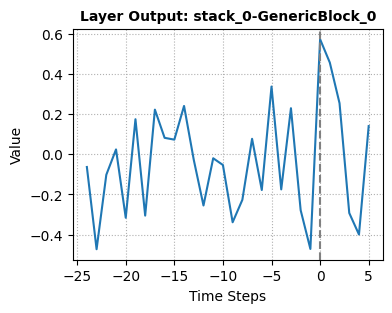

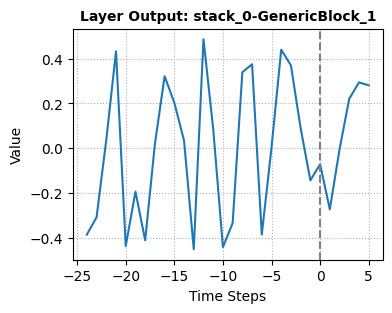

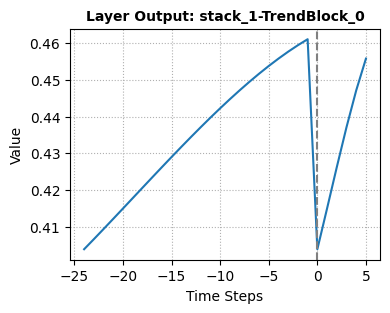

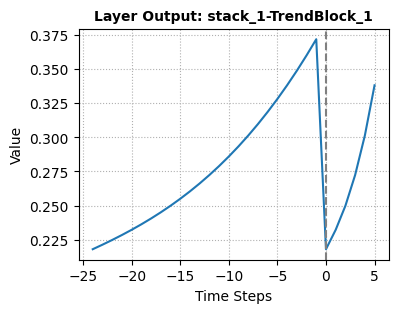

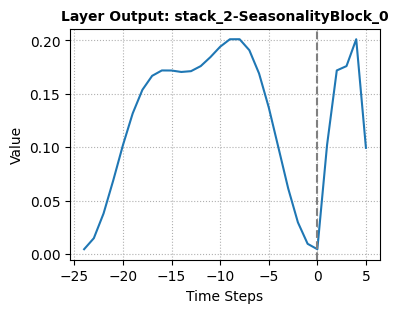

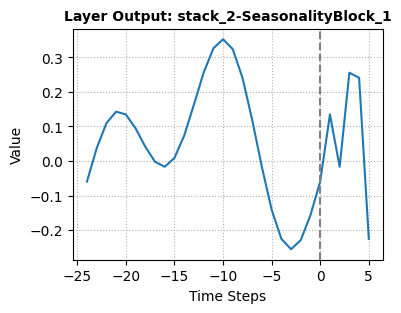

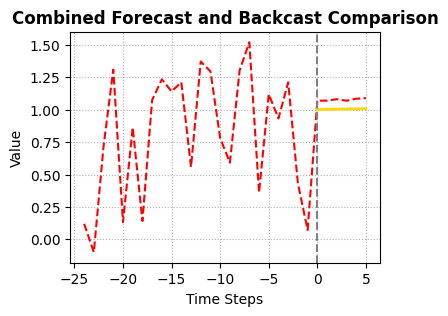

Epoch = 601, Train Loss = 0.0001, Test Loss = 0.0022
Epoch = 602, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 603, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 604, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 605, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 606, Train Loss = 0.0002, Test Loss = 0.0022
Epoch = 607, Train Loss = 0.0001, Test Loss = 0.0020
Epoch = 608, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 609, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 610, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 611, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 612, Train Loss = 0.0002, Test Loss = 0.0022
Epoch = 613, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 614, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 615, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 616, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 617, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 618, Train Loss = 0.0002, Test Loss = 0.0023
Epoch = 619, Train Loss = 0.0001, Test Loss = 

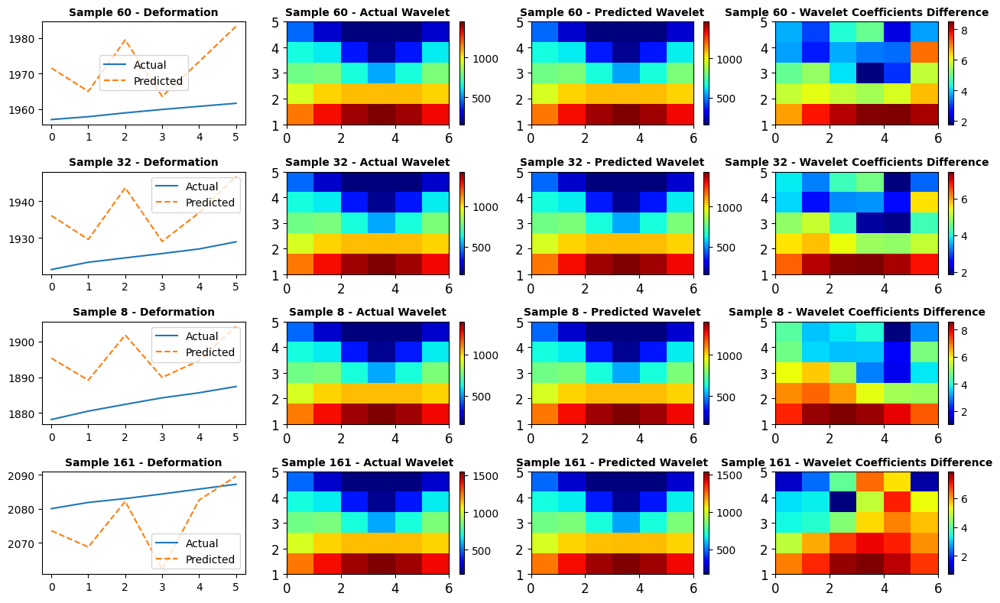

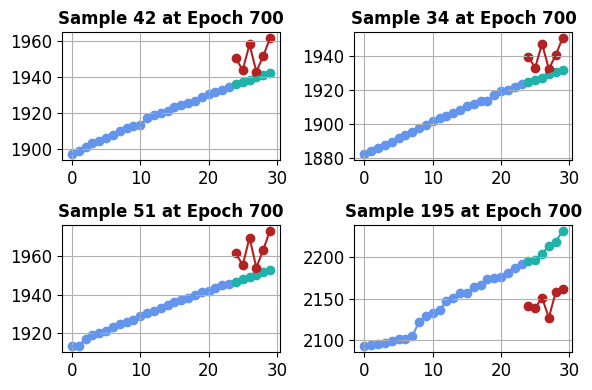

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.0553412 , -0.4568292 , -0.10224728,  0.02427454, -0.31796625,
        0.19299419, -0.29772153,  0.22907059,  0.09758551,  0.08277284,
        0.23730673, -0.03337867, -0.24161726, -0.01167032, -0.0396077 ,
       -0.3300136 , -0.24059284,  0.087589  , -0.17771597,  0.33988956,
       -0.18300724,  0.2295121 , -0.27425313, -0.45663092], dtype=float32), 'forecast': array([ 0.56422055,  0.4478766 ,  0.25152284, -0.30799767, -0.40054202,
        0.14380907], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.37861925, -0.300122  ,  0.03721203,  0.43334088, -0.4232048 ,
       -0.19210675, -0.41102493,  0.01110193,  0.31597286,  0.19896002,
        0.03262606, -0.44825518,  0.47856653,  0.08937829, -0.43935323,
       -0.32799795,  0.33576426,  0.36459306, -0.38425598,  0.00311515,
        0.44369775,  0.36396655,  0.08679362, -0.14182857], dtype=float32), 'forecast': array([-0.07402433, -0.26987842, -0.0

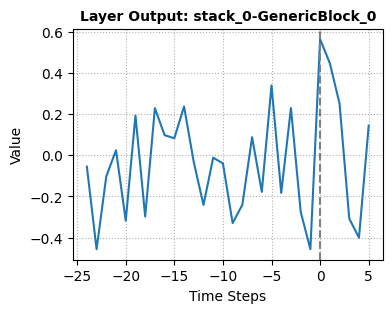

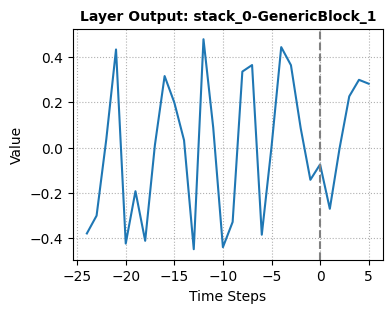

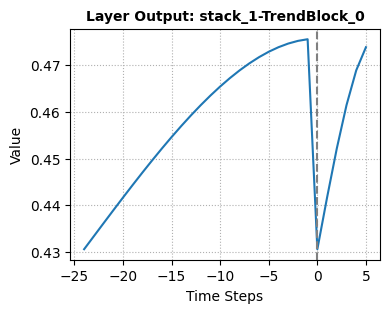

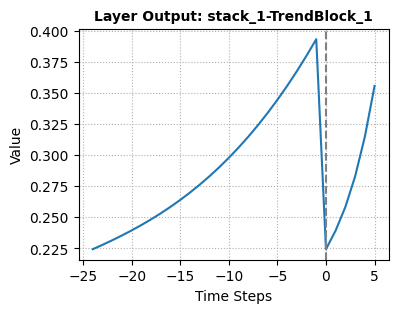

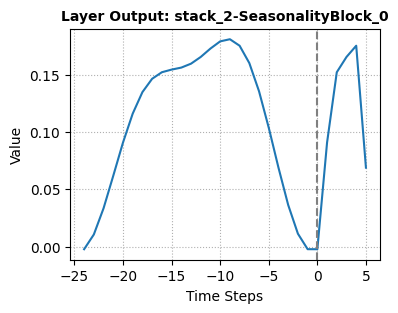

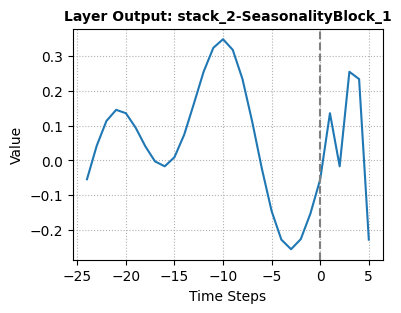

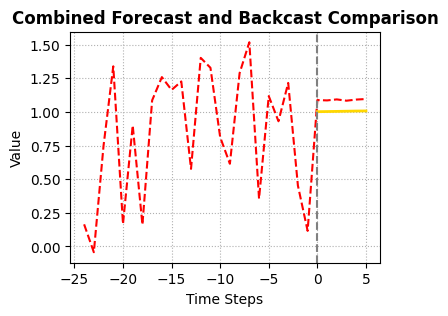

Epoch = 701, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 702, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 703, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 704, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 705, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 706, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 707, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 708, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 709, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 710, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 711, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 712, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 713, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 714, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 715, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 716, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 717, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 718, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 719, Train Loss = 0.0001, Test Loss = 

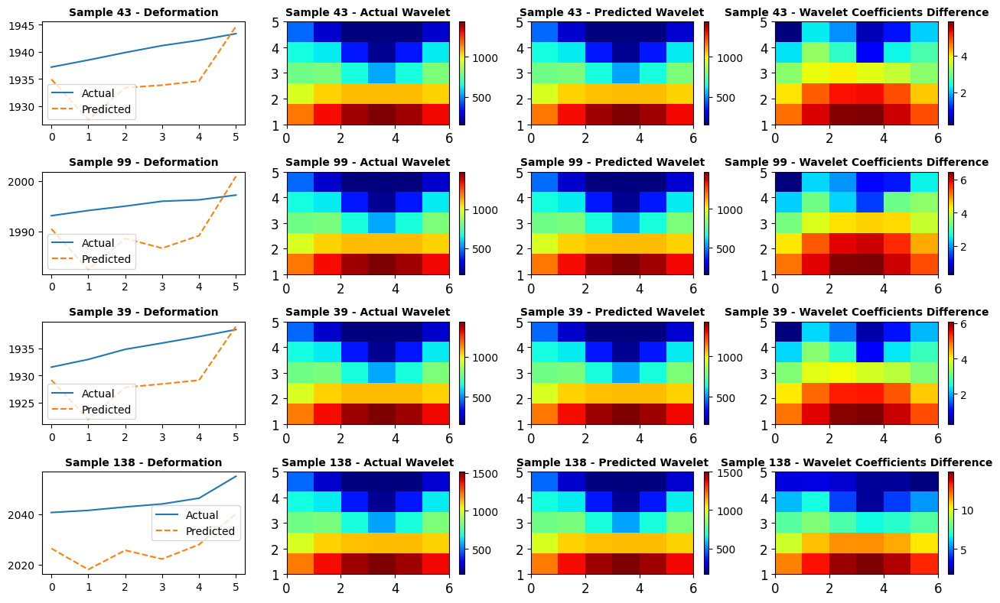

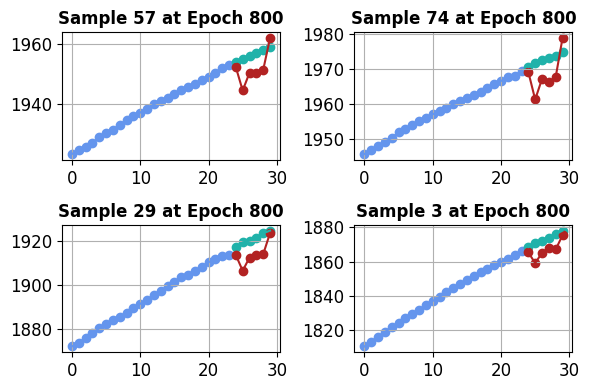

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.04306382, -0.43776852, -0.10375681,  0.02444713, -0.31877962,
        0.21414919, -0.2878338 ,  0.23670195,  0.11471084,  0.09318751,
        0.23217799, -0.04185463, -0.22615632, -0.00275612, -0.02552298,
       -0.32036898, -0.25433686,  0.09979993, -0.17950092,  0.34175947,
       -0.19267671,  0.23010987, -0.26971695, -0.44030645], dtype=float32), 'forecast': array([ 0.5518382 ,  0.43888956,  0.24427395, -0.32164478, -0.40247765,
        0.14784972], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.37012807, -0.29449543,  0.03334019,  0.43411282, -0.40937307,
       -0.19022122, -0.41355217,  0.00335885,  0.30961347,  0.19302319,
        0.02908345, -0.44784343,  0.47198066,  0.09307121, -0.4375318 ,
       -0.32069188,  0.3343716 ,  0.35463887, -0.38378277,  0.00129112,
        0.44676325,  0.35963494,  0.0851539 , -0.141567  ], dtype=float32), 'forecast': array([-0.07551159, -0.267935  , -0.0

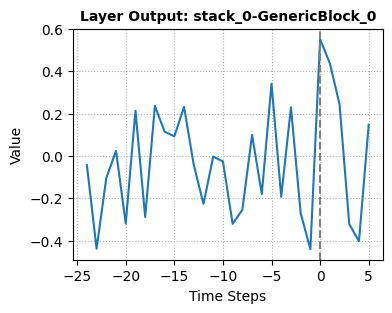

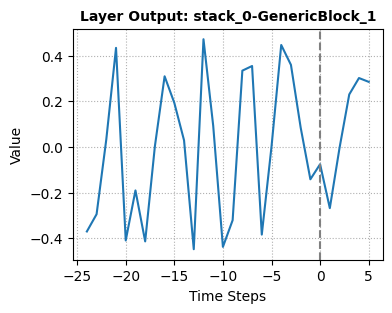

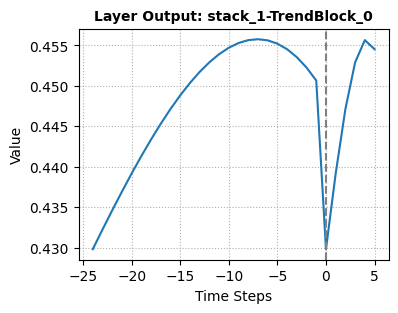

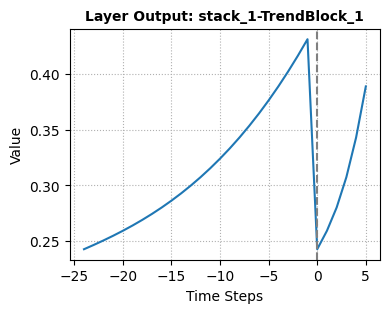

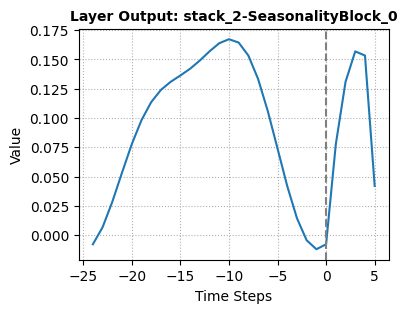

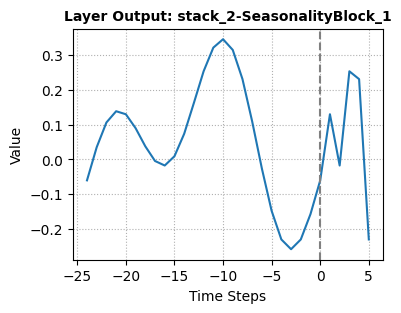

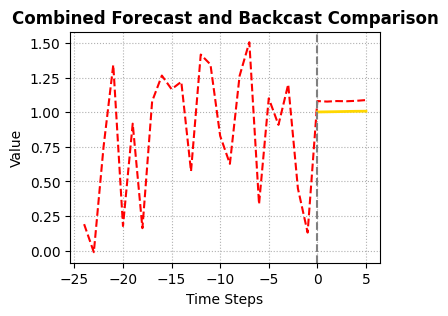

Epoch = 801, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 802, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 803, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 804, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 805, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 806, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 807, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 808, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 809, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 810, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 811, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 812, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 813, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 814, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 815, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 816, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 817, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 818, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 819, Train Loss = 0.0001, Test Loss = 

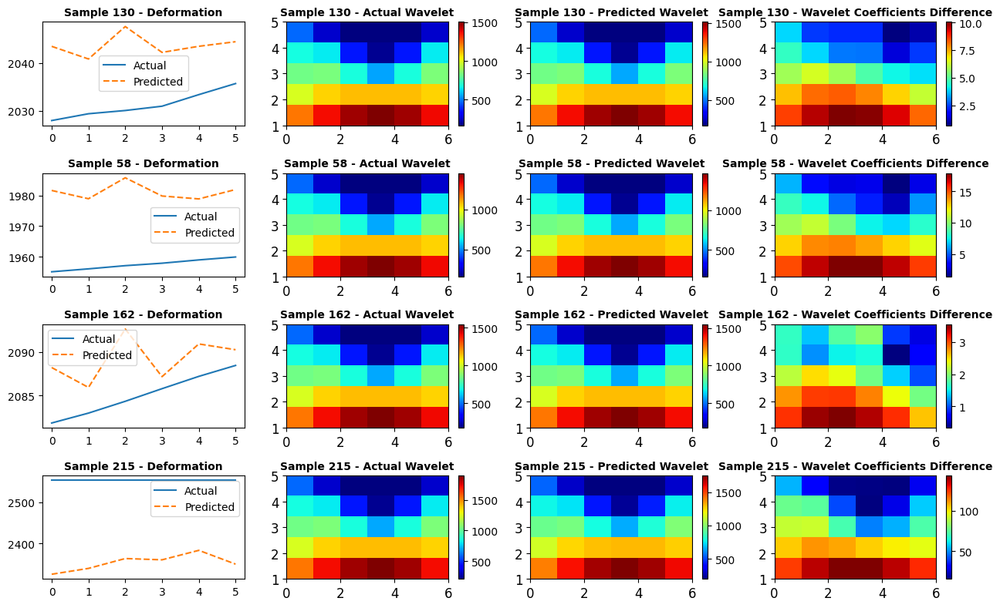

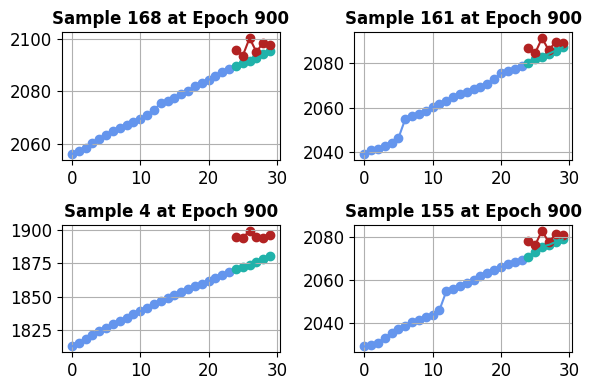

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.03881463, -0.4269219 , -0.10297886,  0.02352427, -0.3225838 ,
        0.22942229, -0.2785191 ,  0.24011078,  0.12864965,  0.10237943,
        0.22771537, -0.04756457, -0.21280912,  0.00433442, -0.01184146,
       -0.313521  , -0.26625606,  0.10613186, -0.1786075 ,  0.3424935 ,
       -0.20184414,  0.22793566, -0.26555124, -0.4282831 ], dtype=float32), 'forecast': array([ 0.5432014 ,  0.43479294,  0.2474366 , -0.33355102, -0.40564767,
        0.15295504], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.36636218, -0.28992194,  0.03256129,  0.43445963, -0.4005186 ,
       -0.1888262 , -0.41440198, -0.00618584,  0.30677435,  0.19030797,
        0.02692274, -0.44620818,  0.46633658,  0.09552005, -0.43794632,
       -0.31855083,  0.33293855,  0.34942886, -0.38282797,  0.0007978 ,
        0.44670132,  0.3548865 ,  0.08281623, -0.14116745], dtype=float32), 'forecast': array([-0.07647933, -0.26652476, -0.0

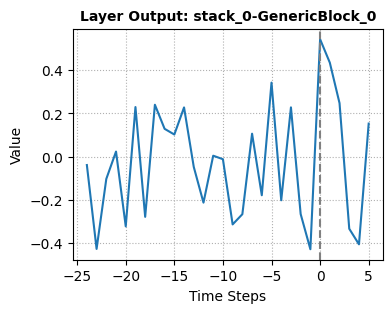

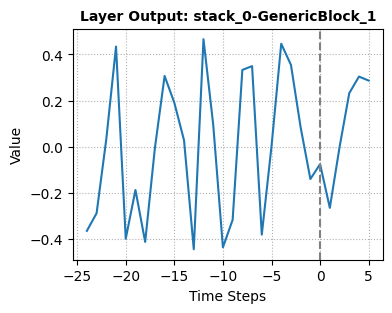

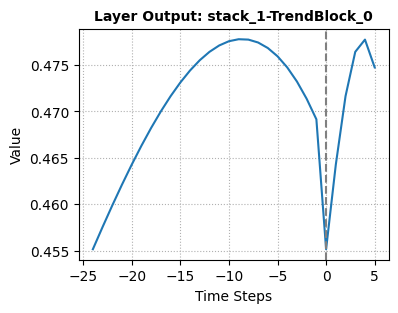

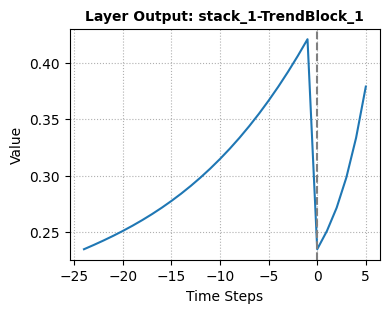

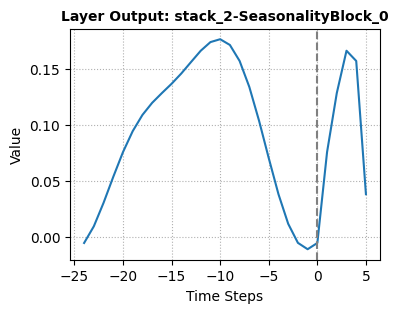

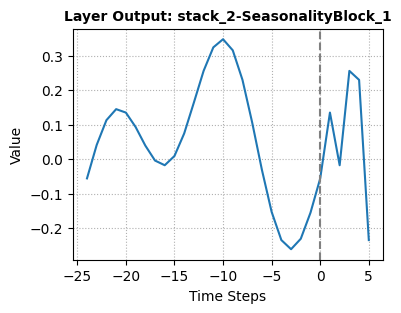

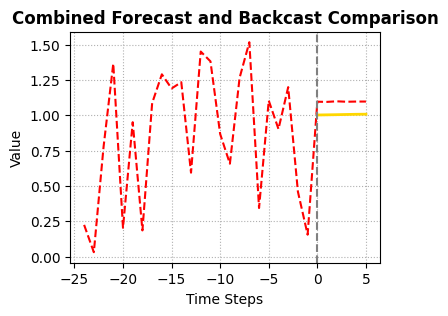

Epoch = 901, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 902, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 903, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 904, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 905, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 906, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 907, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 908, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 909, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 910, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 911, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 912, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 913, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 914, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 915, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 916, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 917, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 918, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 919, Train Loss = 0.0001, Test Loss = 

In [15]:
save_dir = 'plots_K2_2B3'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

In the outputs extracted from the STEN, we observe interesting phenomena: The wavelet analysis demonstrates remarkable consistency in detecting periodic patterns, independent of the congruence between observed and predicted values. This consistency suggests that the model effectively captures and replicates the underlying cyclical patterns inherent in the ground deformation. The uniform detection of these patterns across various data representations, irrespective of the precision in point predictions, leads us to posit that this could represent the model's perception of the core temporal structures.


# Neural Network-Based Feature Extraction for Deformation Observations in the Site K3_2B3

In [16]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_24h_climate.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [17]:
data_rainfall_driven_K3_2B3 = data[data.Station_id=='K3_2B3'][['Horizontaldisplacement(mm)']]
data_rainfall_driven_K3_2B3

,Horizontaldisplacement(mm)
date,
2019-06-21,147.83900
2019-06-22,147.60900
2019-06-23,148.56500
2019-06-24,147.55400
2019-06-25,148.13700
...,...
2022-07-28,4782.37206
2022-07-29,4782.37206
2022-07-30,4782.37206


In [19]:
forecast_length = 6
backcast_length = 4 * forecast_length
batch_size = 32  # greater than 4 for viz

data_rainfall_driven_K3_2B3 = data_rainfall_driven_K3_2B3.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_rainfall_driven_K3_2B3) - forecast_length):
    x.append(data_rainfall_driven_K3_2B3[epoch - backcast_length:epoch])
    y.append(data_rainfall_driven_K3_2B3[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

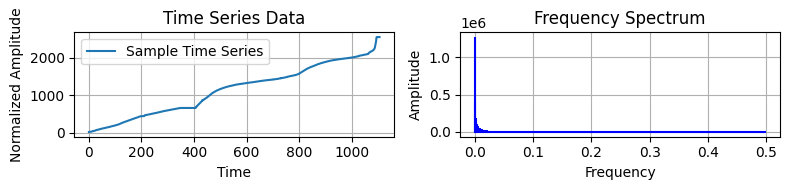

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import os


sample_x = data_rainfall_driven_K2_2B2

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_K3_2B3.pdf'))
plt.show()


| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138143714870320
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138143714882896
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138143714872192
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138143714875360
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138143714876080
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138143714876032


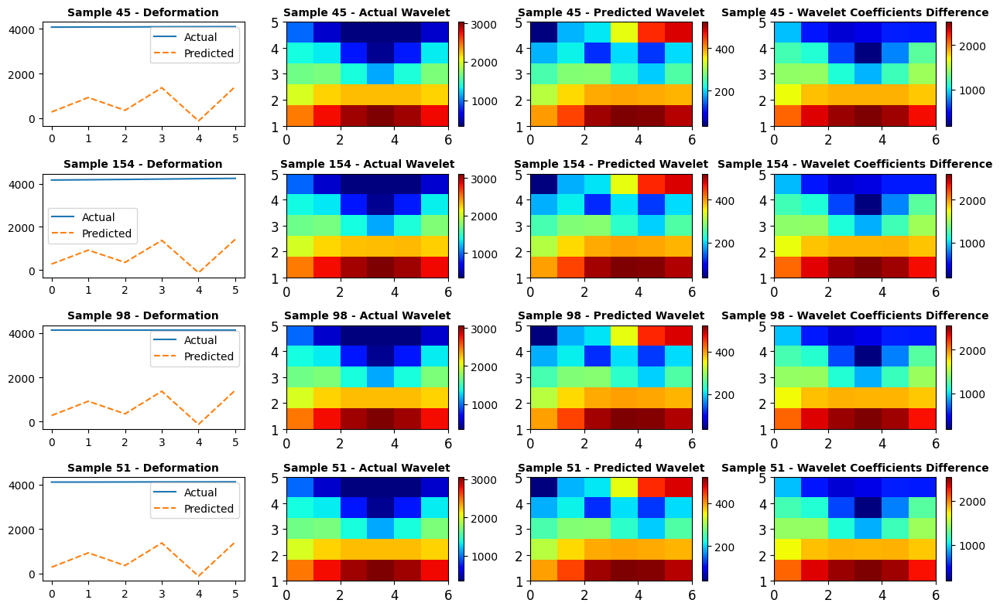

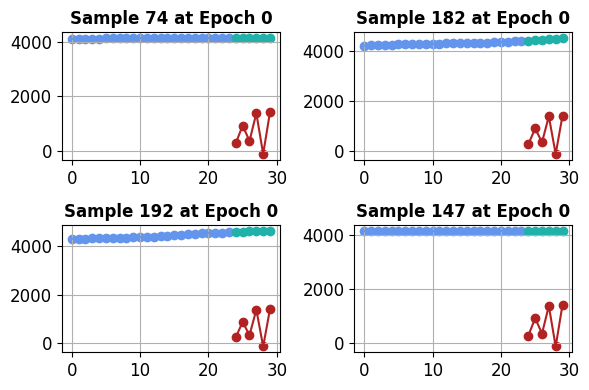

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.36818483, -0.07026122,  0.01679272,  0.4301273 , -0.4421201 ,
       -0.44876224,  0.11643196, -0.22273402,  0.09240283, -0.45908123,
        0.27611908, -0.23236094, -0.05070366, -0.29623315,  0.20073707,
       -0.48490322,  0.06709953,  0.40937424,  0.48863375, -0.17940103,
        0.14872485, -0.41675574, -0.42786086,  0.06350598], dtype=float32), 'forecast': array([ 0.13892144,  0.4883841 , -0.15225951, -0.39100915, -0.4461318 ,
        0.5687148 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.4436641 ,  0.15128918, -0.34492007,  0.11989477, -0.16758558,
        0.49369818,  0.09445241, -0.24724044,  0.06761882,  0.02214917,
       -0.25937954, -0.07267385, -0.0442598 , -0.18298303,  0.36986205,
       -0.09477099, -0.5009773 ,  0.36358625,  0.1467837 ,  0.07596141,
        0.2225262 ,  0.20904836,  0.26403865, -0.09992389], dtype=float32), 'forecast': array([-0.09956242, -0.25234145,  0.2

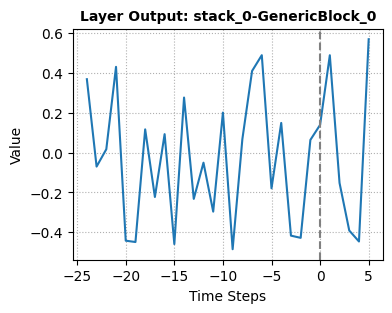

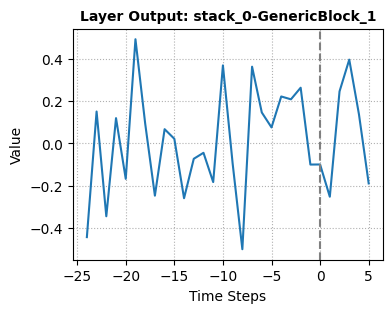

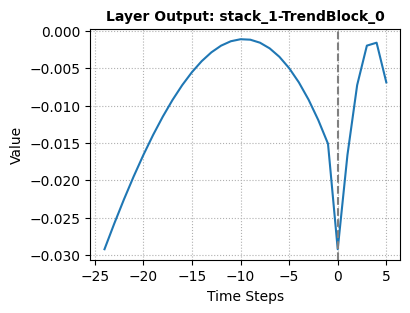

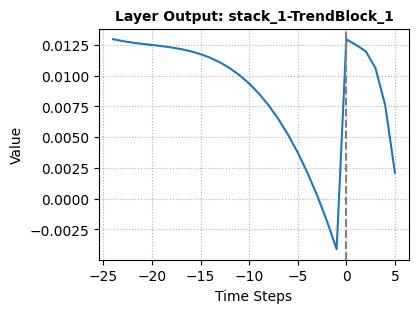

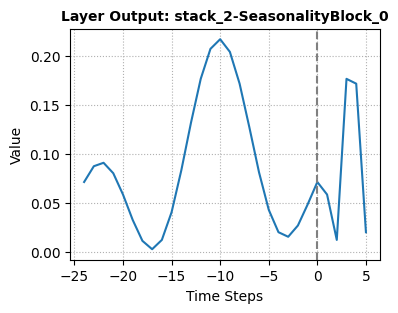

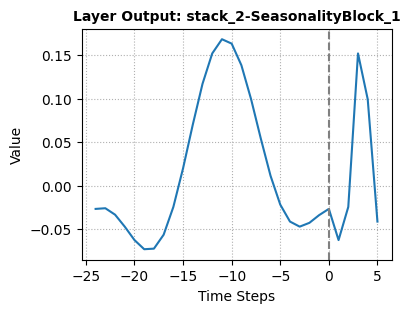

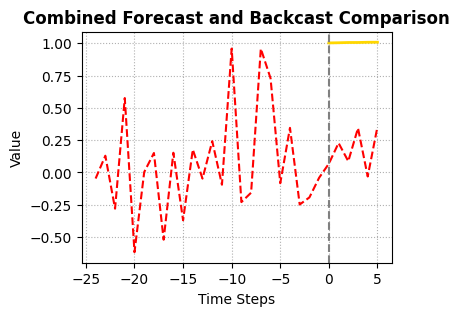

Epoch = 1, Train Loss = 0.2329, Test Loss = 0.8049
Epoch = 2, Train Loss = 0.1738, Test Loss = 0.6454
Epoch = 3, Train Loss = 0.1407, Test Loss = 0.5332
Epoch = 4, Train Loss = 0.1167, Test Loss = 0.4372
Epoch = 5, Train Loss = 0.0966, Test Loss = 0.3534
Epoch = 6, Train Loss = 0.0810, Test Loss = 0.2857
Epoch = 7, Train Loss = 0.0688, Test Loss = 0.2331
Epoch = 8, Train Loss = 0.0583, Test Loss = 0.1898
Epoch = 9, Train Loss = 0.0487, Test Loss = 0.1537
Epoch = 10, Train Loss = 0.0400, Test Loss = 0.1234
Epoch = 11, Train Loss = 0.0323, Test Loss = 0.0986
Epoch = 12, Train Loss = 0.0255, Test Loss = 0.0782
Epoch = 13, Train Loss = 0.0196, Test Loss = 0.0610
Epoch = 14, Train Loss = 0.0147, Test Loss = 0.0472
Epoch = 15, Train Loss = 0.0108, Test Loss = 0.0361
Epoch = 16, Train Loss = 0.0079, Test Loss = 0.0273
Epoch = 17, Train Loss = 0.0057, Test Loss = 0.0206
Epoch = 18, Train Loss = 0.0041, Test Loss = 0.0157
Epoch = 19, Train Loss = 0.0029, Test Loss = 0.0121
Epoch = 20, Train Los

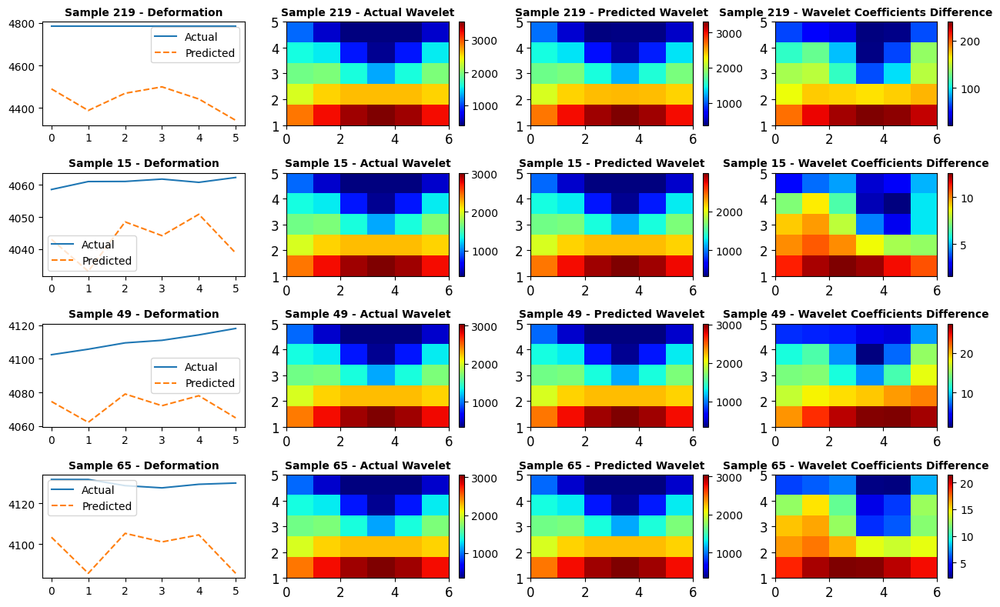

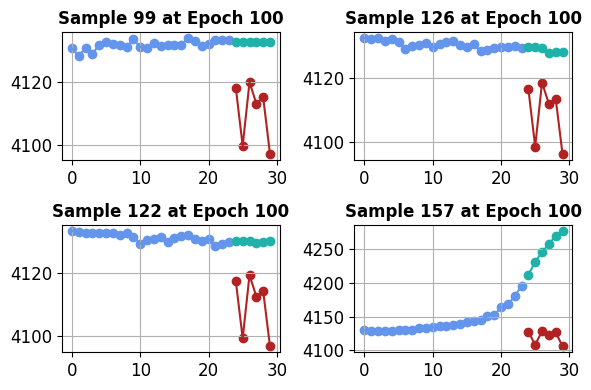

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.3141056 , -0.05542464, -0.01695233,  0.40245244, -0.4587193 ,
       -0.48851255,  0.05741458, -0.21962771,  0.05201806, -0.46564645,
        0.26583058, -0.33980894, -0.02295367, -0.35084334,  0.231291  ,
       -0.5604533 ,  0.00689658,  0.4681858 ,  0.49249947, -0.1893602 ,
        0.15290354, -0.43273807, -0.42849803,  0.08262133], dtype=float32), 'forecast': array([ 0.2631926 ,  0.6891273 , -0.02424954, -0.5248612 , -0.40527728,
        0.64985234], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.51313347,  0.07096509, -0.425969  ,  0.2476213 , -0.18819131,
        0.5864465 ,  0.05004591, -0.22669855,  0.05414464, -0.04904882,
       -0.15771794, -0.06259686, -0.11131189, -0.34284675,  0.49662045,
       -0.11241647, -0.5516856 ,  0.36522165,  0.21116292, -0.05192639,
        0.14425912,  0.10439879,  0.08537275, -0.23517717], dtype=float32), 'forecast': array([ 0.11421463, -0.3268502 ,  0.4

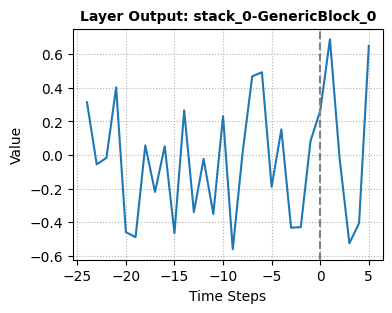

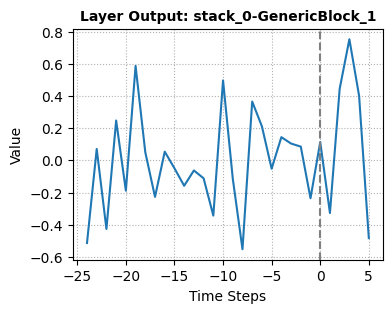

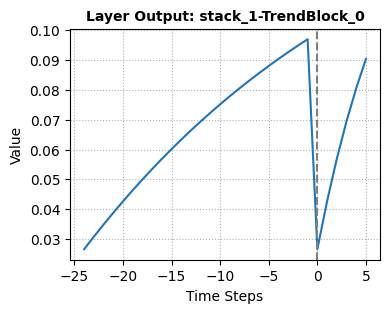

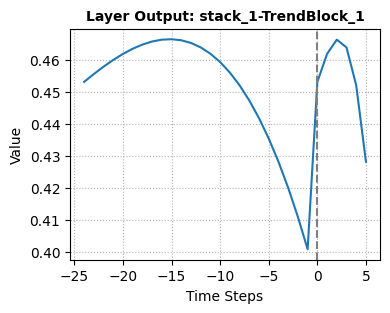

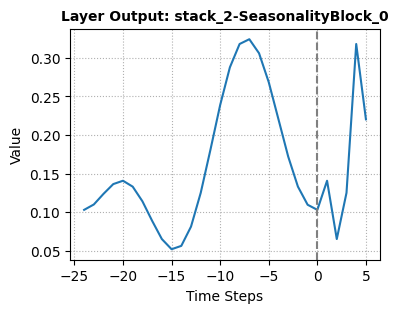

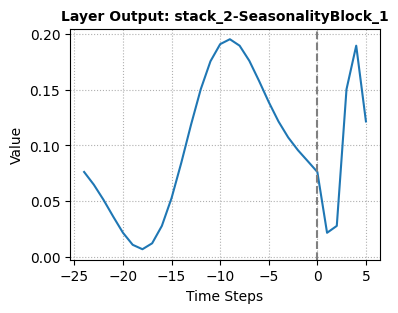

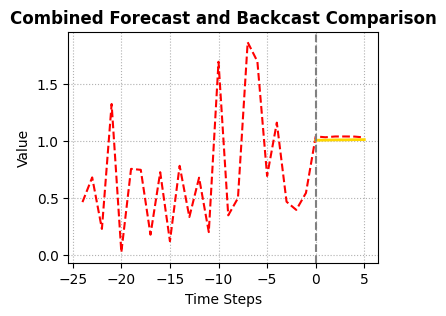

Epoch = 101, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 102, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 103, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 104, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 105, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 106, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 107, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 108, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 109, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 110, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 111, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 112, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 113, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 114, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 115, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 116, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 117, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 118, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 119, Train Loss = 0.0001, Test Loss = 

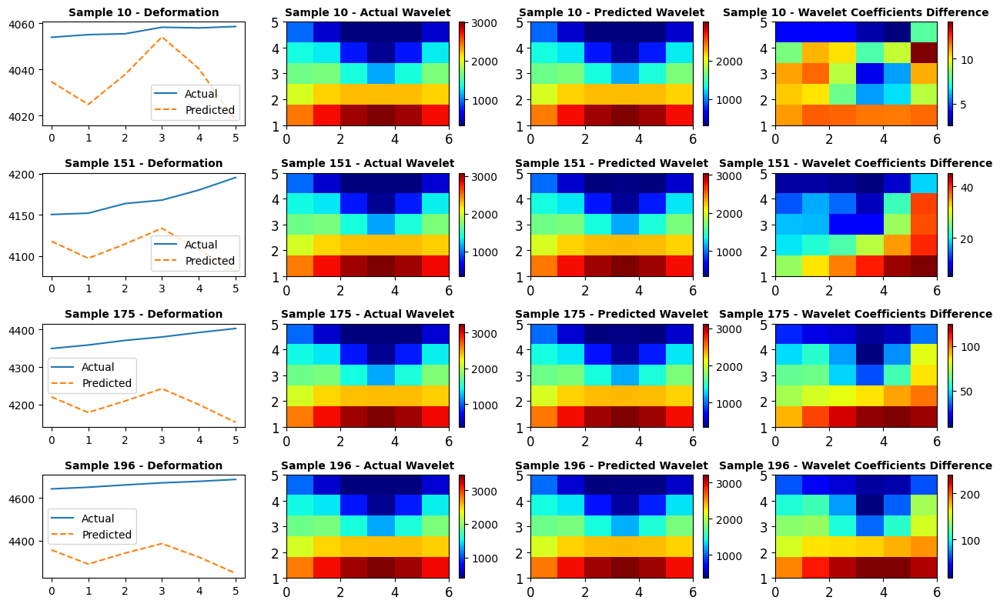

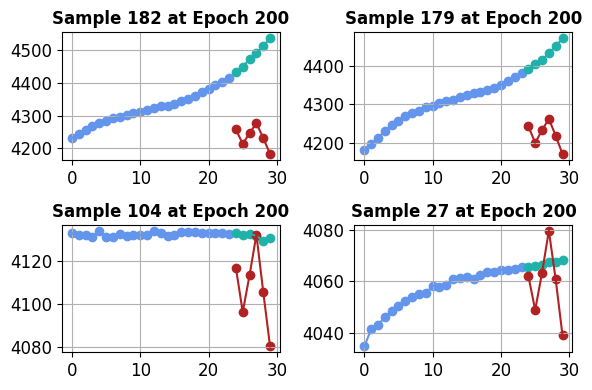

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.30621588, -0.04826956, -0.01316672,  0.38534415, -0.4593444 ,
       -0.48636416,  0.05103784, -0.22688729,  0.04411378, -0.47334757,
        0.27175388, -0.34454724, -0.03243404, -0.35509792,  0.22147949,
       -0.57299423, -0.00323068,  0.46340433,  0.49834794, -0.1982932 ,
        0.14728531, -0.445664  , -0.42879868,  0.07417718], dtype=float32), 'forecast': array([ 0.26475734,  0.6922734 , -0.02386232, -0.5224584 , -0.40834486,
        0.6602499 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.51634365,  0.0522287 , -0.44220307,  0.2592752 , -0.18740414,
        0.60343254,  0.02986116, -0.21683559,  0.04265326, -0.04782856,
       -0.15205401, -0.04599698, -0.0984523 , -0.32930398,  0.4929495 ,
       -0.12400156, -0.57350147,  0.37645322,  0.22591399, -0.04208603,
        0.1261012 ,  0.09763387,  0.06766292, -0.25619015], dtype=float32), 'forecast': array([ 0.11162134, -0.32952064,  0.4

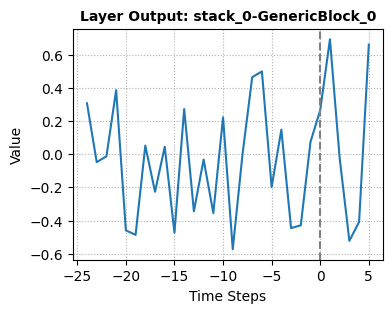

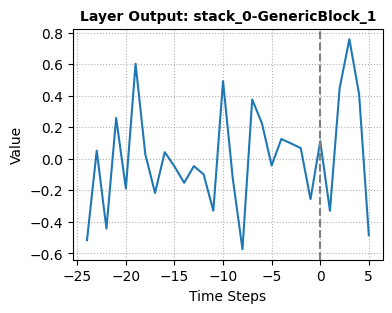

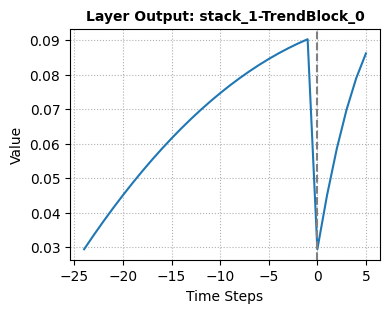

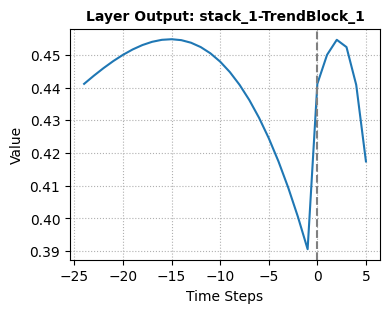

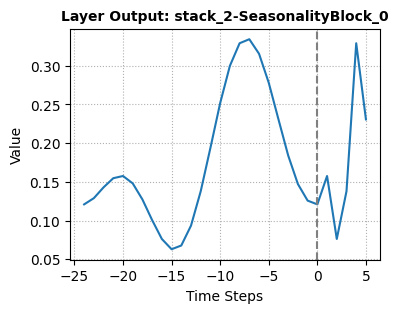

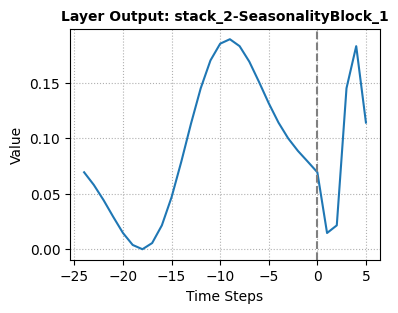

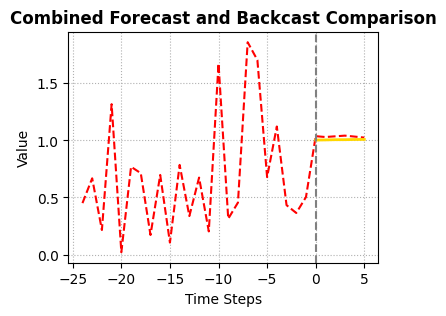

Epoch = 201, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 202, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 203, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 204, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 205, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 206, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 207, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 208, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 209, Train Loss = 0.0002, Test Loss = 0.0016
Epoch = 210, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 211, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 212, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 213, Train Loss = 0.0005, Test Loss = 0.0015
Epoch = 214, Train Loss = 0.0009, Test Loss = 0.0014
Epoch = 215, Train Loss = 0.0010, Test Loss = 0.0020
Epoch = 216, Train Loss = 0.0004, Test Loss = 0.0015
Epoch = 217, Train Loss = 0.0007, Test Loss = 0.0009
Epoch = 218, Train Loss = 0.0015, Test Loss = 0.0008
Epoch = 219, Train Loss = 0.0009, Test Loss = 

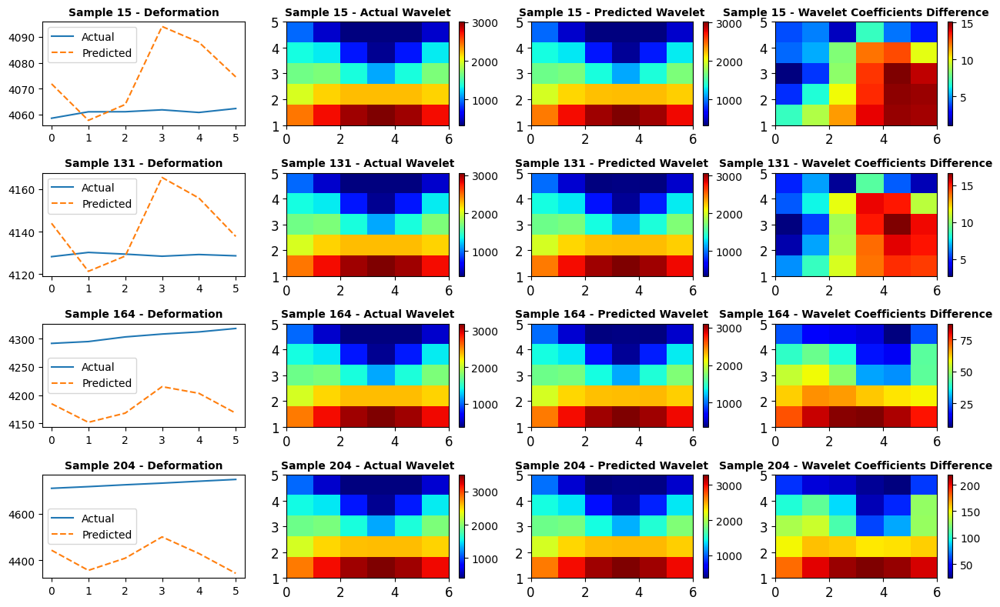

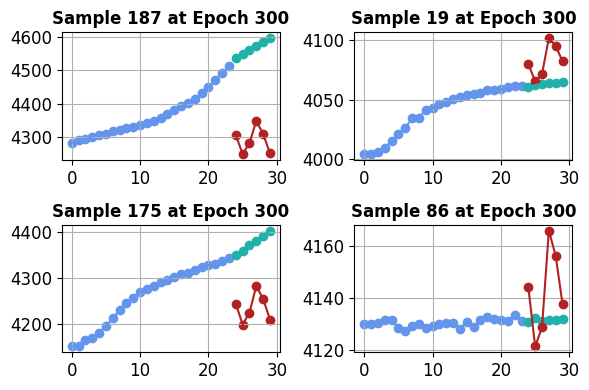

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.32081714, -0.02570049,  0.00751219,  0.39232346, -0.45666105,
       -0.4722935 ,  0.06376458, -0.22770052,  0.05315863, -0.47471857,
        0.2785102 , -0.3105783 , -0.04347663, -0.33744773,  0.2104321 ,
       -0.5614346 ,  0.01043347,  0.45346063,  0.506449  , -0.19460675,
        0.14195716, -0.44351897, -0.42537886,  0.065245  ], dtype=float32), 'forecast': array([ 0.24758466,  0.6564887 , -0.03095171, -0.5011972 , -0.39181852,
        0.62473154], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.47044444,  0.10005453, -0.41216168,  0.2236668 , -0.18386996,
        0.5452313 ,  0.04933624, -0.21204829,  0.04619525, -0.01632831,
       -0.2038761 , -0.0142645 , -0.08591314, -0.2694917 ,  0.43364894,
       -0.11807416, -0.53011215,  0.3623005 ,  0.20819724, -0.00269079,
        0.17090705,  0.12978749,  0.13501976, -0.17688684], dtype=float32), 'forecast': array([ 0.09489252, -0.33272418,  0.4

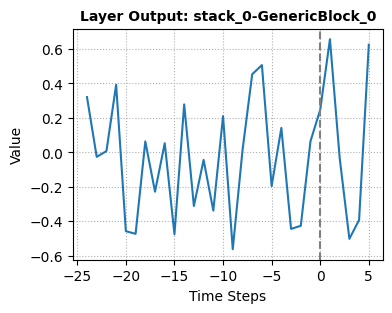

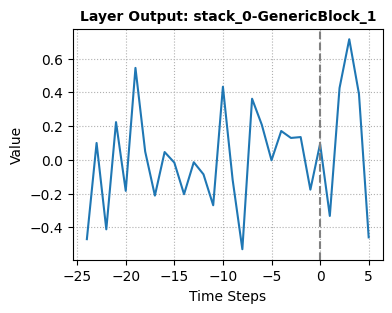

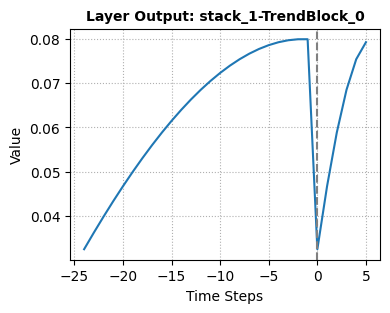

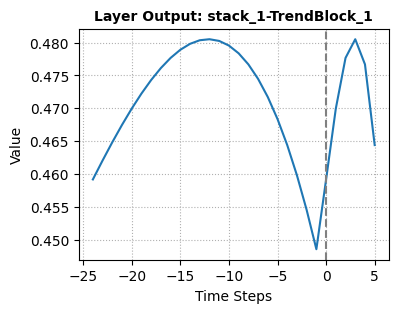

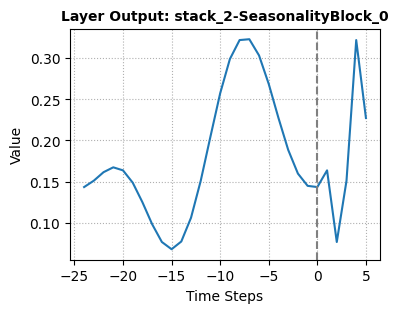

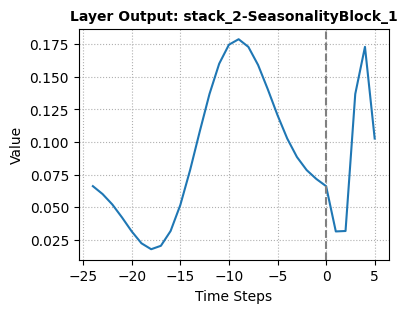

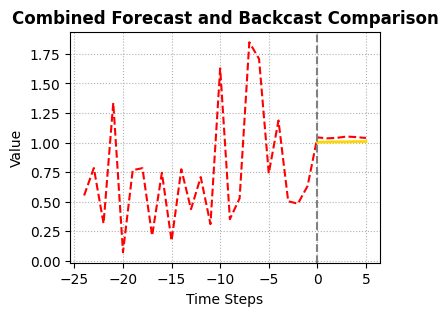

Epoch = 301, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 302, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 303, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 304, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 305, Train Loss = 0.0000, Test Loss = 0.0015
Epoch = 306, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 307, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 308, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 309, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 310, Train Loss = 0.0000, Test Loss = 0.0017
Epoch = 311, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 312, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 313, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 314, Train Loss = 0.0001, Test Loss = 0.0021
Epoch = 315, Train Loss = 0.0001, Test Loss = 0.0019
Epoch = 316, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 317, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 318, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 319, Train Loss = 0.0001, Test Loss = 

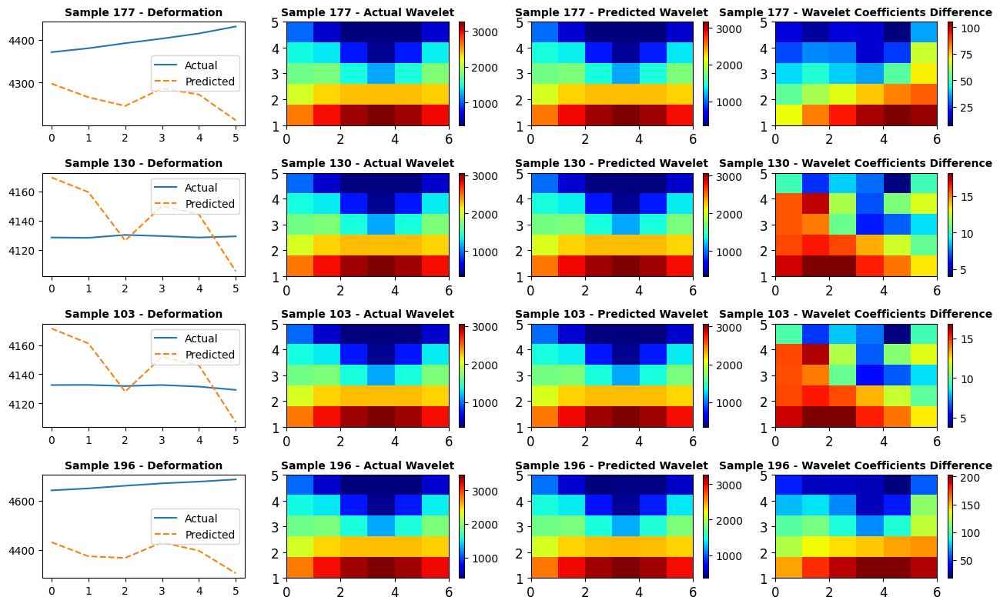

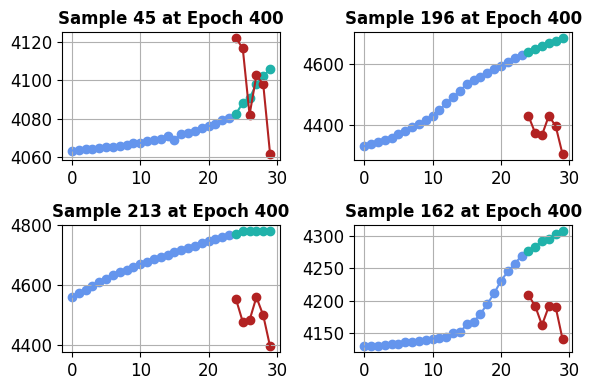

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.3375139 , -0.01530692,  0.01544106,  0.40106586, -0.45832908,
       -0.4593668 ,  0.07222725, -0.23247355,  0.06014114, -0.4735945 ,
        0.28468573, -0.2871331 , -0.05217269, -0.3271192 ,  0.20438926,
       -0.5526057 ,  0.02047628,  0.44669172,  0.514434  , -0.19043767,
        0.13565597, -0.44061288, -0.4203401 ,  0.055894  ], dtype=float32), 'forecast': array([ 0.23989429,  0.643412  , -0.03373868, -0.4963328 , -0.37963524,
        0.60255784], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-4.5092365e-01,  1.3457954e-01, -3.9547142e-01,  1.9476499e-01,
       -1.7606780e-01,  5.1896369e-01,  6.3494727e-02, -2.2590017e-01,
        4.8054606e-02, -4.5134872e-04, -2.1905346e-01,  2.8416223e-04,
       -7.6160893e-02, -2.5046638e-01,  4.1849747e-01, -1.1465870e-01,
       -5.1016104e-01,  3.5489431e-01,  1.8790770e-01,  1.6360458e-02,
        1.9352365e-01,  1.5531261e-01,  1.7976251e-01, -1.

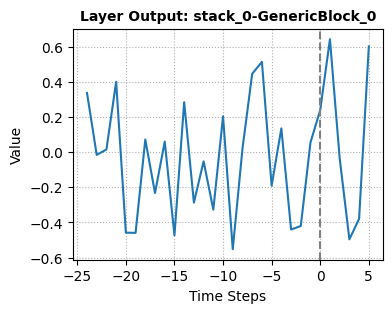

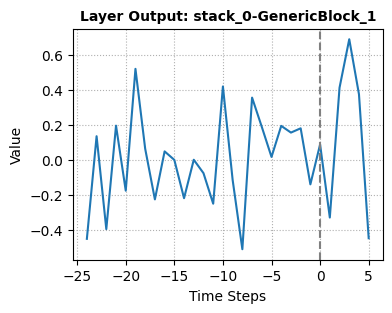

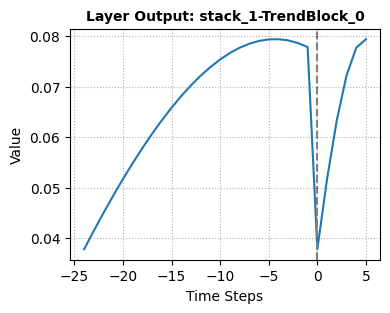

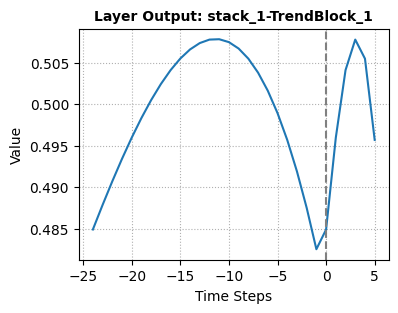

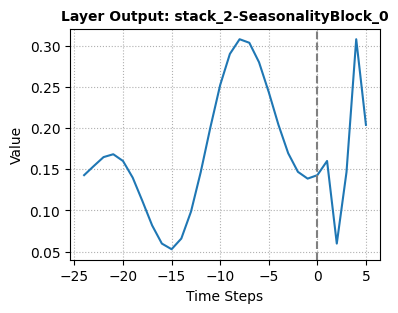

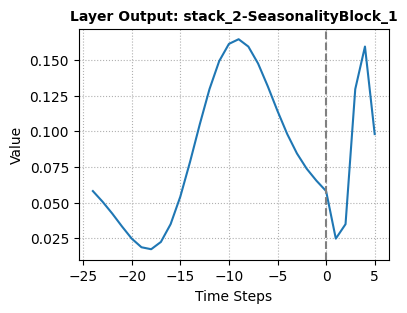

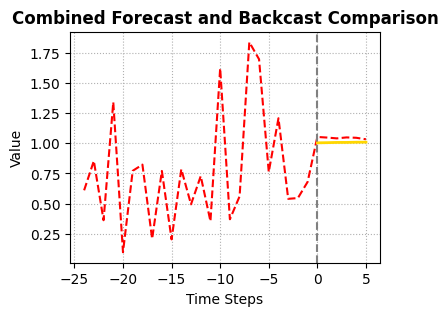

Epoch = 401, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 402, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 403, Train Loss = 0.0003, Test Loss = 0.0021
Epoch = 404, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 405, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 406, Train Loss = 0.0002, Test Loss = 0.0008
Epoch = 407, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 408, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 409, Train Loss = 0.0003, Test Loss = 0.0021
Epoch = 410, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 411, Train Loss = 0.0001, Test Loss = 0.0009
Epoch = 412, Train Loss = 0.0002, Test Loss = 0.0008
Epoch = 413, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 414, Train Loss = 0.0002, Test Loss = 0.0015
Epoch = 415, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 416, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 417, Train Loss = 0.0001, Test Loss = 0.0009
Epoch = 418, Train Loss = 0.0002, Test Loss = 0.0008
Epoch = 419, Train Loss = 0.0001, Test Loss = 

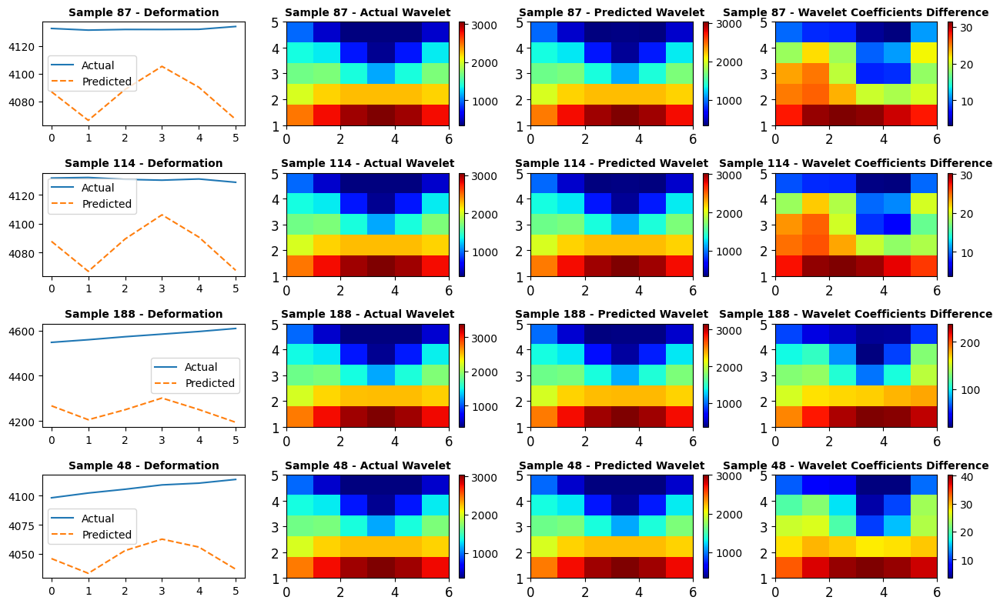

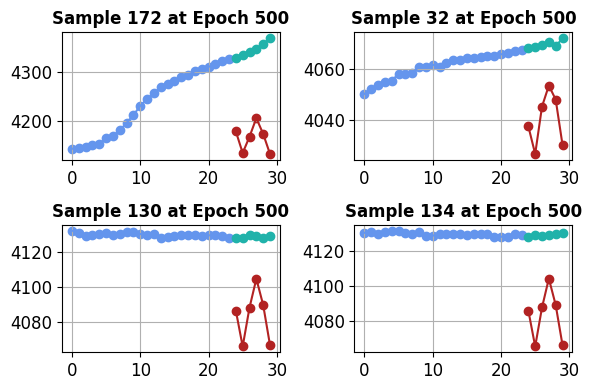

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.35030863, -0.01742005,  0.02507682,  0.41100776, -0.45958865,
       -0.4459527 ,  0.08446705, -0.23546992,  0.07017827, -0.47134963,
        0.29081056, -0.26297393, -0.06154967, -0.31311777,  0.19707361,
       -0.54253054,  0.03337609,  0.43982288,  0.5224134 , -0.18677479,
        0.12924106, -0.4352271 , -0.4162461 ,  0.046989  ], dtype=float32), 'forecast': array([ 0.22837228,  0.623579  , -0.03997137, -0.4894212 , -0.37102327,
        0.57914644], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.43599707,  0.14986737, -0.37948772,  0.16682254, -0.16741262,
        0.49917167,  0.07108739, -0.23241633,  0.04779783,  0.01947391,
       -0.2376744 ,  0.00260606, -0.05584052, -0.21365173,  0.3958924 ,
       -0.11934583, -0.501528  ,  0.3611502 ,  0.17462404,  0.04813068,
        0.20877887,  0.1857037 ,  0.22329265, -0.10832024], dtype=float32), 'forecast': array([ 0.07609287, -0.33163568,  0.3

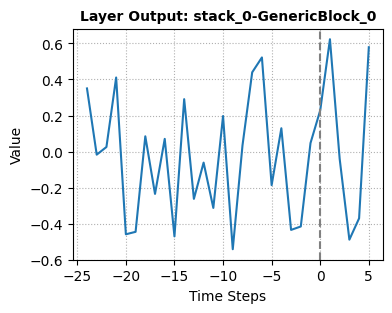

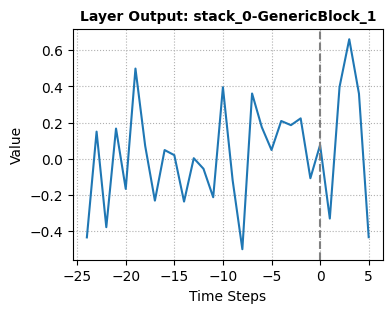

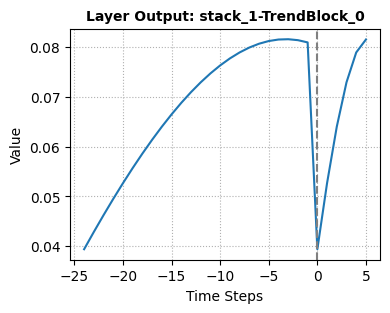

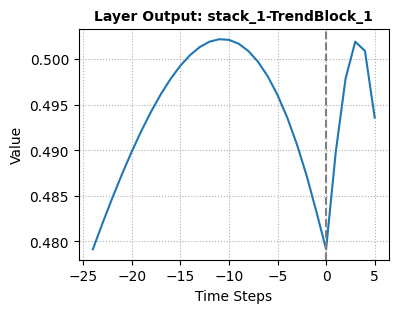

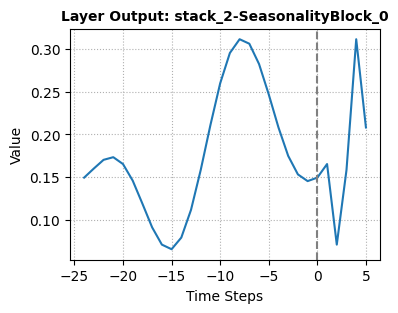

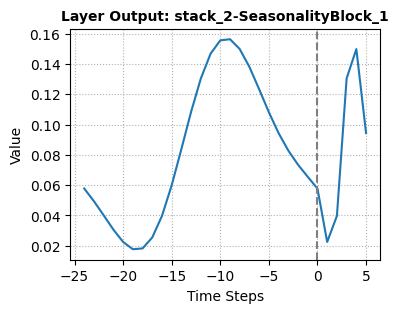

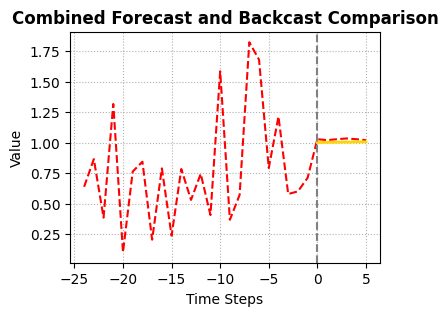

Epoch = 501, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 502, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 503, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 504, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 505, Train Loss = 0.0002, Test Loss = 0.0011
Epoch = 506, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 507, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 508, Train Loss = 0.0002, Test Loss = 0.0016
Epoch = 509, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 510, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 511, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 512, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 513, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 514, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 515, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 516, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 517, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 518, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 519, Train Loss = 0.0002, Test Loss = 

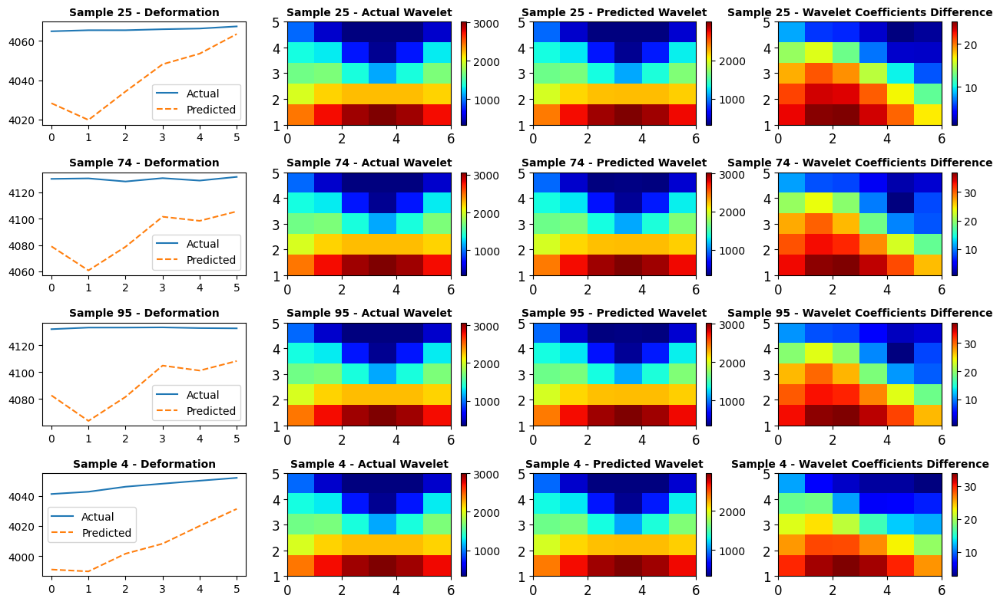

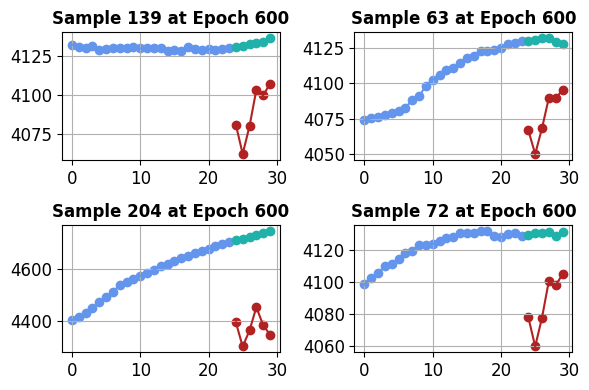

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.36126125, -0.01948676,  0.03100743,  0.416696  , -0.45451844,
       -0.44358537,  0.08969972, -0.23077184,  0.07445508, -0.4690794 ,
        0.28874585, -0.24929452, -0.06124927, -0.3058129 ,  0.19624074,
       -0.5339982 ,  0.04025361,  0.43661985,  0.52014357, -0.18408686,
        0.13012311, -0.43076688, -0.41642743,  0.04963083], dtype=float32), 'forecast': array([ 0.21495514,  0.5980235 , -0.04682956, -0.48006263, -0.3588577 ,
        0.5505218 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.41821775,  0.16104943, -0.36646453,  0.14910837, -0.16198191,
        0.4794171 ,  0.0779136 , -0.2332386 ,  0.04913616,  0.03155221,
       -0.25733593,  0.00401524, -0.04787166, -0.18838723,  0.374026  ,
       -0.11981475, -0.49095294,  0.3607945 ,  0.16544569,  0.06588869,
        0.2223194 ,  0.20262434,  0.2517962 , -0.08104884], dtype=float32), 'forecast': array([ 0.0651229 , -0.32738695,  0.3

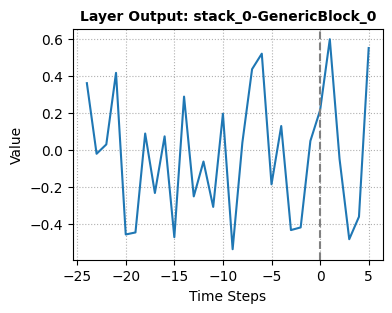

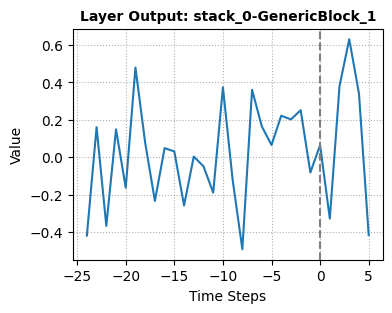

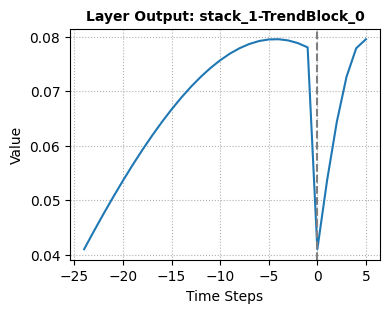

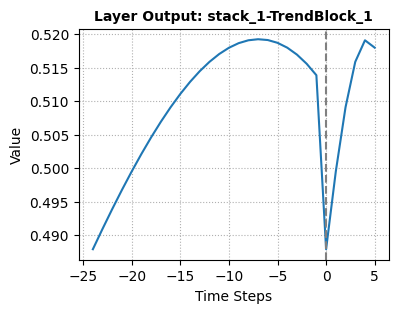

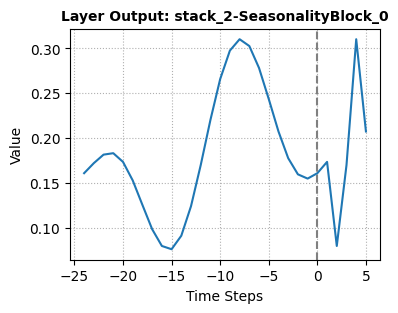

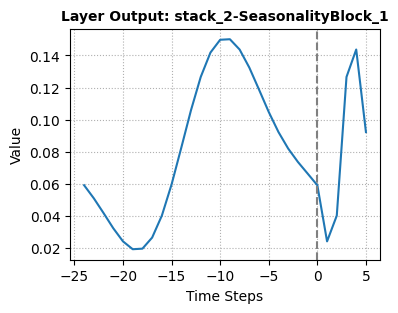

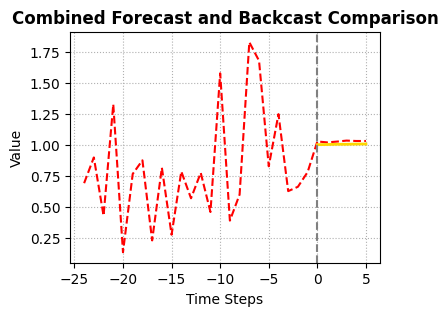

Epoch = 601, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 602, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 603, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 604, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 605, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 606, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 607, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 608, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 609, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 610, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 611, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 612, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 613, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 614, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 615, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 616, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 617, Train Loss = 0.0001, Test Loss = 0.0012
Epoch = 618, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 619, Train Loss = 0.0002, Test Loss = 

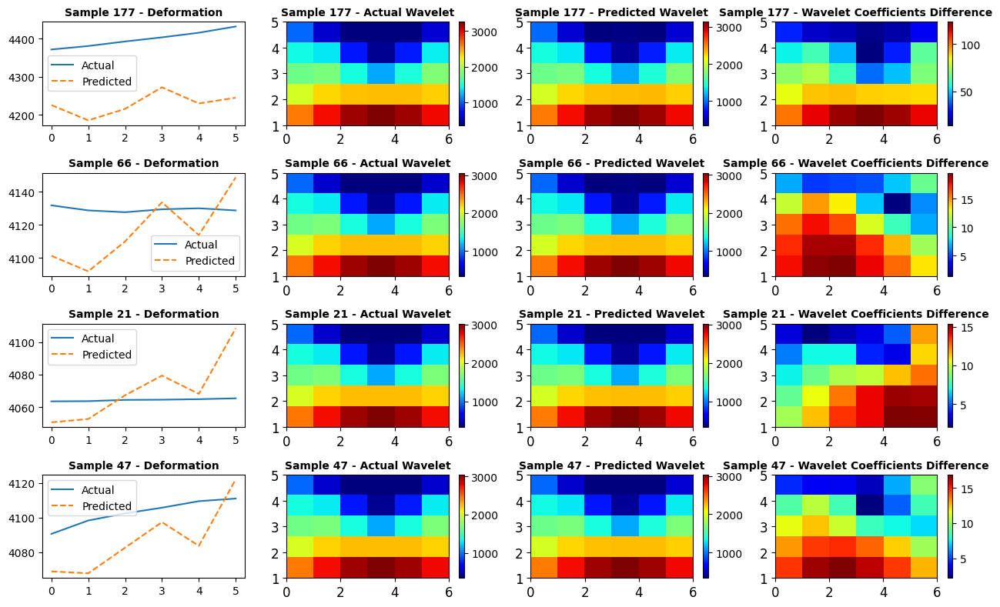

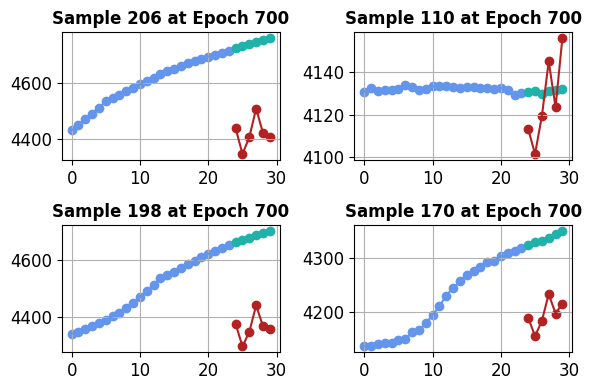

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.37323254, -0.02156619,  0.03620915,  0.42453   , -0.45188156,
       -0.4393739 ,  0.09541029, -0.22862266,  0.079152  , -0.46548805,
        0.2881302 , -0.23453596, -0.06313787, -0.2978746 ,  0.19511448,
       -0.52522784,  0.04785733,  0.43340293,  0.52041185, -0.18028373,
        0.12864695, -0.42585418, -0.41547844,  0.04835523], dtype=float32), 'forecast': array([ 0.20790449,  0.5818431 , -0.04937324, -0.4749954 , -0.35281035,
        0.53484786], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.40541458,  0.17232808, -0.35498813,  0.13453104, -0.15721788,
        0.4627745 ,  0.08566209, -0.23656341,  0.05139516,  0.03887076,
       -0.2708259 ,  0.00322092, -0.04583075, -0.17582415,  0.36053625,
       -0.11786467, -0.4798682 ,  0.35678434,  0.15552293,  0.07412699,
        0.23368716,  0.2140095 ,  0.272611  , -0.06035547], dtype=float32), 'forecast': array([ 0.06150926, -0.32468548,  0.3

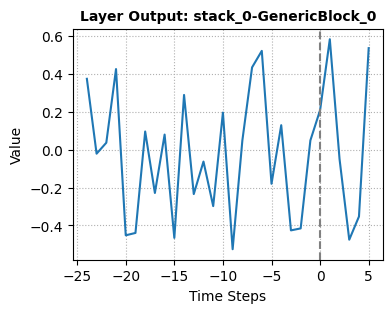

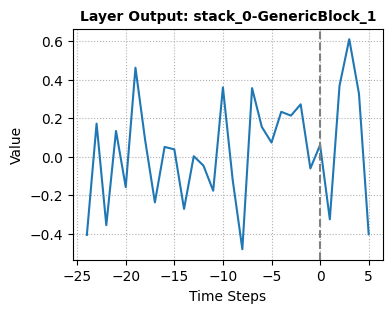

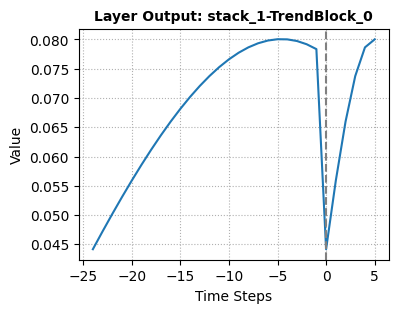

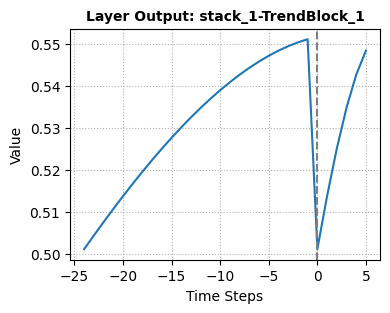

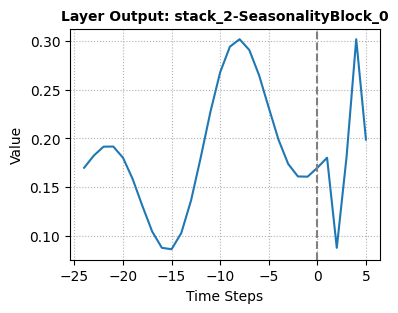

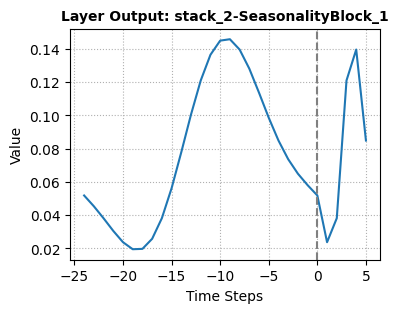

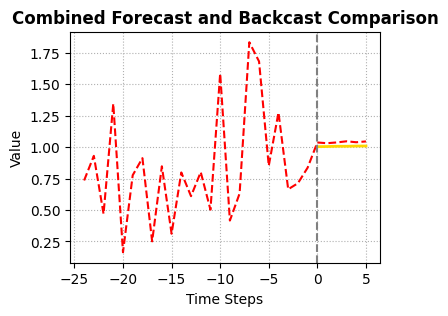

Epoch = 701, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 702, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 703, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 704, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 705, Train Loss = 0.0002, Test Loss = 0.0020
Epoch = 706, Train Loss = 0.0002, Test Loss = 0.0012
Epoch = 707, Train Loss = 0.0001, Test Loss = 0.0010
Epoch = 708, Train Loss = 0.0002, Test Loss = 0.0009
Epoch = 709, Train Loss = 0.0002, Test Loss = 0.0011
Epoch = 710, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 711, Train Loss = 0.0002, Test Loss = 0.0019
Epoch = 712, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 713, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 714, Train Loss = 0.0002, Test Loss = 0.0011
Epoch = 715, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 716, Train Loss = 0.0001, Test Loss = 0.0015
Epoch = 717, Train Loss = 0.0001, Test Loss = 0.0018
Epoch = 718, Train Loss = 0.0001, Test Loss = 0.0013
Epoch = 719, Train Loss = 0.0001, Test Loss = 

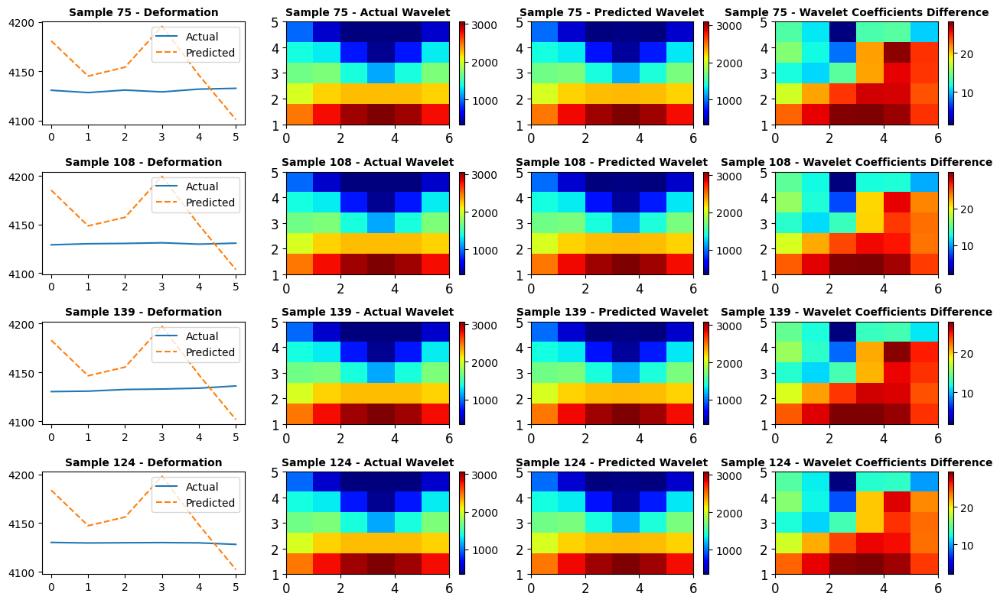

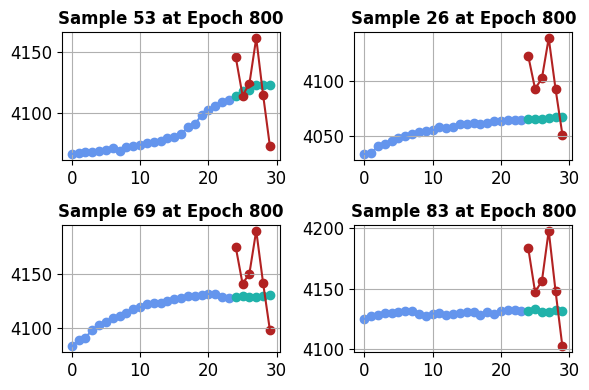

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.38527346, -0.02143631,  0.04183122,  0.43043134, -0.44929734,
       -0.4356973 ,  0.10022411, -0.22539218,  0.08275446, -0.46176368,
        0.28737026, -0.2180617 , -0.06450612, -0.288457  ,  0.19460742,
       -0.51789033,  0.05472343,  0.43056765,  0.5206378 , -0.1765998 ,
        0.12803742, -0.4218429 , -0.41464707,  0.04850632], dtype=float32), 'forecast': array([ 0.2043954 ,  0.5698073 , -0.04755764, -0.47072077, -0.34724715,
        0.51806164], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.39367047,  0.1851368 , -0.34221148,  0.11614683, -0.15128593,
        0.44447437,  0.09372572, -0.24118778,  0.05275497,  0.04754579,
       -0.28569368,  0.00243595, -0.04117988, -0.15842216,  0.34587413,
       -0.11815151, -0.46956933,  0.35471976,  0.14429551,  0.08551277,
        0.2456764 ,  0.22847578,  0.29692993, -0.03796825], dtype=float32), 'forecast': array([ 0.06076605, -0.3228391 ,  0.3

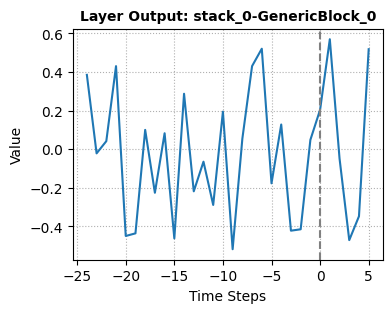

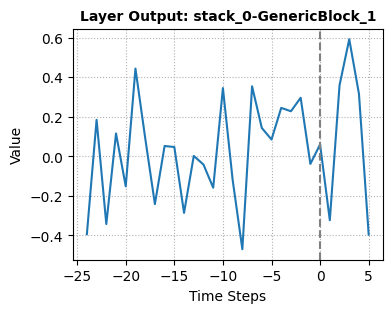

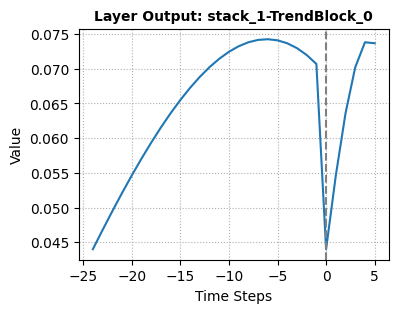

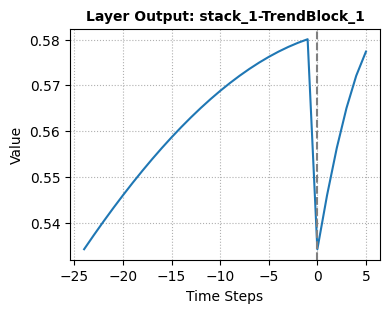

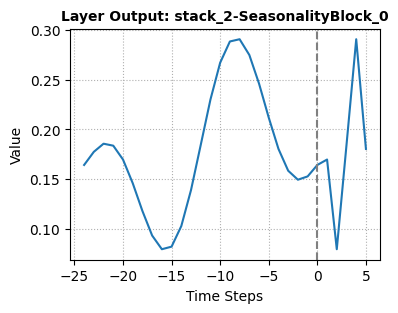

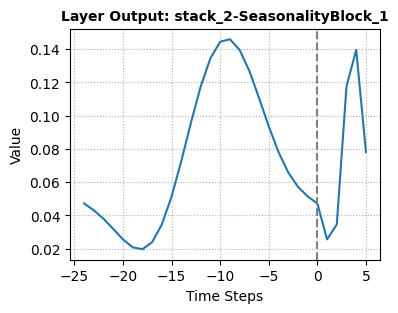

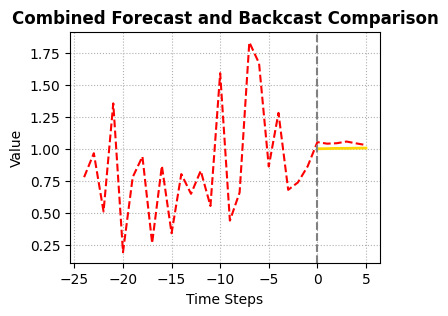

Epoch = 801, Train Loss = 0.0002, Test Loss = 0.0010
Epoch = 802, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 803, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 804, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 805, Train Loss = 0.0000, Test Loss = 0.0012
Epoch = 806, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 807, Train Loss = 0.0000, Test Loss = 0.0012
Epoch = 808, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 809, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 810, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 811, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 812, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 813, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 814, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 815, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 816, Train Loss = 0.0000, Test Loss = 0.0015
Epoch = 817, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 818, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 819, Train Loss = 0.0000, Test Loss = 

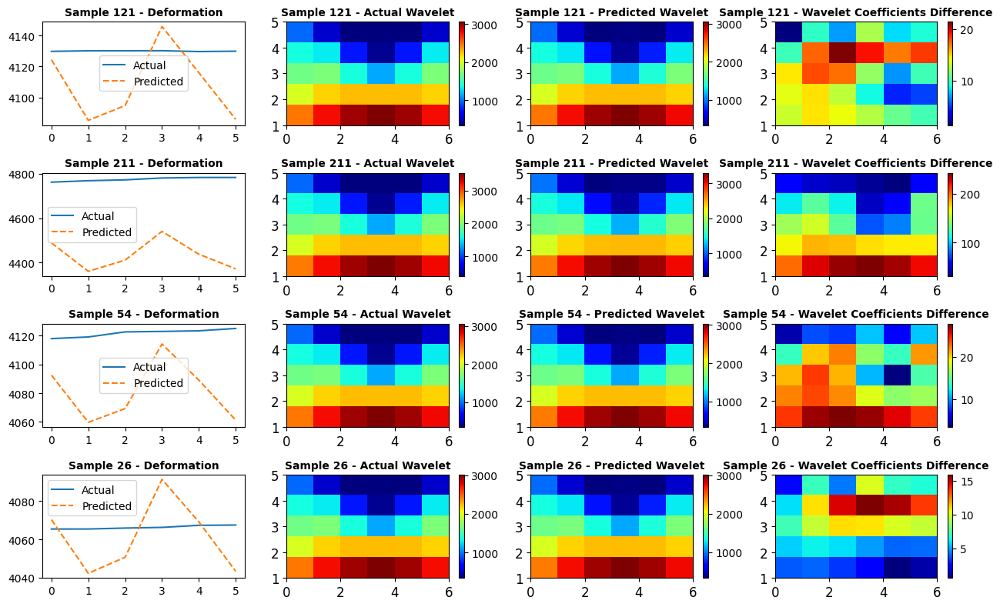

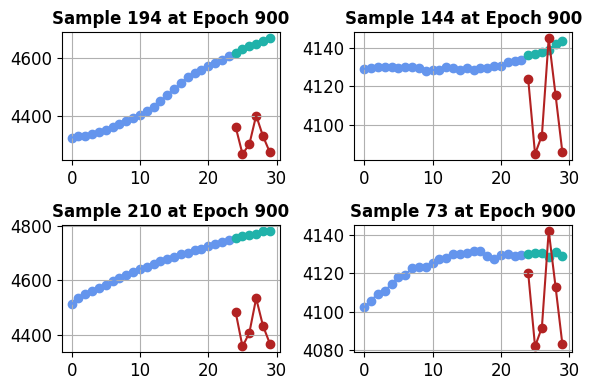

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.385949  , -0.02210294,  0.04614431,  0.42918077, -0.44725007,
       -0.4329487 ,  0.10278682, -0.22436601,  0.08438426, -0.4628691 ,
        0.29018784, -0.21009071, -0.06623252, -0.28439996,  0.19137636,
       -0.51688594,  0.05792127,  0.4279082 ,  0.5215191 , -0.17770162,
        0.12636194, -0.42155632, -0.41444156,  0.04804887], dtype=float32), 'forecast': array([ 0.20164062,  0.559457  , -0.05038111, -0.46764117, -0.34809554,
        0.51070833], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.387383  ,  0.18824974, -0.3371254 ,  0.11092286, -0.14886591,
        0.43848863,  0.09498555, -0.2378643 ,  0.0528581 ,  0.05289987,
       -0.29389504,  0.00414044, -0.03718967, -0.14494967,  0.33582938,
       -0.11893603, -0.4663389 ,  0.35594764,  0.14268081,  0.09381299,
        0.24896668,  0.2344605 ,  0.30593267, -0.02815353], dtype=float32), 'forecast': array([ 0.05438982, -0.32364544,  0.3

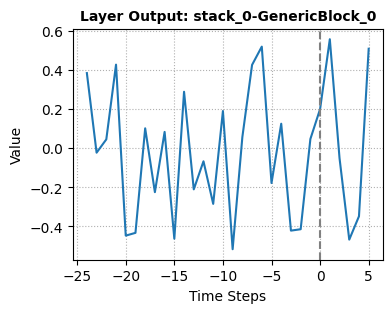

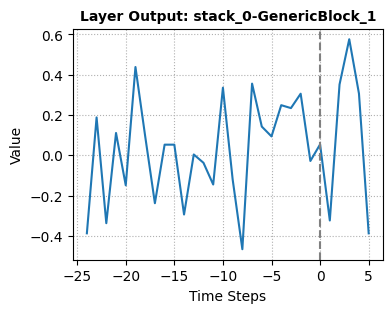

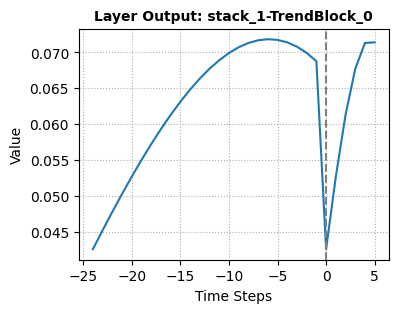

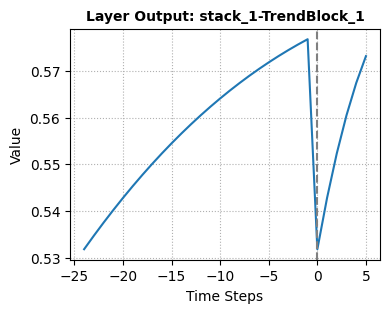

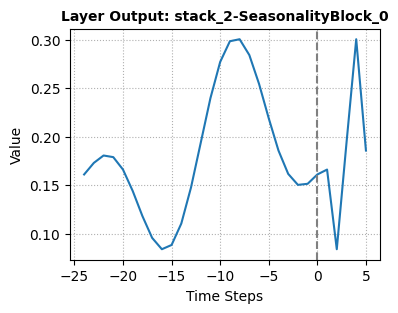

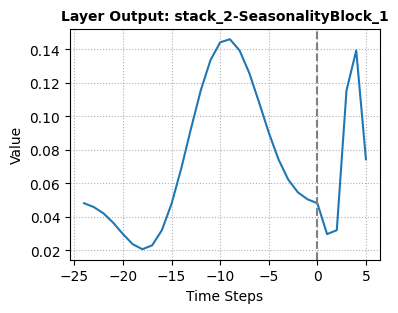

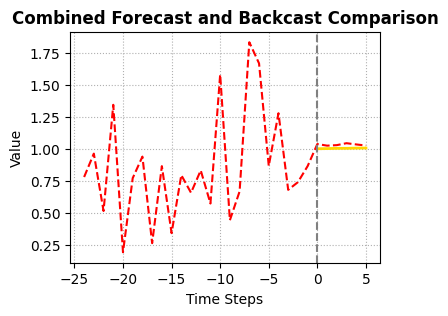

Epoch = 901, Train Loss = 0.0000, Test Loss = 0.0014
Epoch = 902, Train Loss = 0.0000, Test Loss = 0.0015
Epoch = 903, Train Loss = 0.0001, Test Loss = 0.0016
Epoch = 904, Train Loss = 0.0000, Test Loss = 0.0011
Epoch = 905, Train Loss = 0.0000, Test Loss = 0.0015
Epoch = 906, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 907, Train Loss = 0.0000, Test Loss = 0.0015
Epoch = 908, Train Loss = 0.0000, Test Loss = 0.0013
Epoch = 909, Train Loss = 0.0001, Test Loss = 0.0017
Epoch = 910, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 911, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 912, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 913, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 914, Train Loss = 0.0001, Test Loss = 0.0009
Epoch = 915, Train Loss = 0.0001, Test Loss = 0.0014
Epoch = 916, Train Loss = 0.0001, Test Loss = 0.0011
Epoch = 917, Train Loss = 0.0000, Test Loss = 0.0010
Epoch = 918, Train Loss = 0.0001, Test Loss = 0.0008
Epoch = 919, Train Loss = 0.0001, Test Loss = 

In [23]:
save_dir = 'plots_K3_2B3'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

Similar to site K2_2B2, the wavelet analysis results for site K3_2B3 also exhibit a certain degree of consistency between observed and predicted data. However, there are noticeable discrepancies between the observed and predicted outcomes. Additionally, the Genericblock results demonstrate a significant presence of 6 to 7 cycles, aligning with the analysis result (FFT) results. Such alignment between the observed and predicted wavelet patterns suggests that while the model can capture some fundamental periodic behaviors, it may not fully replicate all aspects of the temporal dynamics. The consistent cycles identified in the Generic output and corroborated by frequency domain analysis indicate that the model effectively recognizes and responds to specific dominant periodic signals within the data.

However, the observed discrepancies highlight potential areas for improvement in the model's training or architecture, possibly requiring further parameter tuning or adding additional features that could help enhance the model's sensitivity to subtler patterns not currently captured.

# Neural Network-Based Feature Extraction for Deformation Observations in the Site K1_3B4

In [24]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_24h_climate.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [28]:
data_rainfall_driven_K1_3B4 = data[data.Station_id=='K1_3B4'][['Horizontaldisplacement(mm)']]
data_rainfall_driven_K1_3B4

,Horizontaldisplacement(mm)
date,
2019-06-21,55.30100
2019-06-22,54.56600
2019-06-23,53.83200
2019-06-24,53.28300
2019-06-25,52.92000
...,...
2022-07-28,222.30459
2022-07-29,221.56200
2022-07-30,222.30459


In [29]:
forecast_length = 6
backcast_length = 4 * forecast_length
batch_size = 32  # greater than 4 for viz

data_rainfall_driven_K1_3B4 = data_rainfall_driven_K1_3B4.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_rainfall_driven_K1_3B4) - forecast_length):
    x.append(data_rainfall_driven_K1_3B4[epoch - backcast_length:epoch])
    y.append(data_rainfall_driven_K1_3B4[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

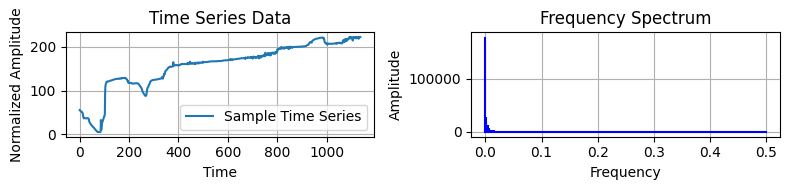

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import os


sample_x = data_rainfall_driven_K1_3B4

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_K1_3B4.pdf'))
plt.show()


| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138144728087760
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138144728077344
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138144728081664
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138144728084400
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138144728083008
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138144728073648


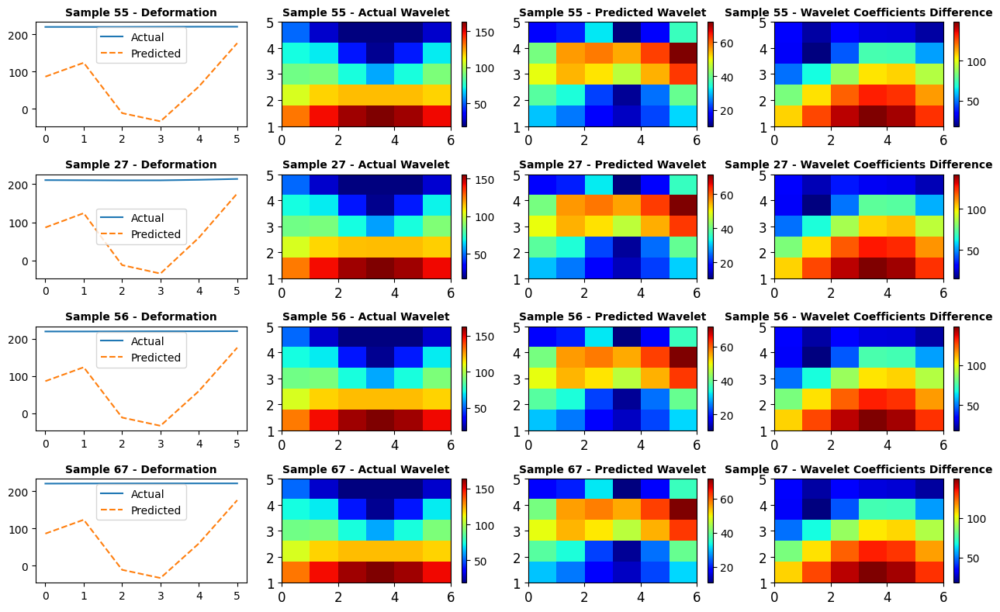

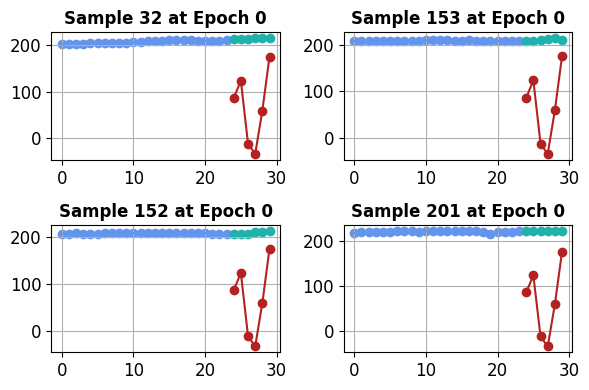

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.06524657,  0.3882087 ,  0.34492287,  0.03303952, -0.01298805,
       -0.34434104, -0.3514964 , -0.09757667, -0.20380448, -0.16350795,
        0.49129656,  0.25078955, -0.12516116, -0.4855052 ,  0.32055125,
       -0.07247964, -0.0484685 ,  0.02093796,  0.28449208,  0.2463502 ,
       -0.33914015,  0.11221012,  0.35926098,  0.16970257], dtype=float32), 'forecast': array([ 0.4958489 ,  0.13595898, -0.15465833, -0.16456999,  0.40631655,
        0.07000881], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.30369577, -0.10413085,  0.24245758,  0.14585344, -0.42053425,
        0.3899013 ,  0.23544277, -0.4736018 ,  0.12446994, -0.35149002,
        0.45427048,  0.09708229,  0.32485238,  0.24328773,  0.04447955,
       -0.01716386,  0.32831064,  0.19753218,  0.0688628 ,  0.23575433,
        0.32871398,  0.33321428,  0.34448776,  0.20958129], dtype=float32), 'forecast': array([-0.28725967,  0.41120547, -0.2

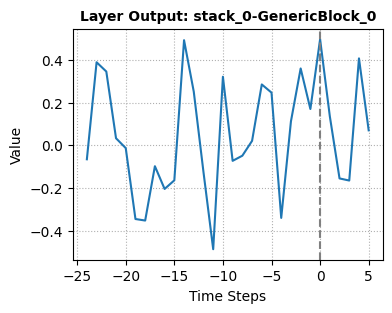

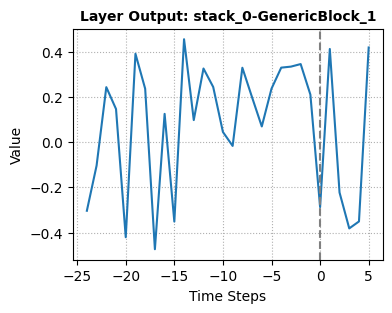

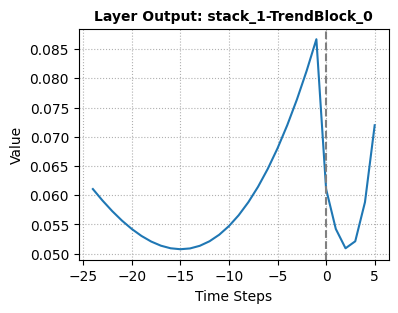

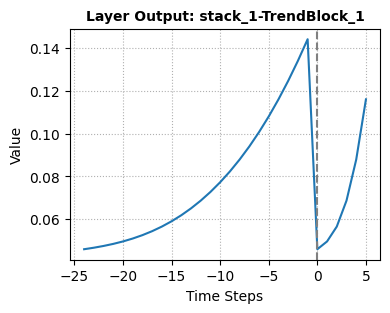

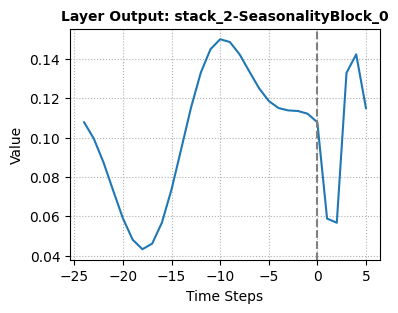

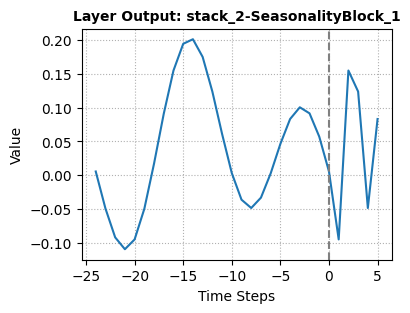

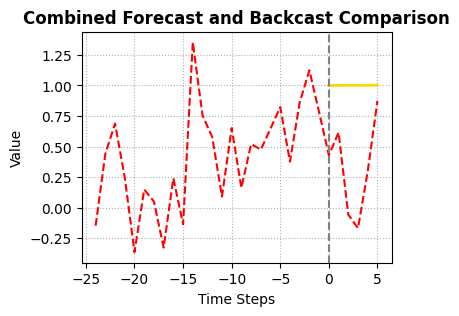

Epoch = 1, Train Loss = 0.4240, Test Loss = 0.6672
Epoch = 2, Train Loss = 0.2926, Test Loss = 0.4762
Epoch = 3, Train Loss = 0.2052, Test Loss = 0.3360
Epoch = 4, Train Loss = 0.1431, Test Loss = 0.2293
Epoch = 5, Train Loss = 0.0989, Test Loss = 0.1510
Epoch = 6, Train Loss = 0.0678, Test Loss = 0.0935
Epoch = 7, Train Loss = 0.0478, Test Loss = 0.0588
Epoch = 8, Train Loss = 0.0371, Test Loss = 0.0436
Epoch = 9, Train Loss = 0.0319, Test Loss = 0.0379
Epoch = 10, Train Loss = 0.0288, Test Loss = 0.0349
Epoch = 11, Train Loss = 0.0263, Test Loss = 0.0326
Epoch = 12, Train Loss = 0.0239, Test Loss = 0.0303
Epoch = 13, Train Loss = 0.0218, Test Loss = 0.0278
Epoch = 14, Train Loss = 0.0200, Test Loss = 0.0253
Epoch = 15, Train Loss = 0.0183, Test Loss = 0.0233
Epoch = 16, Train Loss = 0.0168, Test Loss = 0.0213
Epoch = 17, Train Loss = 0.0154, Test Loss = 0.0194
Epoch = 18, Train Loss = 0.0141, Test Loss = 0.0176
Epoch = 19, Train Loss = 0.0129, Test Loss = 0.0161
Epoch = 20, Train Los

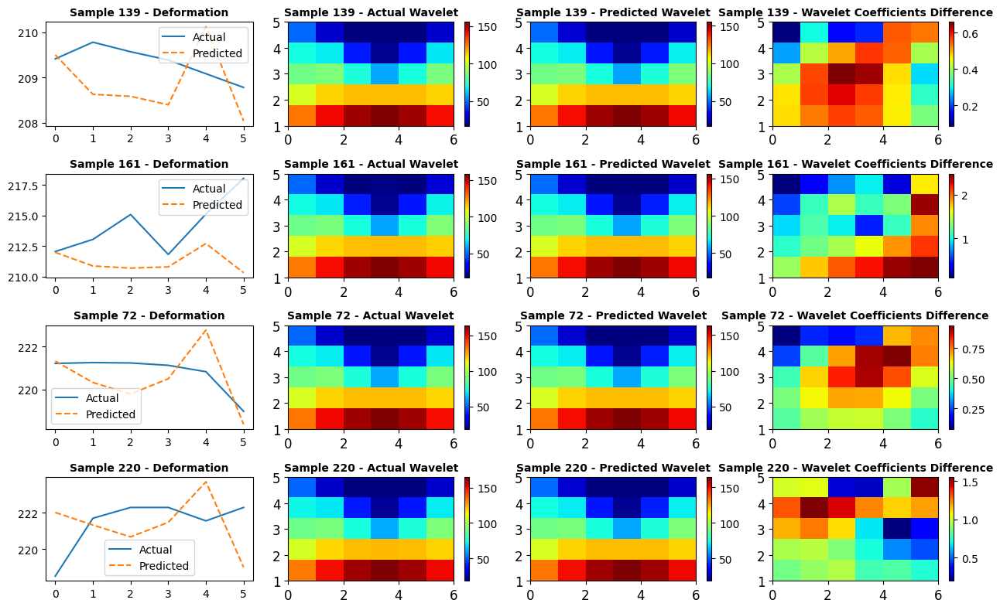

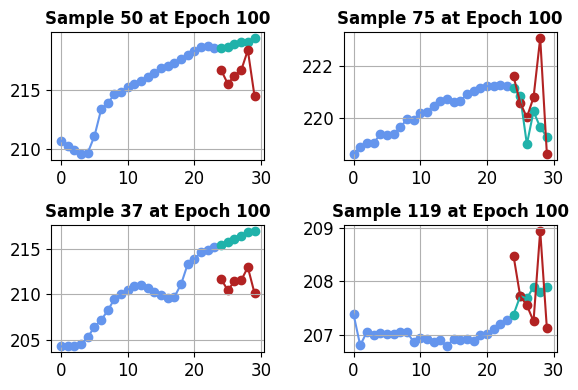

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.08799252,  0.44507137,  0.31892192,  0.03315217, -0.0719686 ,
       -0.29377177, -0.4069866 , -0.1707907 , -0.22811186, -0.2092918 ,
        0.57009774,  0.2824111 , -0.12852174, -0.4668072 ,  0.31796327,
       -0.1318084 , -0.06303239, -0.0223545 ,  0.26628777,  0.28334403,
       -0.3473516 ,  0.10223337,  0.343027  ,  0.1961581 ], dtype=float32), 'forecast': array([ 0.5121415 ,  0.13035025, -0.13507396, -0.09503473,  0.47711903,
       -0.02910931], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.27153334, -0.1882733 ,  0.28032783,  0.14225401, -0.38566858,
        0.31763586,  0.17073081, -0.5840301 ,  0.21959186, -0.47068912,
        0.49545193,  0.17985278,  0.33421838,  0.25128806, -0.11380555,
       -0.12806521,  0.14926688,  0.16561608,  0.12628338,  0.19276582,
        0.18230543,  0.2636731 ,  0.49578565,  0.14255093], dtype=float32), 'forecast': array([-0.13288563,  0.2015925 , -0.0

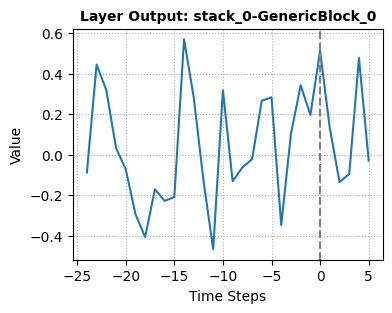

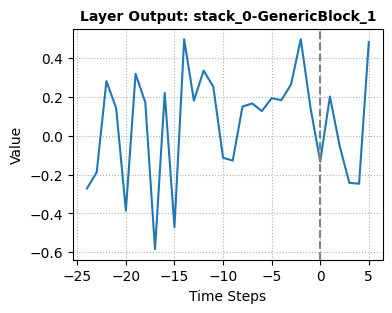

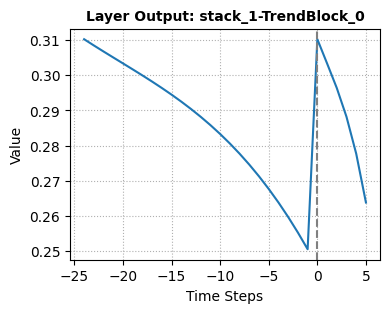

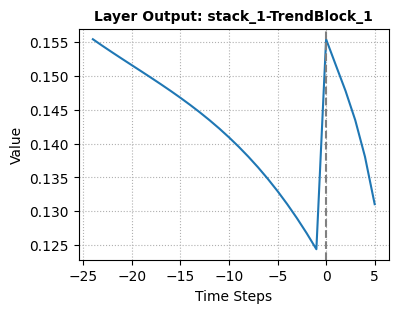

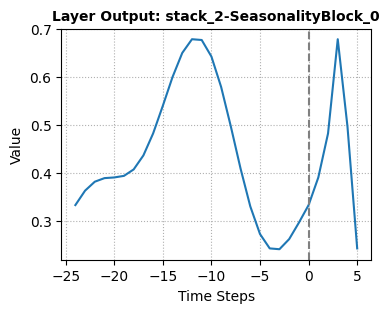

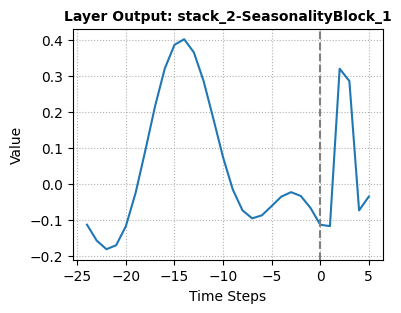

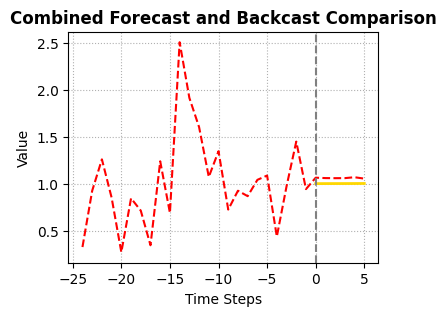

Epoch = 101, Train Loss = 0.0008, Test Loss = 0.0003
Epoch = 102, Train Loss = 0.0008, Test Loss = 0.0003
Epoch = 103, Train Loss = 0.0008, Test Loss = 0.0003
Epoch = 104, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 105, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 106, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 107, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 108, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 109, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 110, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 111, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 112, Train Loss = 0.0007, Test Loss = 0.0003
Epoch = 113, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 114, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 115, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 116, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 117, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 118, Train Loss = 0.0006, Test Loss = 0.0003
Epoch = 119, Train Loss = 0.0006, Test Loss = 

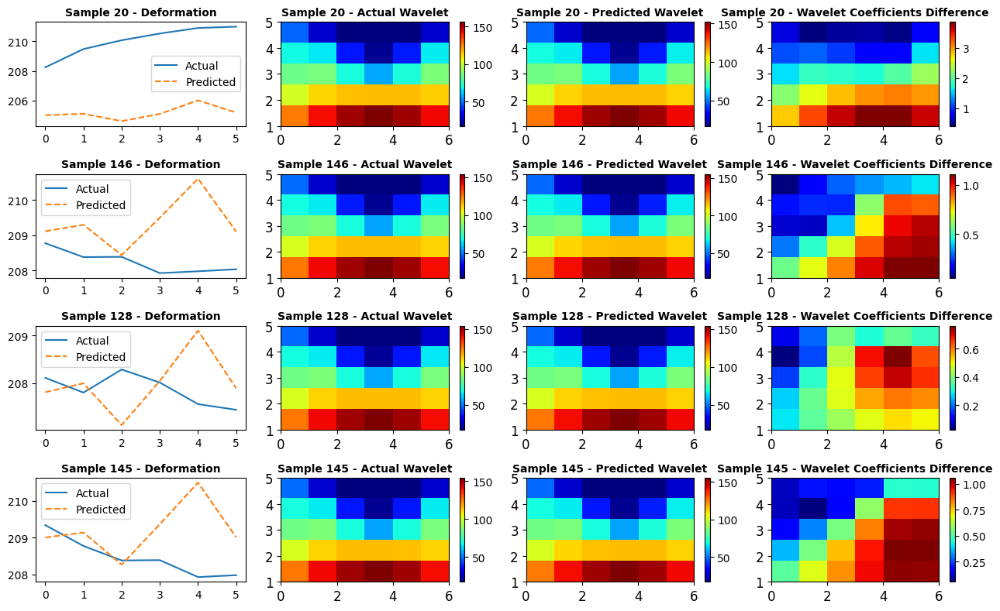

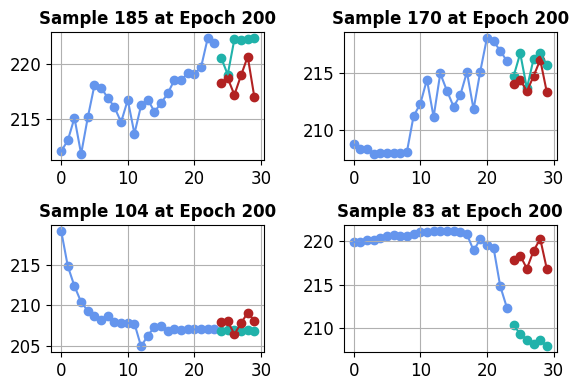

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.09160146,  0.44036812,  0.32305002,  0.02966639, -0.06330316,
       -0.30078557, -0.40522873, -0.16564357, -0.22748932, -0.21107167,
        0.5649047 ,  0.28229865, -0.12563147, -0.4699454 ,  0.31378093,
       -0.12067446, -0.05785858, -0.02746399,  0.26820797,  0.2830964 ,
       -0.3492755 ,  0.10632697,  0.3422318 ,  0.1887417 ], dtype=float32), 'forecast': array([ 0.51076186,  0.12438568, -0.14182588, -0.08389515,  0.48071468,
       -0.03561766], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.25919557, -0.1955851 ,  0.28105235,  0.13727218, -0.39410737,
        0.3142668 ,  0.16763642, -0.5816439 ,  0.22508216, -0.4901433 ,
        0.49948594,  0.19945365,  0.32819197,  0.24652594, -0.12504448,
       -0.1285053 ,  0.14724874,  0.16827339,  0.12758118,  0.18981698,
        0.18905187,  0.25161228,  0.49103367,  0.13491678], dtype=float32), 'forecast': array([-0.1465089 ,  0.22388653, -0.0

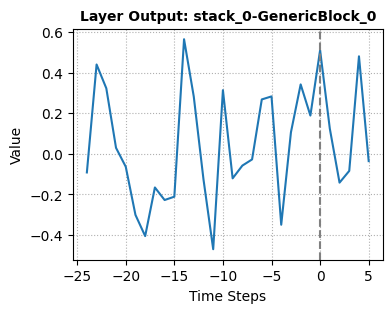

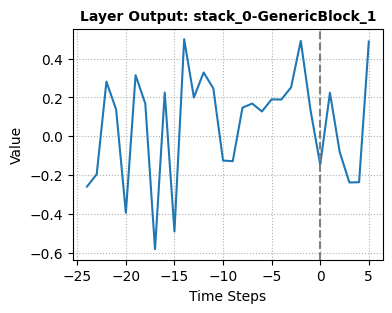

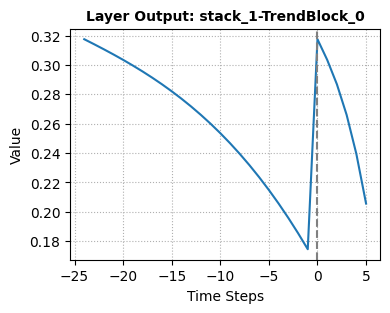

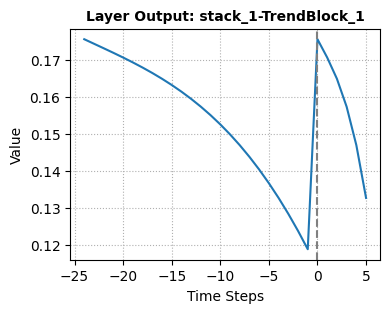

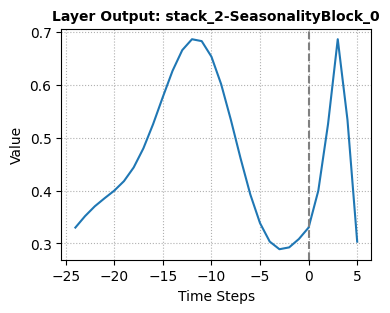

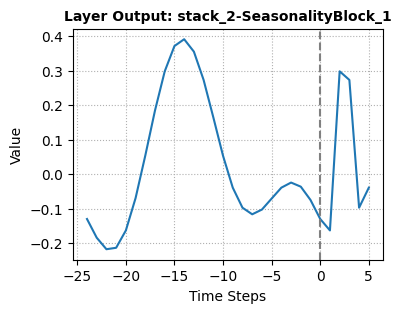

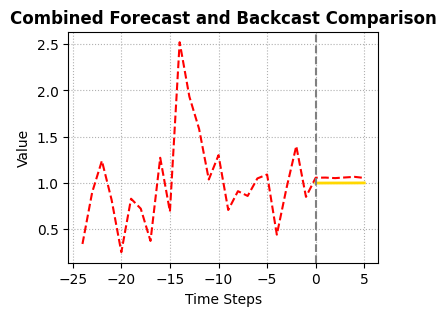

Epoch = 201, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 202, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 203, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 204, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 205, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 206, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 207, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 208, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 209, Train Loss = 0.0003, Test Loss = 0.0003
Epoch = 210, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 211, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 212, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 213, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 214, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 215, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 216, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 217, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 218, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 219, Train Loss = 0.0003, Test Loss = 

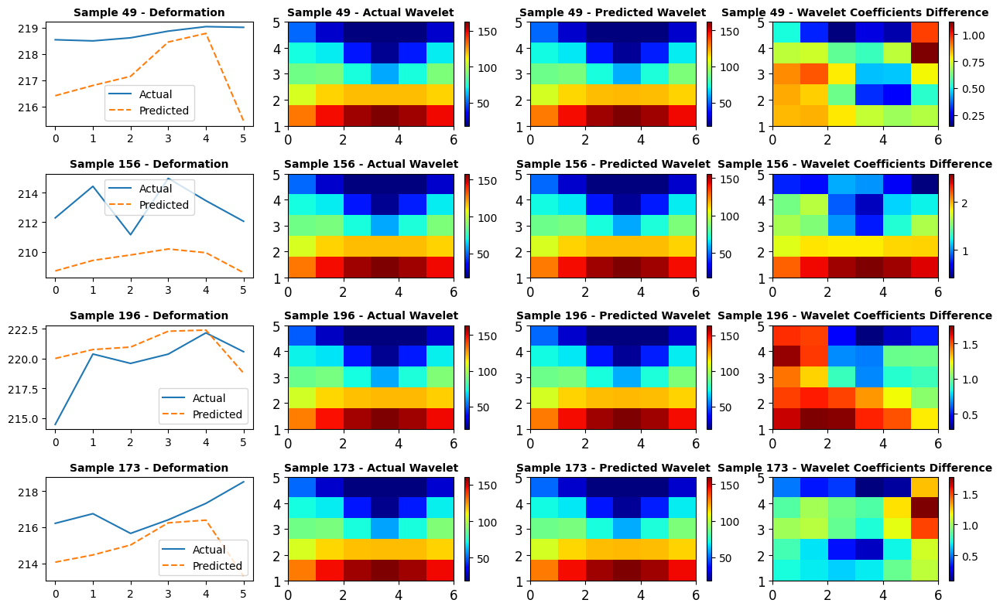

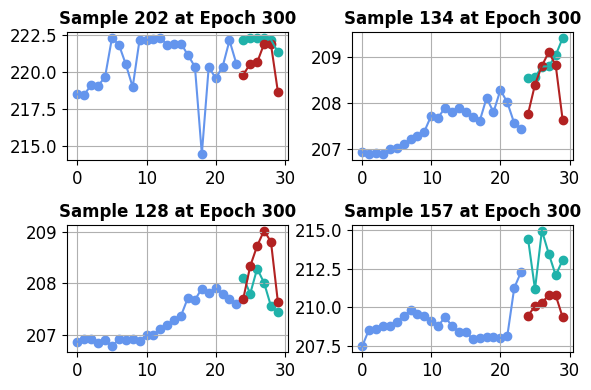

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.09188525,  0.42911118,  0.32804716,  0.0258962 , -0.05637403,
       -0.30513987, -0.4011754 , -0.15881838, -0.22186686, -0.20399037,
        0.5543378 ,  0.2732778 , -0.12159905, -0.46598107,  0.30957127,
       -0.11073111, -0.05785359, -0.02509852,  0.27188748,  0.27995244,
       -0.35192594,  0.11080415,  0.34722114,  0.18539466], dtype=float32), 'forecast': array([ 0.51371664,  0.12021364, -0.1474208 , -0.07625727,  0.49222514,
       -0.04572311], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.2533266 , -0.18937661,  0.28318298,  0.14076334, -0.3875597 ,
        0.3168938 ,  0.1738521 , -0.57316965,  0.22676015, -0.48155507,
        0.4977536 ,  0.19590963,  0.3377885 ,  0.2571993 , -0.11841108,
       -0.1188843 ,  0.15582465,  0.16395654,  0.11406198,  0.18845539,
        0.19029151,  0.25367317,  0.48415402,  0.13653724], dtype=float32), 'forecast': array([-0.15766804,  0.22871397, -0.0

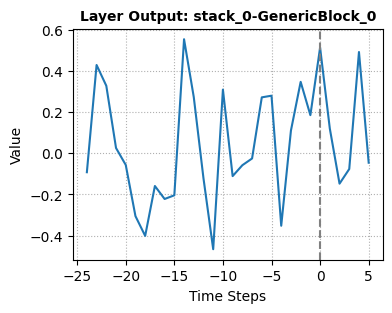

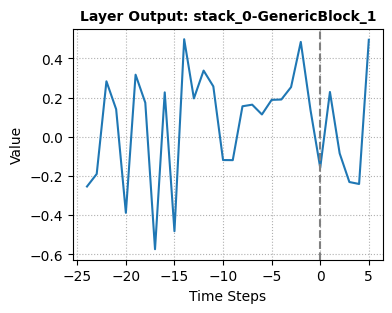

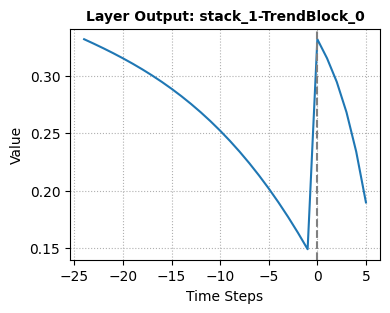

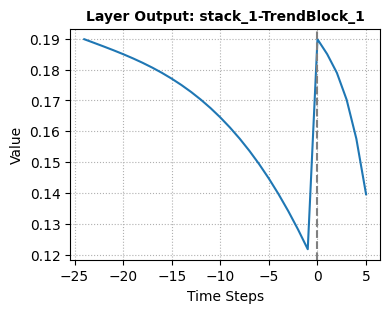

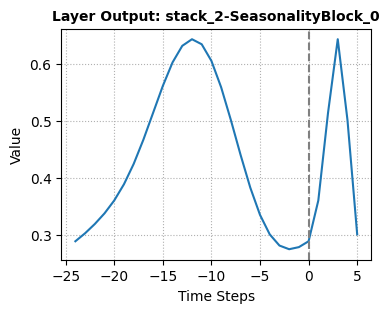

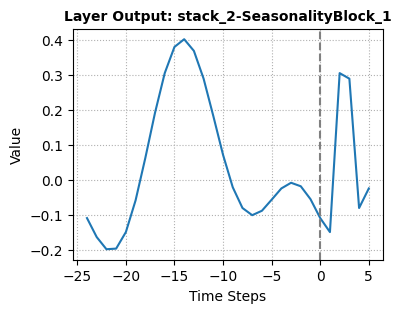

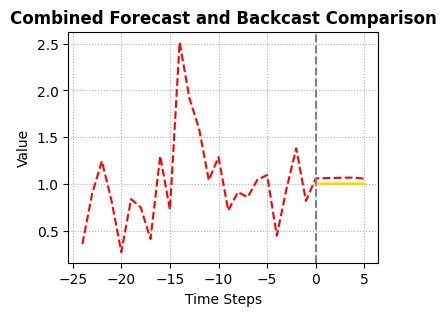

Epoch = 301, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 302, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 303, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 304, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 305, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 306, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 307, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 308, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 309, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 310, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 311, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 312, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 313, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 314, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 315, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 316, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 317, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 318, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 319, Train Loss = 0.0002, Test Loss = 

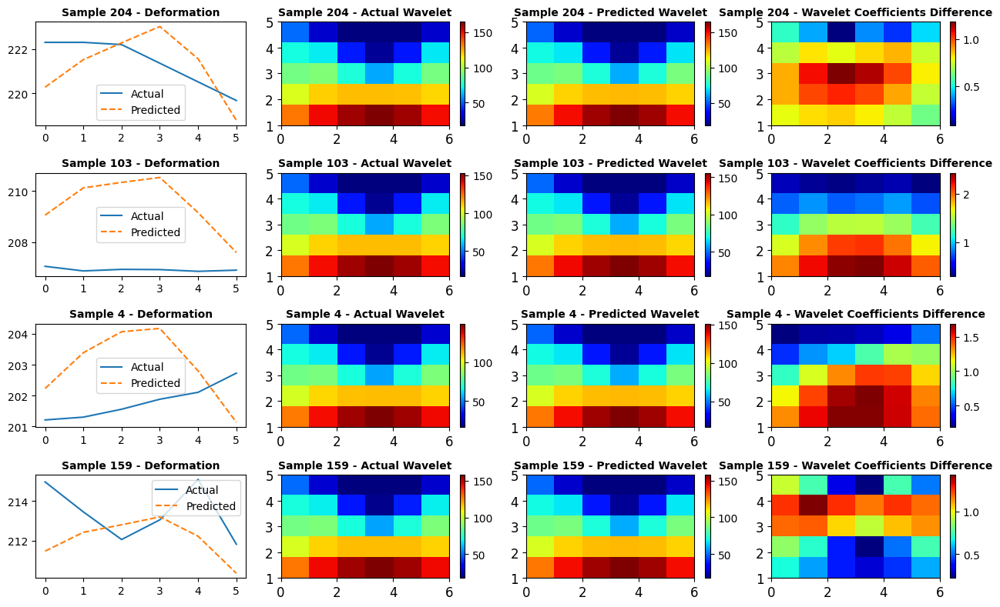

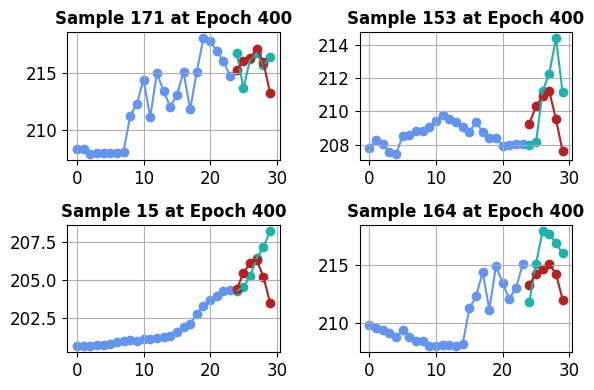

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.0900388 ,  0.42020246,  0.33279   ,  0.02572006, -0.05104603,
       -0.30841893, -0.39476192, -0.15148042, -0.21358006, -0.19883807,
        0.5449072 ,  0.26646546, -0.1215867 , -0.46515444,  0.30701455,
       -0.10042591, -0.05616111, -0.02028769,  0.2730318 ,  0.2758102 ,
       -0.3539813 ,  0.11258143,  0.35190374,  0.18386908], dtype=float32), 'forecast': array([ 0.51393366,  0.11671897, -0.14992857, -0.07456861,  0.496535  ,
       -0.04711689], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.25084633, -0.18223132,  0.28275308,  0.14263323, -0.38470802,
        0.3192183 ,  0.18585142, -0.5634959 ,  0.22699437, -0.47312987,
        0.49431095,  0.19166595,  0.34186667,  0.26755437, -0.11320529,
       -0.10644319,  0.1665434 ,  0.1599718 ,  0.10169841,  0.19095457,
        0.19444355,  0.25769433,  0.47574815,  0.14081162], dtype=float32), 'forecast': array([-0.16784048,  0.22762579, -0.0

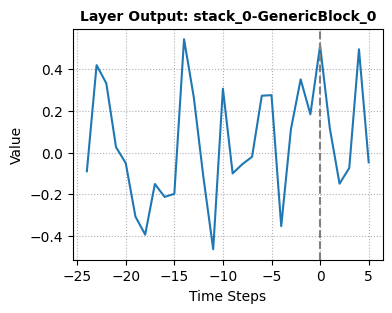

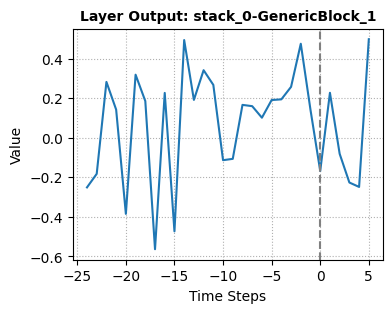

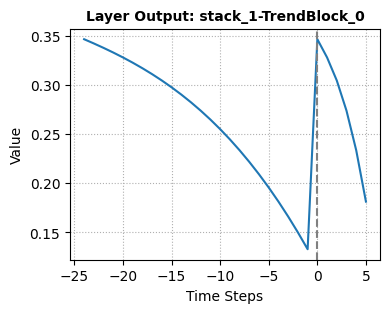

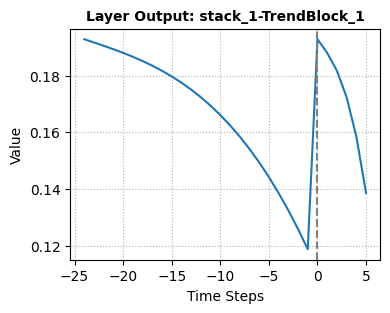

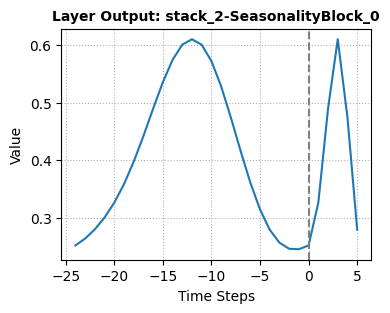

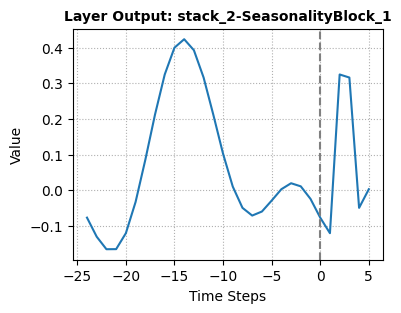

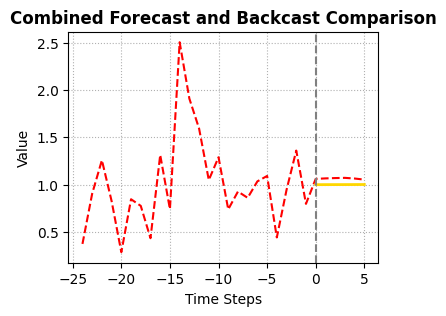

Epoch = 401, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 402, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 403, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 404, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 405, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 406, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 407, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 408, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 409, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 410, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 411, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 412, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 413, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 414, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 415, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 416, Train Loss = 0.0003, Test Loss = 0.0003
Epoch = 417, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 418, Train Loss = 0.0003, Test Loss = 0.0003
Epoch = 419, Train Loss = 0.0002, Test Loss = 

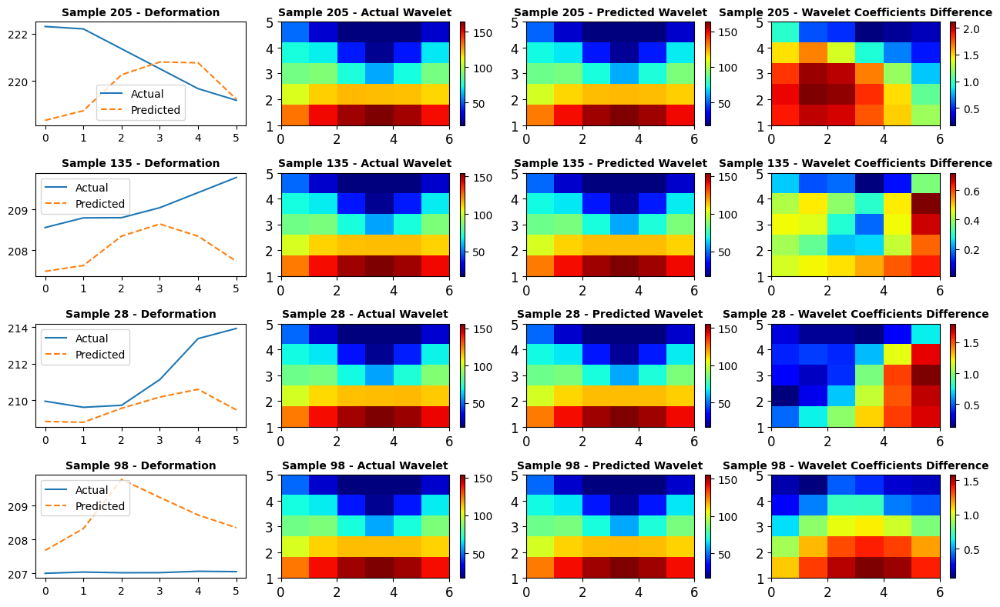

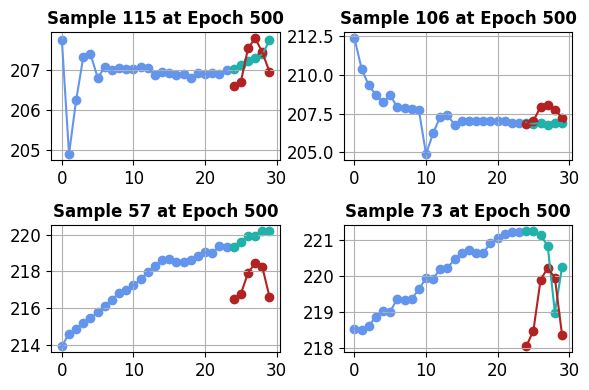

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.08505976,  0.41605026,  0.33799714,  0.02840119, -0.04829977,
       -0.30702972, -0.38767302, -0.14507717, -0.20674108, -0.1944202 ,
        0.5381958 ,  0.26218915, -0.1224633 , -0.46487898,  0.30686897,
       -0.09741056, -0.05532686, -0.01391036,  0.2720396 ,  0.2707203 ,
       -0.35521424,  0.11100079,  0.3557963 ,  0.18569592], dtype=float32), 'forecast': array([ 0.5146238 ,  0.11158773, -0.15230419, -0.07549676,  0.5003347 ,
       -0.0455752 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.25161442, -0.17540069,  0.28173023,  0.14472985, -0.3839573 ,
        0.32631993,  0.19406171, -0.5552505 ,  0.22267947, -0.45961317,
        0.4914449 ,  0.18257698,  0.34369996,  0.27808514, -0.10104372,
       -0.09272821,  0.1821775 ,  0.15898752,  0.09105281,  0.19350678,
        0.2016633 ,  0.26379645,  0.46519202,  0.14711171], dtype=float32), 'forecast': array([-0.17567459,  0.22938438, -0.0

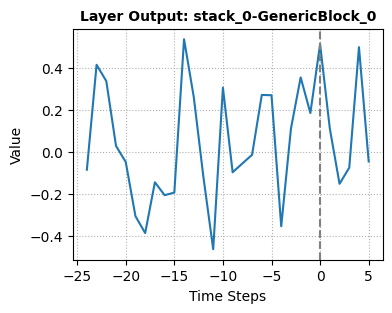

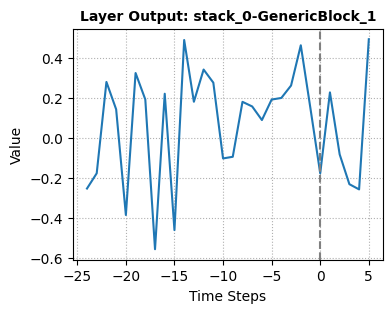

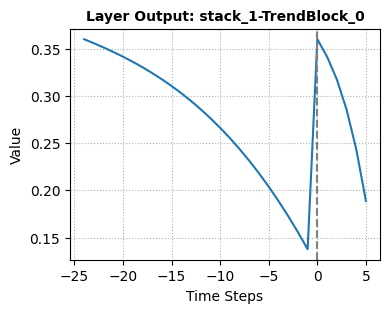

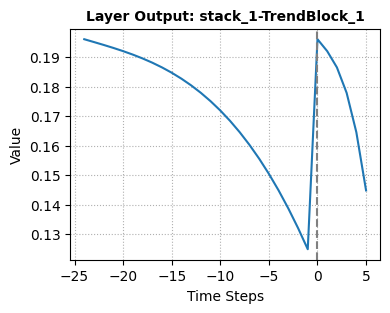

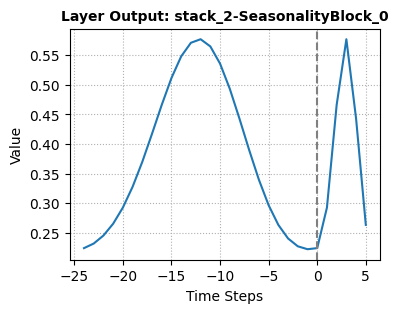

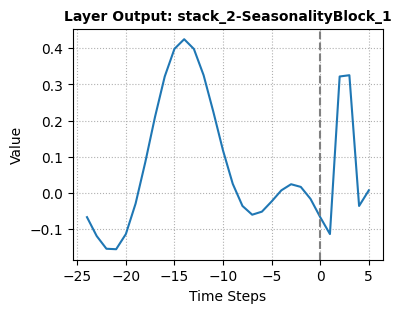

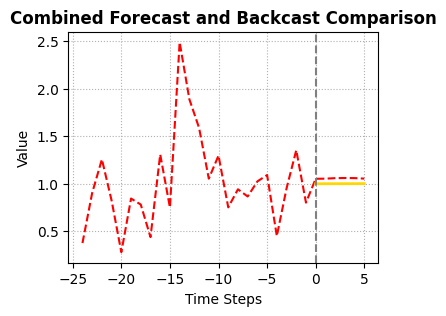

Epoch = 501, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 502, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 503, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 504, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 505, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 506, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 507, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 508, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 509, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 510, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 511, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 512, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 513, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 514, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 515, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 516, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 517, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 518, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 519, Train Loss = 0.0001, Test Loss = 

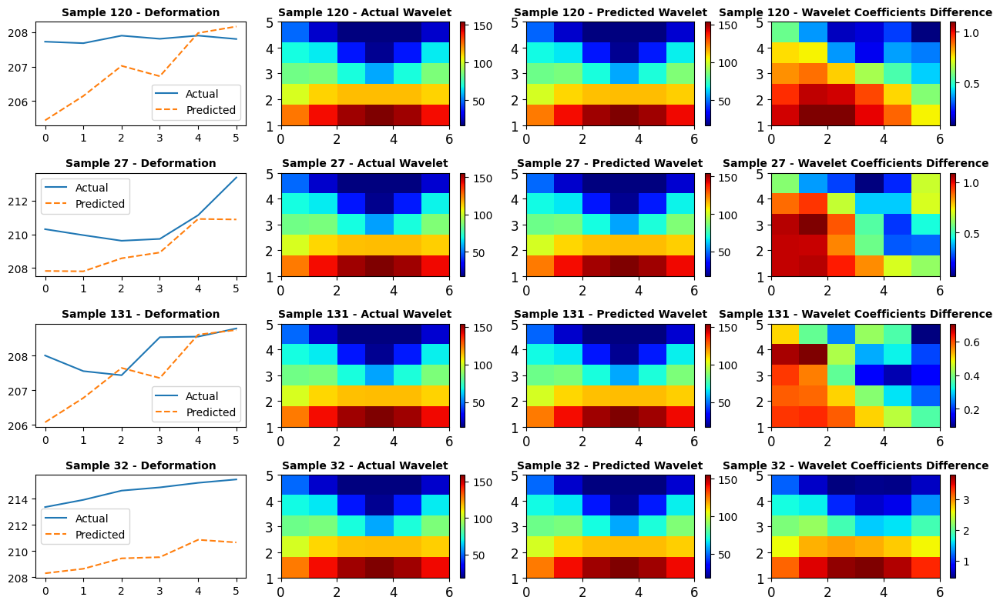

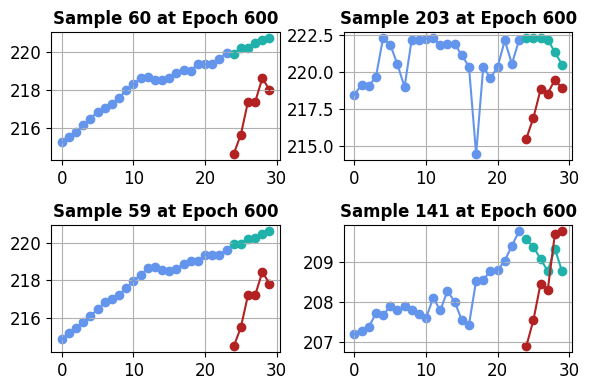

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.08392843,  0.40925172,  0.34256458,  0.02859689, -0.0424007 ,
       -0.3107793 , -0.38135028, -0.13862248, -0.20219661, -0.19040917,
        0.5307937 ,  0.25522307, -0.12369488, -0.46283013,  0.3029428 ,
       -0.09000821, -0.05491756, -0.01155438,  0.2728638 ,  0.26599002,
       -0.35714984,  0.1125789 ,  0.35901752,  0.18314447], dtype=float32), 'forecast': array([ 0.51482046,  0.11022502, -0.15291108, -0.07427144,  0.50232255,
       -0.04599123], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.2481514 , -0.17621484,  0.28010854,  0.14515151, -0.3856893 ,
        0.32547712,  0.19784509, -0.55273014,  0.22408846, -0.458269  ,
        0.49119237,  0.18217345,  0.33977085,  0.2863505 , -0.10237268,
       -0.08824393,  0.18416494,  0.16009535,  0.08870921,  0.19312431,
        0.20596057,  0.26286516,  0.4622347 ,  0.14744776], dtype=float32), 'forecast': array([-0.17759217,  0.23407744, -0.0

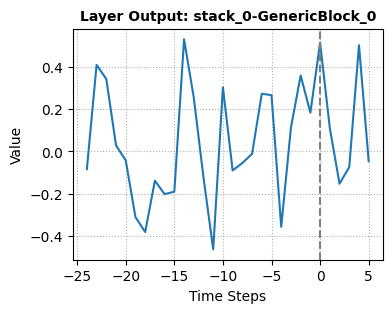

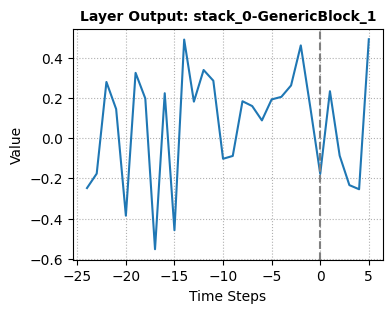

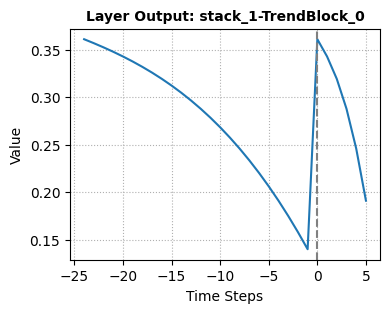

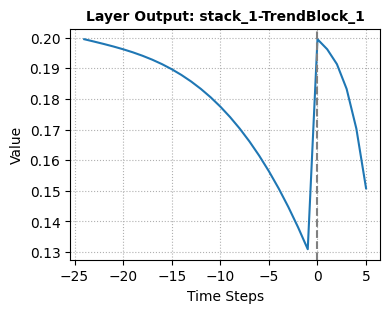

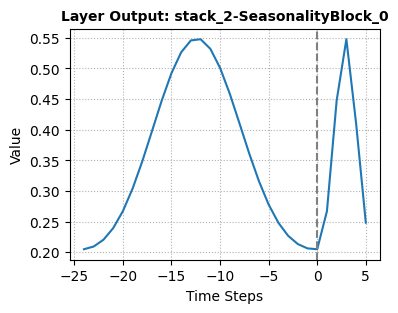

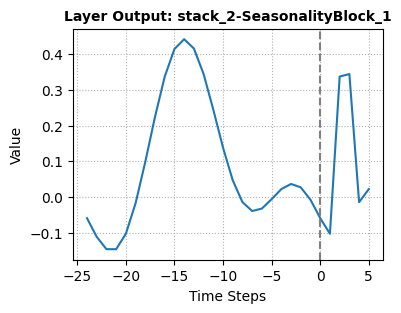

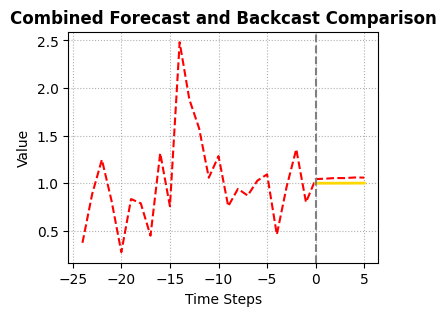

Epoch = 601, Train Loss = 0.0003, Test Loss = 0.0003
Epoch = 602, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 603, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 604, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 605, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 606, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 607, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 608, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 609, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 610, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 611, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 612, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 613, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 614, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 615, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 616, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 617, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 618, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 619, Train Loss = 0.0002, Test Loss = 

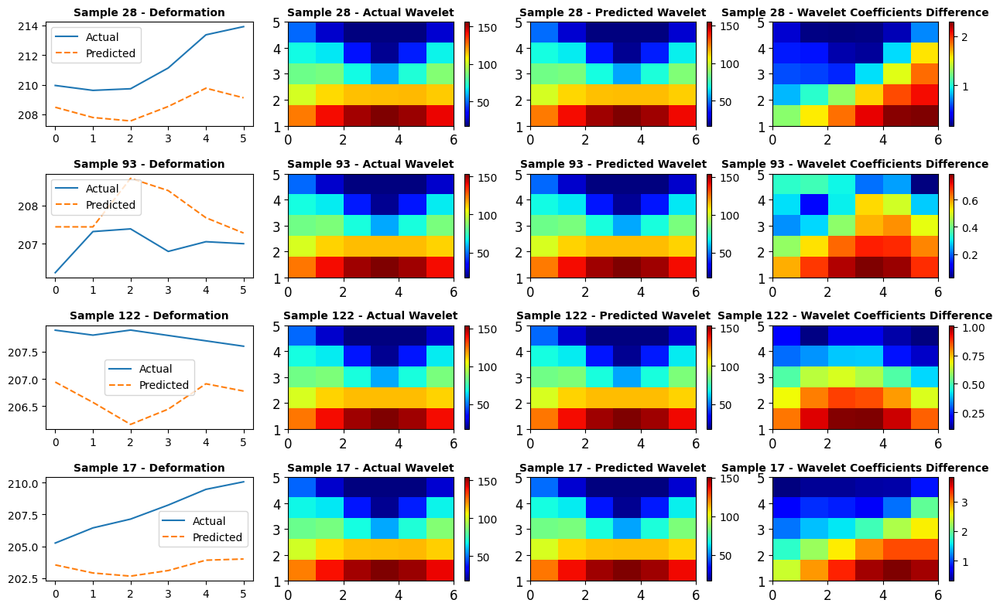

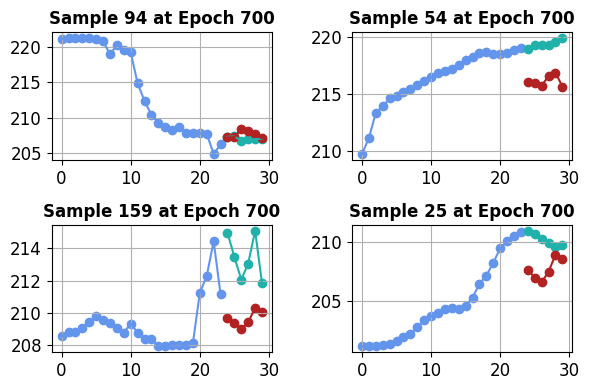

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.08603685,  0.401958  ,  0.35138282,  0.03482928, -0.04017395,
       -0.31480187, -0.37434903, -0.12536266, -0.19832036, -0.19063053,
        0.5181231 ,  0.25313738, -0.1188873 , -0.4605672 ,  0.30295748,
       -0.079116  , -0.04760859, -0.00997368,  0.26998457,  0.26569545,
       -0.36184633,  0.1148769 ,  0.3634985 ,  0.17702618], dtype=float32), 'forecast': array([ 0.5124931 ,  0.11096431, -0.15153456, -0.07796827,  0.49619186,
       -0.04144281], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.25007957, -0.17081998,  0.28139344,  0.14816229, -0.38344318,
        0.33471504,  0.20012364, -0.545042  ,  0.2202216 , -0.4408941 ,
        0.48803914,  0.1696436 ,  0.34819093,  0.2925587 , -0.08573446,
       -0.06891452,  0.2016294 ,  0.15779263,  0.07573368,  0.19411951,
        0.21109314,  0.26975703,  0.4517872 ,  0.15365508], dtype=float32), 'forecast': array([-0.18380815,  0.23934767, -0.0

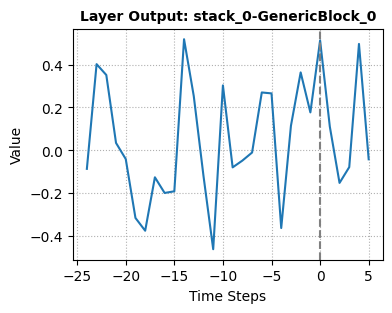

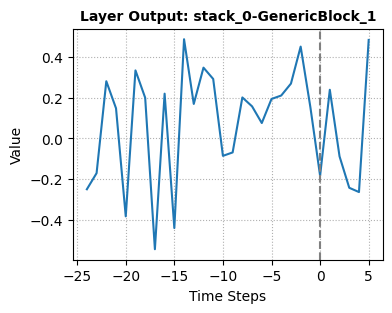

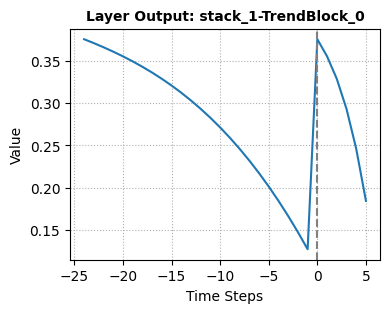

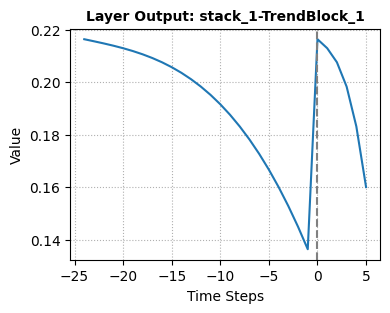

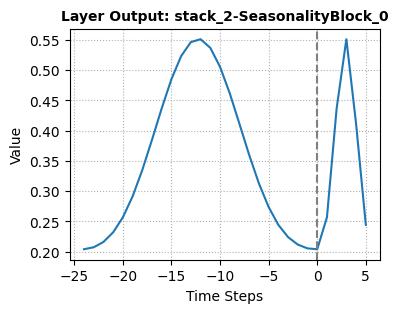

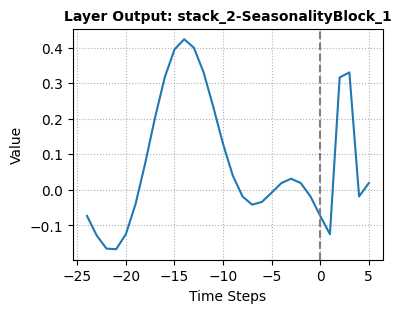

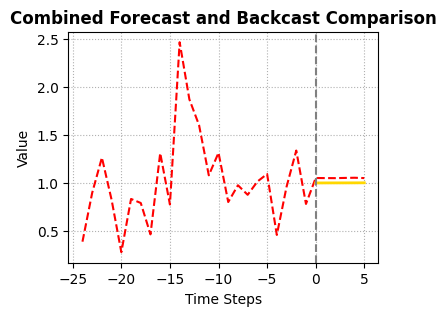

Epoch = 701, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 702, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 703, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 704, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 705, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 706, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 707, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 708, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 709, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 710, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 711, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 712, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 713, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 714, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 715, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 716, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 717, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 718, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 719, Train Loss = 0.0003, Test Loss = 

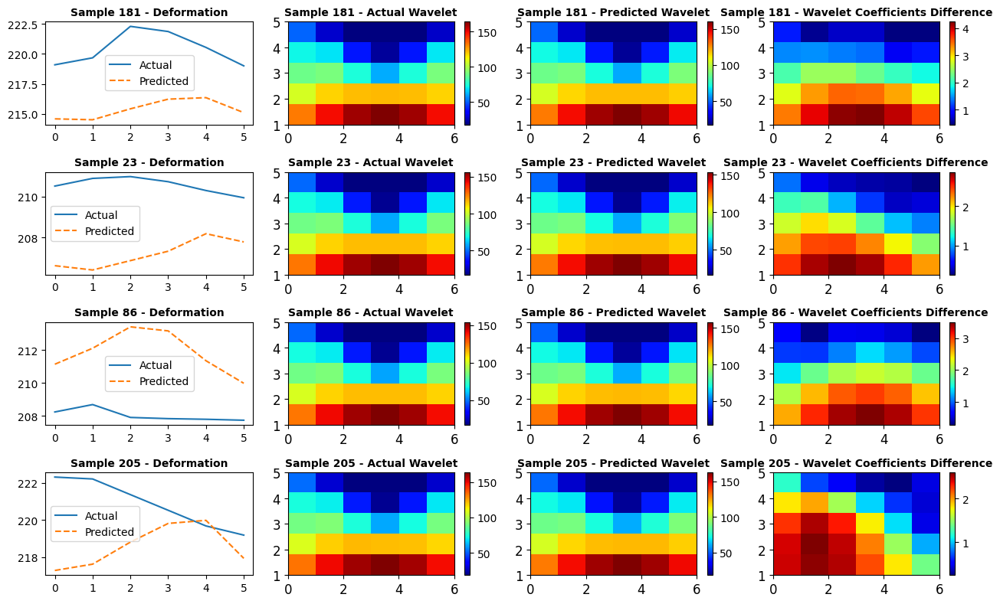

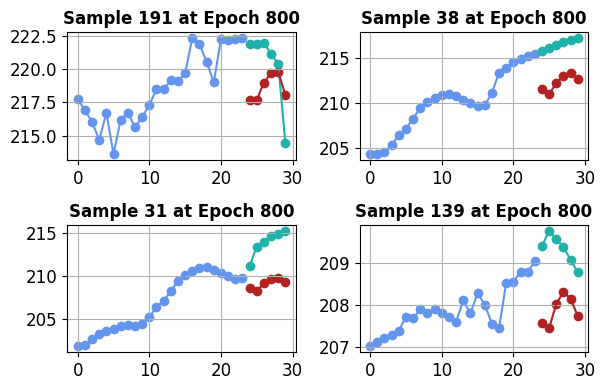

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.0844212 ,  0.3999076 ,  0.35403648,  0.03748647, -0.0401658 ,
       -0.3129993 , -0.37100473, -0.11948628, -0.19302024, -0.18817483,
        0.51422554,  0.2524505 , -0.11979082, -0.4564411 ,  0.3039689 ,
       -0.07652087, -0.04682219, -0.00695636,  0.26973808,  0.26410753,
       -0.36280665,  0.11368018,  0.36508888,  0.17731355], dtype=float32), 'forecast': array([ 0.51284564,  0.10782696, -0.15219472, -0.07822693,  0.49774373,
       -0.04083011], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.2518314 , -0.16750349,  0.27896807,  0.14824429, -0.38559657,
        0.34052286,  0.2037265 , -0.53869927,  0.21880278, -0.43127897,
        0.48643702,  0.16349487,  0.34725466,  0.2990478 , -0.07590897,
       -0.05971116,  0.21309453,  0.15928203,  0.07127526,  0.19637048,
        0.21841687,  0.27338064,  0.4440516 ,  0.15809093], dtype=float32), 'forecast': array([-0.18732966,  0.24136183, -0.0

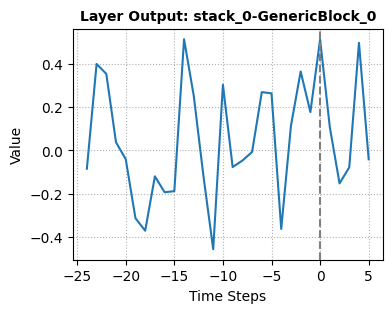

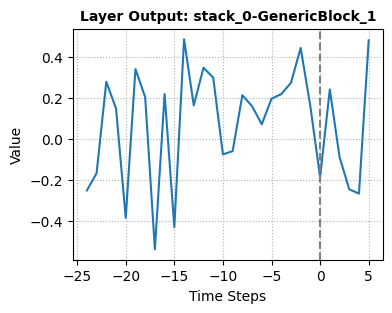

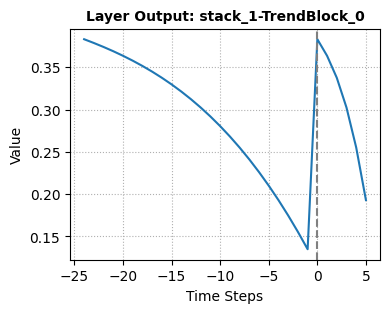

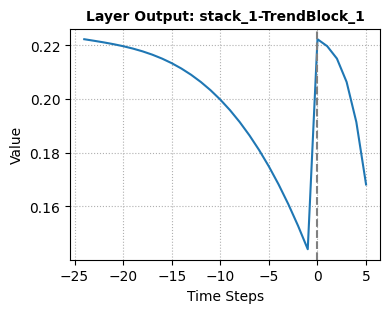

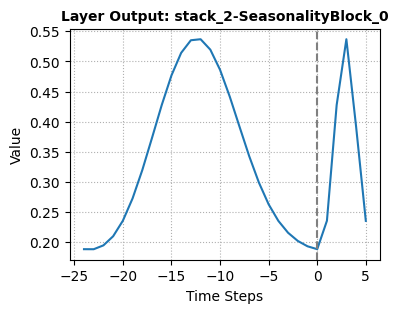

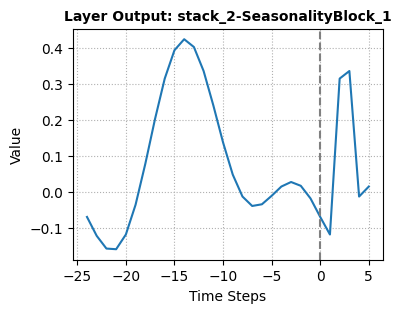

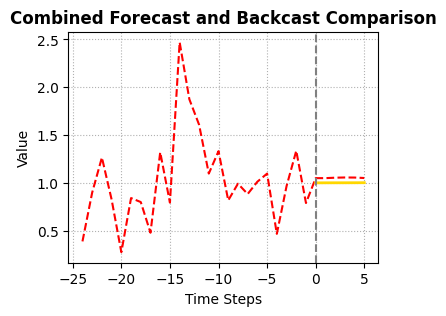

Epoch = 801, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 802, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 803, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 804, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 805, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 806, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 807, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 808, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 809, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 810, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 811, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 812, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 813, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 814, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 815, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 816, Train Loss = 0.0004, Test Loss = 0.0002
Epoch = 817, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 818, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 819, Train Loss = 0.0004, Test Loss = 

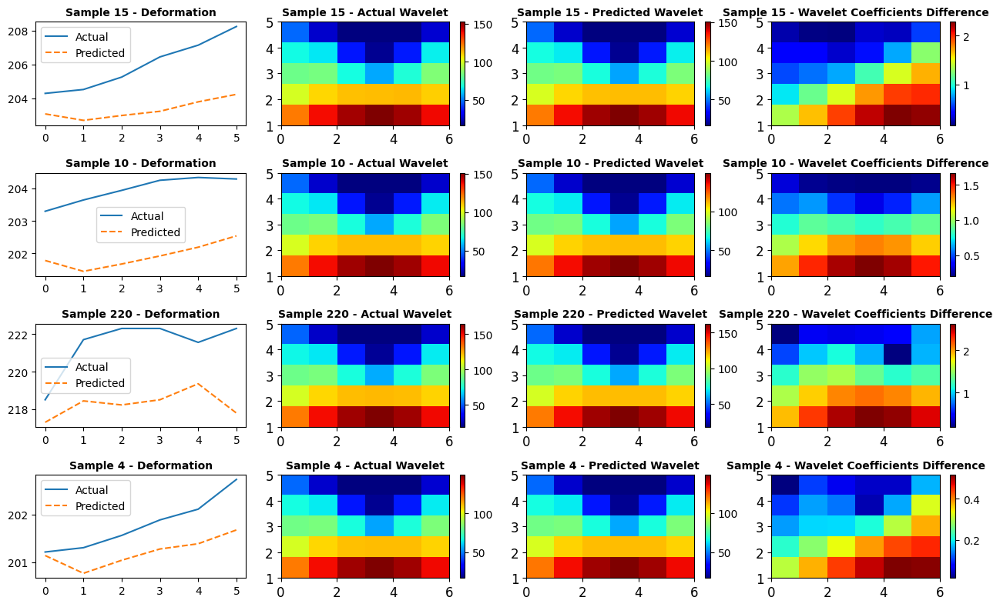

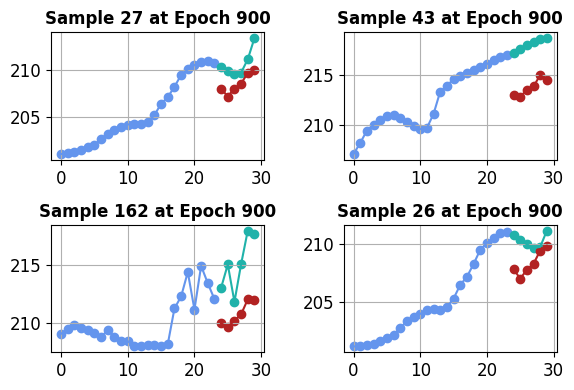

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.08015477,  0.3979675 ,  0.35736188,  0.03903943, -0.03692203,
       -0.3101901 , -0.3672653 , -0.11307123, -0.19126649, -0.18410353,
        0.5101271 ,  0.2502297 , -0.12067347, -0.4550564 ,  0.30384773,
       -0.07706328, -0.04778123, -0.00250796,  0.26892307,  0.26054722,
       -0.36350623,  0.1123404 ,  0.3670418 ,  0.17871958], dtype=float32), 'forecast': array([ 0.5142187 ,  0.10173286, -0.15560791, -0.07544844,  0.5048923 ,
       -0.04427158], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.2541978 , -0.16042304,  0.27616808,  0.14804232, -0.38566127,
        0.34880972,  0.20938   , -0.5292833 ,  0.20768818, -0.418847  ,
        0.48380613,  0.15443155,  0.34710947,  0.30342215, -0.06364914,
       -0.0526409 ,  0.22787881,  0.16069894,  0.06379266,  0.20013349,
        0.22824363,  0.2801114 ,  0.43370712,  0.16524474], dtype=float32), 'forecast': array([-0.19485301,  0.24930036, -0.0

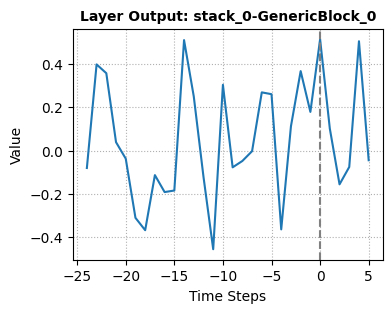

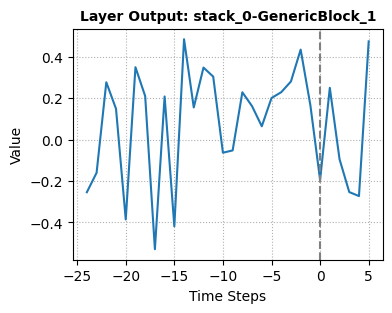

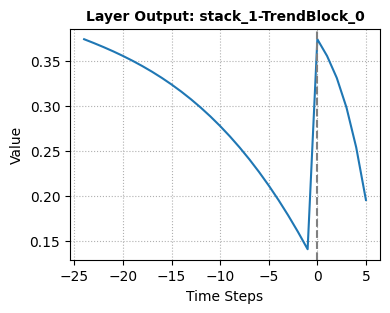

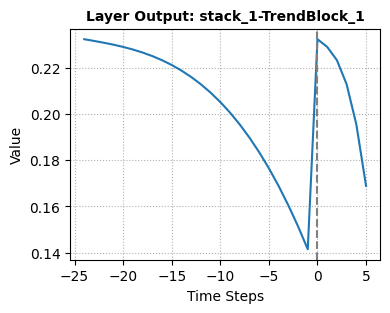

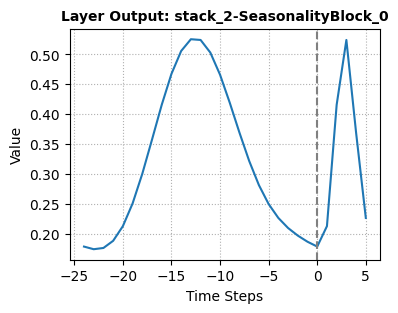

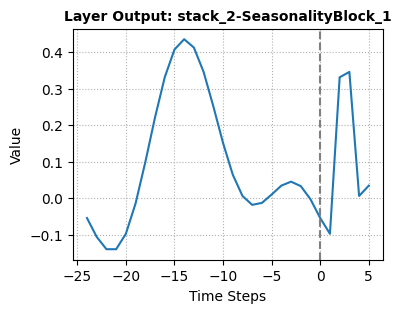

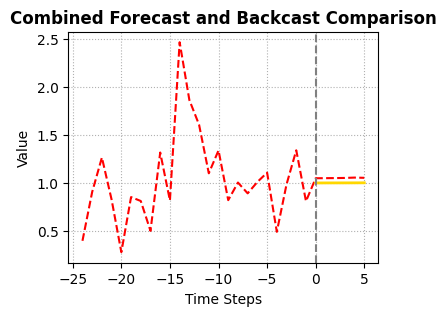

Epoch = 901, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 902, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 903, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 904, Train Loss = 0.0003, Test Loss = 0.0003
Epoch = 905, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 906, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 907, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 908, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 909, Train Loss = 0.0004, Test Loss = 0.0003
Epoch = 910, Train Loss = 0.0002, Test Loss = 0.0004
Epoch = 911, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 912, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 913, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 914, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 915, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 916, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 917, Train Loss = 0.0002, Test Loss = 0.0003
Epoch = 918, Train Loss = 0.0003, Test Loss = 0.0002
Epoch = 919, Train Loss = 0.0002, Test Loss = 

In [31]:
save_dir = 'plots_K1_3B4'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

From the results at site K1_3B4, both the observed and predicted values, as well as the wavelet analysis of these values, show a high degree of consistency.

# Neural Network-Based Feature Extraction for Deformation Observations in the Site K1_2B3

In [32]:
data_rainfall_driven_K1_2B3 = data[data.Station_id=='K1_2B3'][['Horizontaldisplacement(mm)']]
data_rainfall_driven_K1_2B3

,Horizontaldisplacement(mm)
date,
2020-07-31,8.35822
2020-08-01,8.35822
2020-08-02,8.35822
2020-08-03,8.35822
2020-08-04,8.35822
...,...
2022-07-28,41.03500
2022-07-29,41.02200
2022-07-30,41.04700


In [33]:
forecast_length = 6
backcast_length = 4 * forecast_length
batch_size = 32  # greater than 4 for viz

data_rainfall_driven_K1_2B3 = data_rainfall_driven_K1_2B3.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_rainfall_driven_K1_2B3) - forecast_length):
    x.append(data_rainfall_driven_K1_2B3[epoch - backcast_length:epoch])
    y.append(data_rainfall_driven_K1_2B3[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

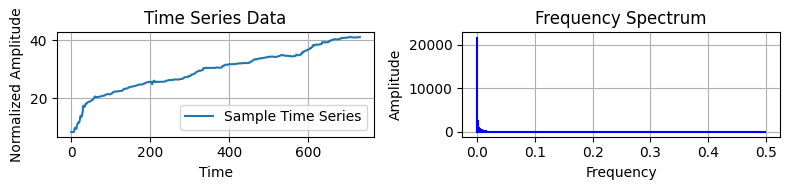

In [34]:
import numpy as np
import matplotlib.pyplot as plt
import os


sample_x = data_rainfall_driven_K1_2B3

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_K1_2B3.pdf'))
plt.show()


| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138143711468256
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138143711468592
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138143711468208
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138143711472240
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138143711472096
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138143711468064


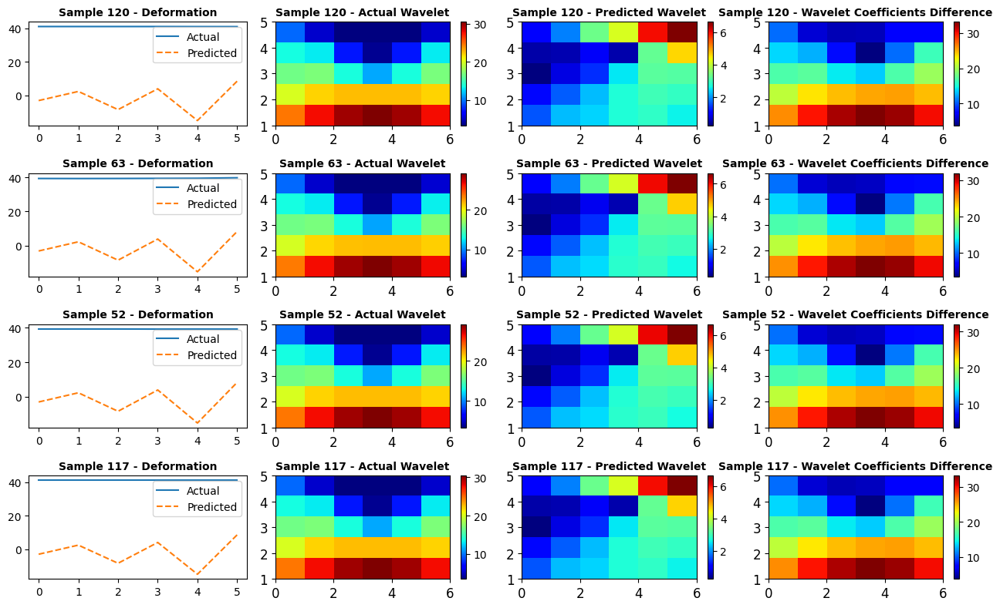

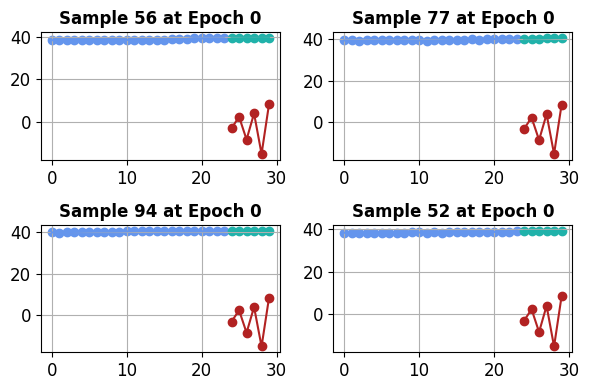

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.43460187, -0.19723392,  0.20619701, -0.2629034 ,  0.03851109,
       -0.1788787 , -0.17019783, -0.06313964, -0.21422702, -0.39639452,
       -0.19265123,  0.06360777,  0.1899482 ,  0.5074677 , -0.00770893,
       -0.26049912, -0.00740505,  0.03366332,  0.10072888, -0.43318588,
       -0.51378214,  0.51469594, -0.32854816,  0.3944129 ], dtype=float32), 'forecast': array([ 0.18001188, -0.09841657,  0.22342359, -0.0342504 , -0.37265617,
       -0.34447166], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.0415687 , -0.11009577,  0.2763008 ,  0.22963785, -0.20818052,
        0.12317873, -0.4889152 , -0.40085587,  0.15195774, -0.18007527,
       -0.3864639 , -0.41330928, -0.4767475 , -0.30723763,  0.16576478,
        0.18781526,  0.15011846, -0.22613217, -0.27654538,  0.35403916,
        0.37353325,  0.26934   ,  0.18010946, -0.24945869], dtype=float32), 'forecast': array([-0.4664107 ,  0.20461716, -0.4

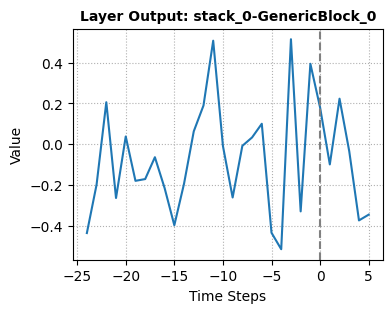

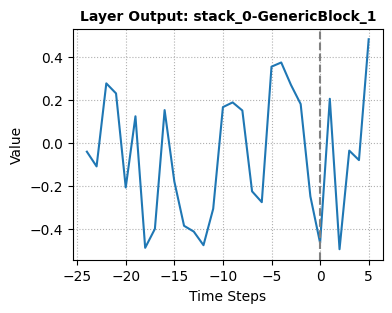

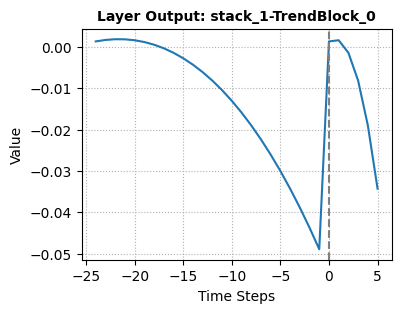

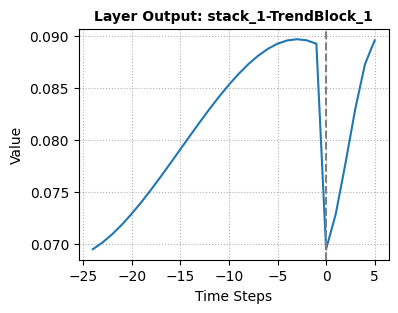

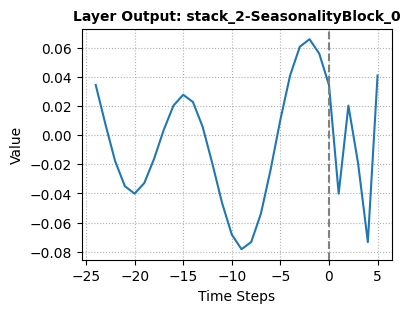

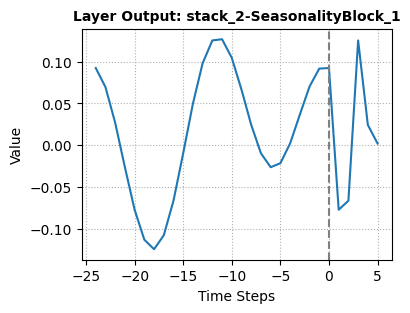

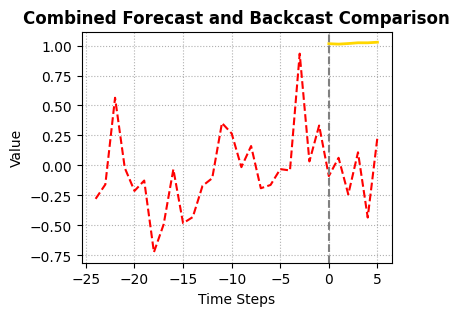

Epoch = 1, Train Loss = 0.9485, Test Loss = 1.4435
Epoch = 2, Train Loss = 0.7480, Test Loss = 1.1747
Epoch = 3, Train Loss = 0.5827, Test Loss = 0.9436
Epoch = 4, Train Loss = 0.4468, Test Loss = 0.7497
Epoch = 5, Train Loss = 0.3355, Test Loss = 0.5818
Epoch = 6, Train Loss = 0.2444, Test Loss = 0.4359
Epoch = 7, Train Loss = 0.1715, Test Loss = 0.3155
Epoch = 8, Train Loss = 0.1167, Test Loss = 0.2213
Epoch = 9, Train Loss = 0.0771, Test Loss = 0.1469
Epoch = 10, Train Loss = 0.0512, Test Loss = 0.0956
Epoch = 11, Train Loss = 0.0374, Test Loss = 0.0649
Epoch = 12, Train Loss = 0.0299, Test Loss = 0.0476
Epoch = 13, Train Loss = 0.0245, Test Loss = 0.0371
Epoch = 14, Train Loss = 0.0196, Test Loss = 0.0298
Epoch = 15, Train Loss = 0.0151, Test Loss = 0.0242
Epoch = 16, Train Loss = 0.0112, Test Loss = 0.0200
Epoch = 17, Train Loss = 0.0082, Test Loss = 0.0173
Epoch = 18, Train Loss = 0.0061, Test Loss = 0.0158
Epoch = 19, Train Loss = 0.0047, Test Loss = 0.0151
Epoch = 20, Train Los

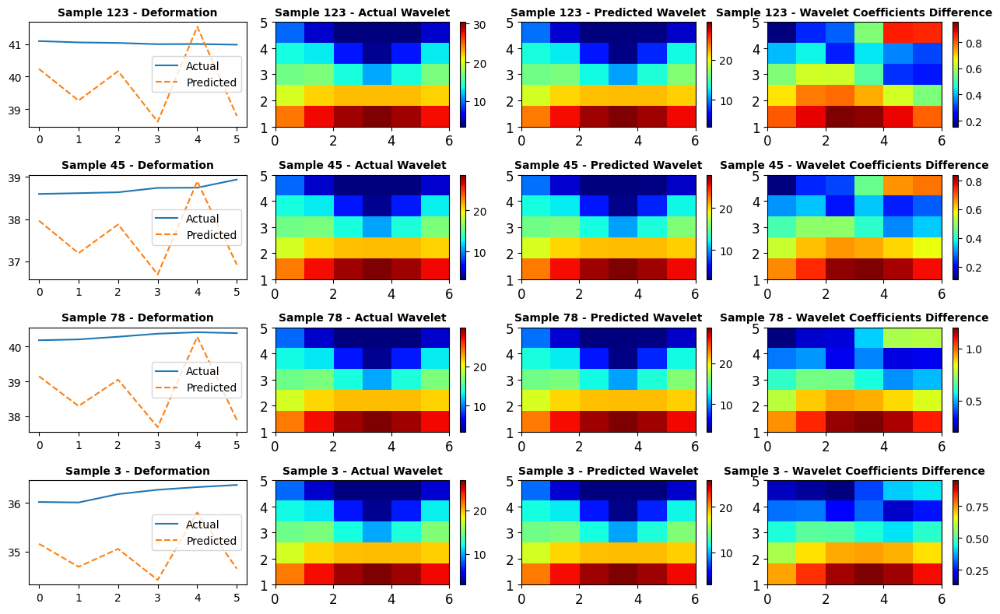

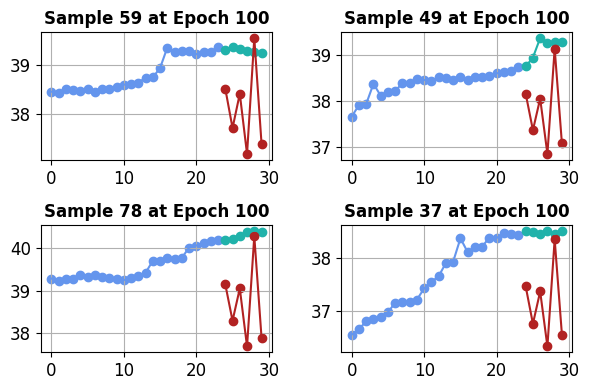

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.50515795, -0.13757785,  0.17418571, -0.24518877,  0.03383632,
       -0.22556946, -0.27254736, -0.01240849, -0.28261894, -0.35075366,
       -0.30468997,  0.1287497 ,  0.10166079,  0.5352769 ,  0.01937519,
       -0.33039042,  0.01811556, -0.0110506 ,  0.11831818, -0.42998558,
       -0.581587  ,  0.6416427 , -0.28111175,  0.30439654], dtype=float32), 'forecast': array([ 0.26692915, -0.09871808,  0.29077935,  0.08353274, -0.32972986,
       -0.34863558], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.10954191, -0.0606324 ,  0.30642068,  0.42508176, -0.16478021,
        0.14164487, -0.61178076, -0.6640788 ,  0.06988323, -0.20389083,
       -0.4463606 , -0.4347423 , -0.4689094 , -0.21085459,  0.06220056,
        0.3753977 ,  0.24786036, -0.02049719, -0.13404317,  0.39515343,
        0.5393088 ,  0.3712413 ,  0.33896828, -0.25556841], dtype=float32), 'forecast': array([-0.05052883,  0.17696719, -0.2

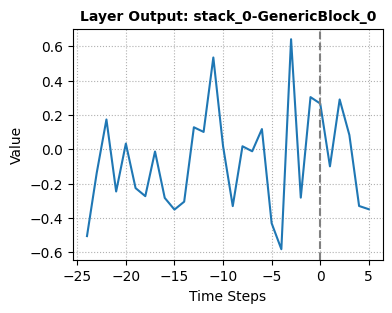

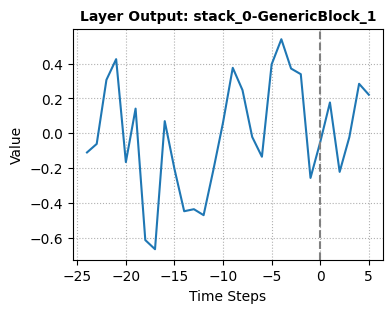

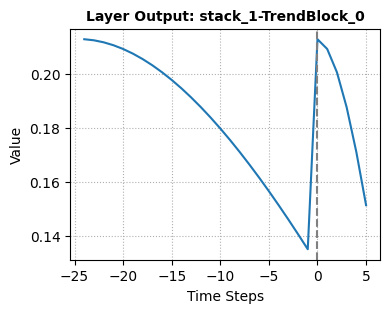

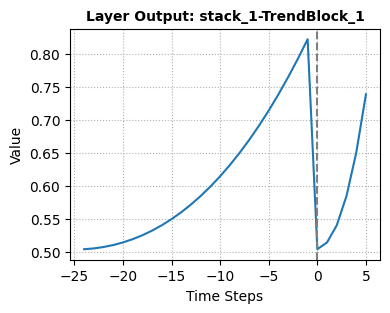

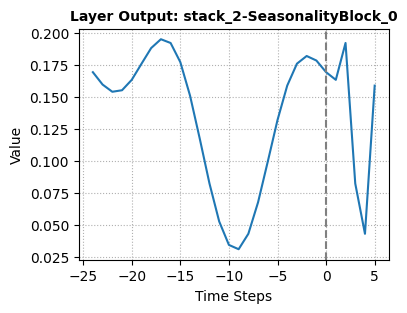

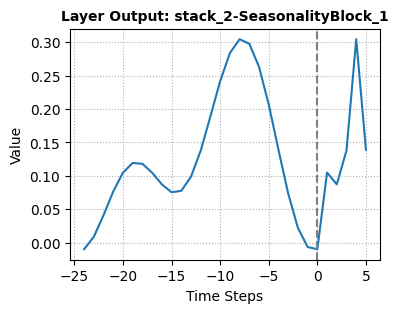

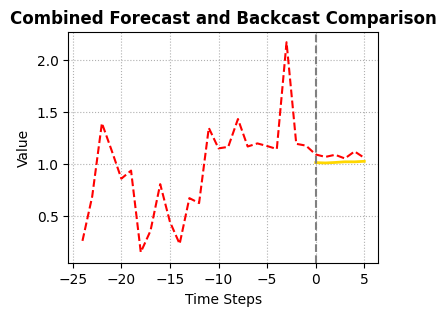

Epoch = 101, Train Loss = 0.0004, Test Loss = 0.0020
Epoch = 102, Train Loss = 0.0004, Test Loss = 0.0020
Epoch = 103, Train Loss = 0.0004, Test Loss = 0.0019
Epoch = 104, Train Loss = 0.0004, Test Loss = 0.0019
Epoch = 105, Train Loss = 0.0003, Test Loss = 0.0019
Epoch = 106, Train Loss = 0.0003, Test Loss = 0.0018
Epoch = 107, Train Loss = 0.0003, Test Loss = 0.0018
Epoch = 108, Train Loss = 0.0003, Test Loss = 0.0017
Epoch = 109, Train Loss = 0.0003, Test Loss = 0.0017
Epoch = 110, Train Loss = 0.0003, Test Loss = 0.0017
Epoch = 111, Train Loss = 0.0003, Test Loss = 0.0016
Epoch = 112, Train Loss = 0.0003, Test Loss = 0.0016
Epoch = 113, Train Loss = 0.0003, Test Loss = 0.0016
Epoch = 114, Train Loss = 0.0003, Test Loss = 0.0015
Epoch = 115, Train Loss = 0.0003, Test Loss = 0.0015
Epoch = 116, Train Loss = 0.0003, Test Loss = 0.0015
Epoch = 117, Train Loss = 0.0003, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0003, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0003, Test Loss = 

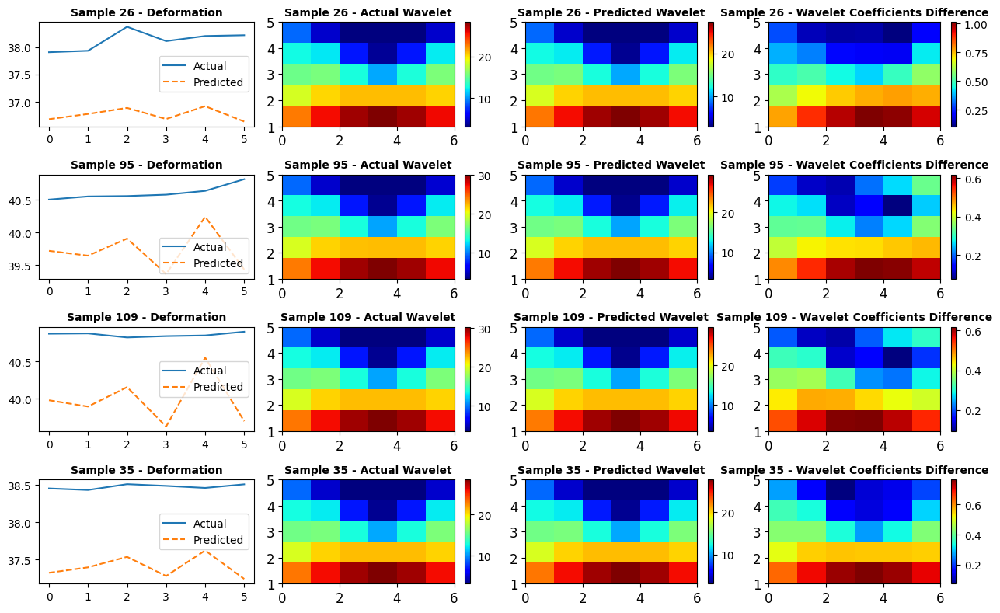

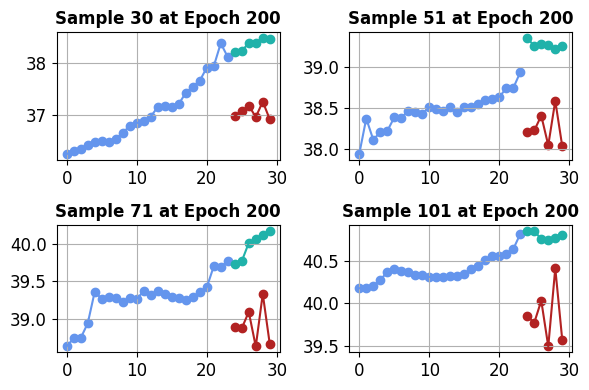

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.5097598 , -0.13434745,  0.16054857, -0.2442618 ,  0.04035667,
       -0.22565232, -0.2831713 , -0.00780223, -0.29645705, -0.34943905,
       -0.31043348,  0.13896748,  0.10334721,  0.5493884 ,  0.0211633 ,
       -0.33505547,  0.02713534, -0.01275883,  0.11689335, -0.43097955,
       -0.5914969 ,  0.6546789 , -0.27344325,  0.29601544], dtype=float32), 'forecast': array([ 0.2721875 , -0.10020107,  0.29985395,  0.1096637 , -0.32272854,
       -0.34296742], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.11439149, -0.07624228,  0.28996673,  0.39063388, -0.18437074,
        0.1568169 , -0.6017792 , -0.6316797 ,  0.08480197, -0.20345028,
       -0.4365365 , -0.44569367, -0.48103014, -0.19974054,  0.10533541,
        0.3537075 ,  0.2259776 , -0.05578625, -0.13605237,  0.4092874 ,
        0.52798194,  0.37030408,  0.30844083, -0.27127936], dtype=float32), 'forecast': array([-0.06922608,  0.1844969 , -0.2

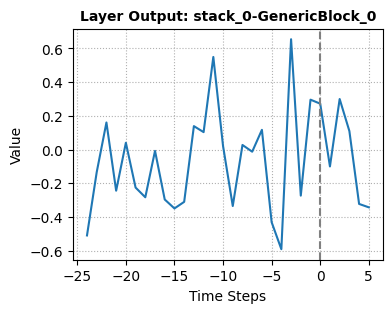

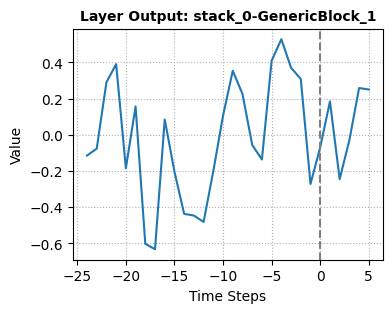

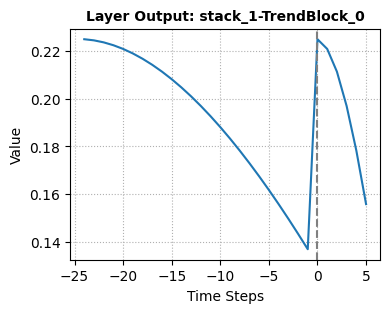

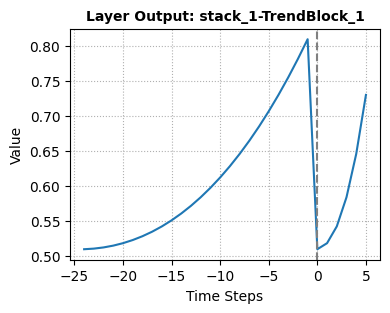

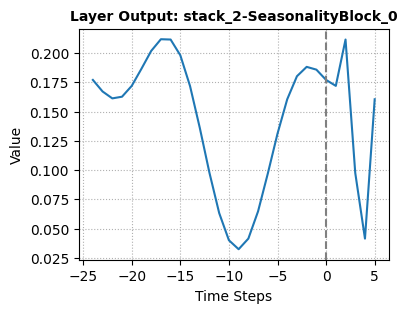

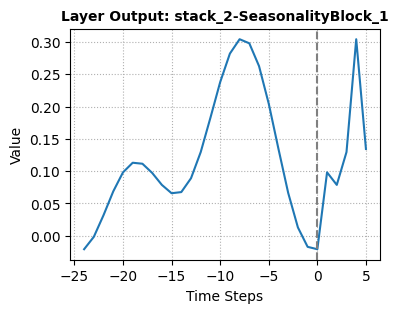

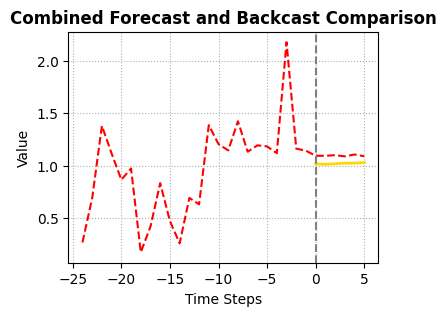

Epoch = 201, Train Loss = 0.0001, Test Loss = 0.0008
Epoch = 202, Train Loss = 0.0001, Test Loss = 0.0008
Epoch = 203, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 204, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 205, Train Loss = 0.0001, Test Loss = 0.0008
Epoch = 206, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 207, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 208, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 209, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 210, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 211, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 212, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 213, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 214, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 215, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 216, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 217, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 218, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 219, Train Loss = 0.0001, Test Loss = 

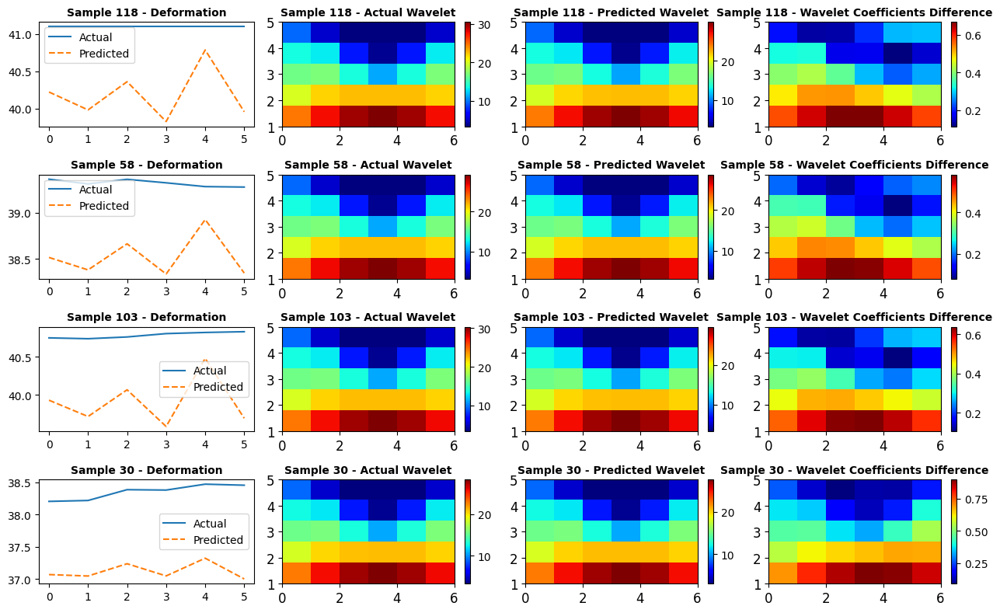

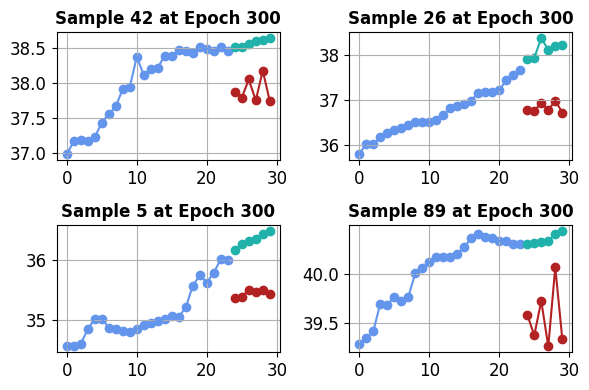

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.51235026, -0.12741815,  0.15616769, -0.24123853,  0.04074079,
       -0.2261982 , -0.29124138, -0.00593973, -0.2985207 , -0.3477253 ,
       -0.31410846,  0.14270398,  0.09982442,  0.5521738 ,  0.02305446,
       -0.3392198 ,  0.03019931, -0.01676801,  0.11451136, -0.43178937,
       -0.5964758 ,  0.66040444, -0.26909873,  0.29016358], dtype=float32), 'forecast': array([ 0.27610573, -0.10467928,  0.30306545,  0.11365474, -0.32252875,
       -0.34334642], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.11190163, -0.07514406,  0.29016715,  0.38742167, -0.18719797,
        0.15741938, -0.5994098 , -0.6264971 ,  0.08877665, -0.20104077,
       -0.43368867, -0.44613865, -0.47990537, -0.20089222,  0.10981862,
        0.3475081 ,  0.22037196, -0.06323695, -0.13919115,  0.40913507,
        0.52257353,  0.36883405,  0.30339858, -0.2740812 ], dtype=float32), 'forecast': array([-0.07203577,  0.18527013, -0.2

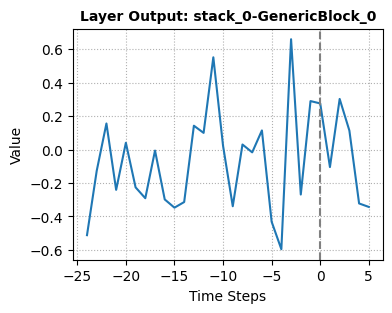

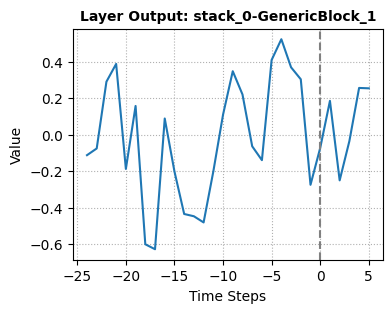

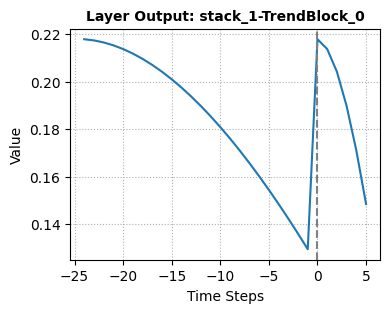

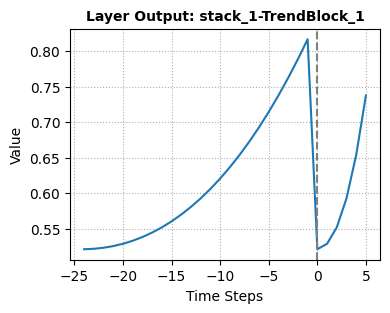

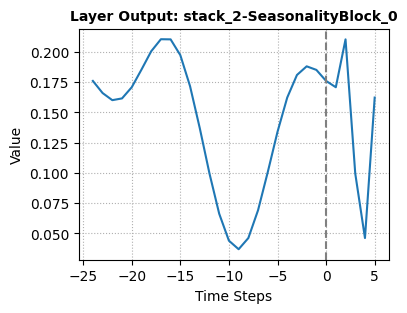

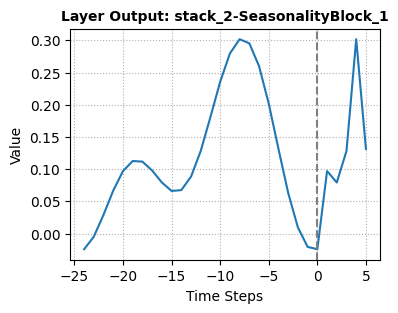

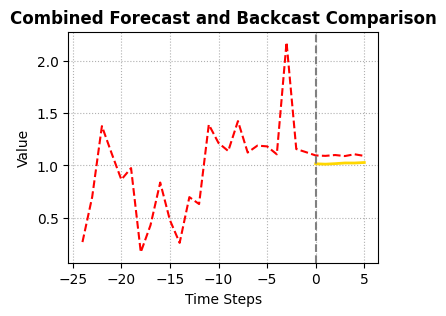

Epoch = 301, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 302, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 303, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 304, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 305, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 306, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 307, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 308, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 309, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 310, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 311, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 312, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 313, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 314, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 315, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 316, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 317, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 318, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 319, Train Loss = 0.0001, Test Loss = 

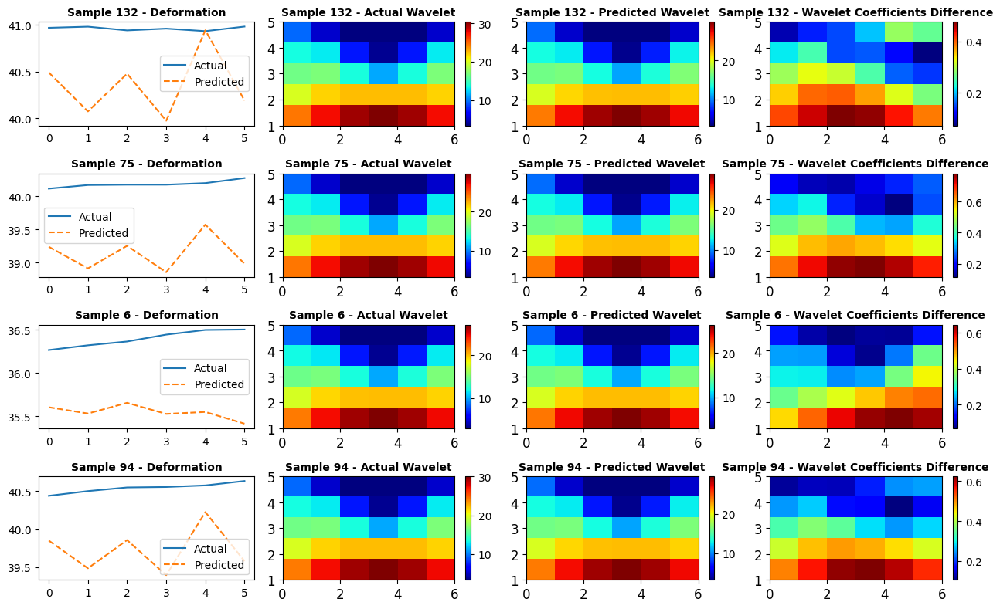

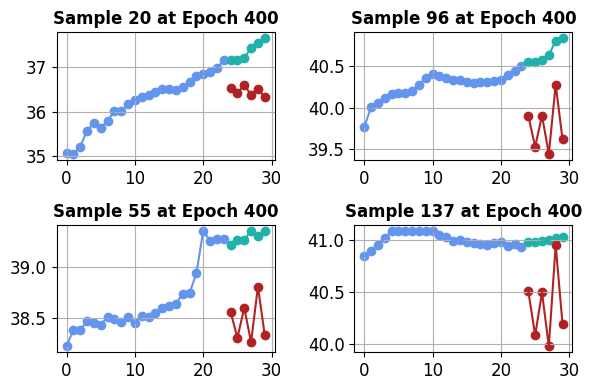

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.5125148 , -0.12161611,  0.15667443, -0.23961242,  0.03852823,
       -0.22714174, -0.29431918, -0.00550623, -0.29862818, -0.347086  ,
       -0.3160139 ,  0.14370587,  0.09753594,  0.55333346,  0.02437371,
       -0.34164578,  0.02990573, -0.01915293,  0.11386707, -0.43190834,
       -0.59800196,  0.66301835, -0.26895773,  0.28853357], dtype=float32), 'forecast': array([ 0.27933002, -0.10796788,  0.30418515,  0.11084182, -0.32344088,
       -0.34536228], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.10914012, -0.07037857,  0.2909956 ,  0.3876151 , -0.18718272,
        0.15802518, -0.5976044 , -0.6262912 ,  0.08932835, -0.19879974,
       -0.43085003, -0.44464302, -0.4784041 , -0.19969124,  0.1099217 ,
        0.34428784,  0.21765302, -0.06607843, -0.13882829,  0.40979728,
        0.52054566,  0.36820215,  0.30212668, -0.27514708], dtype=float32), 'forecast': array([-0.07992694,  0.1821971 , -0.2

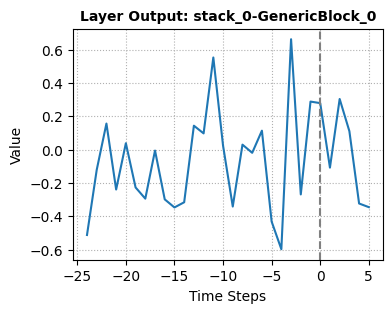

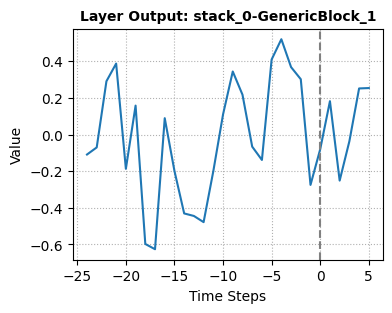

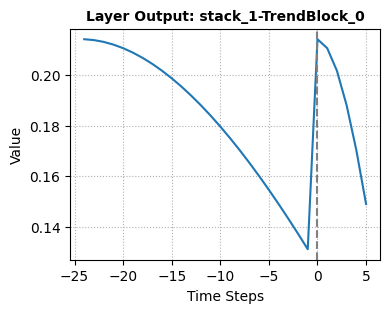

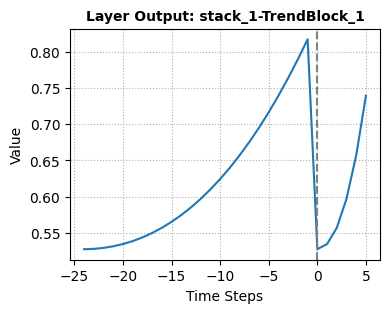

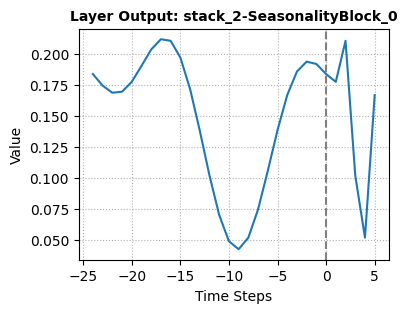

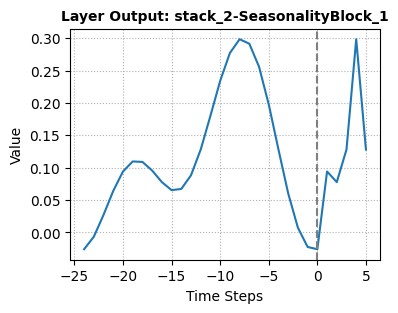

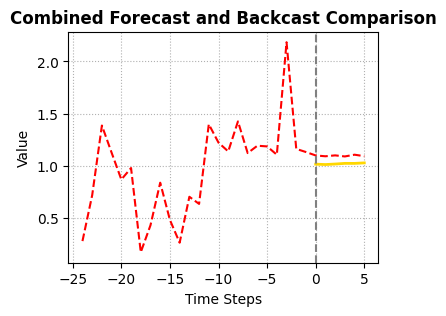

Epoch = 401, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 402, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 403, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 404, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 405, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 406, Train Loss = 0.0001, Test Loss = 0.0007
Epoch = 407, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 408, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 409, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 410, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 411, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 412, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 413, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 414, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 415, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 416, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 417, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 418, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 419, Train Loss = 0.0001, Test Loss = 

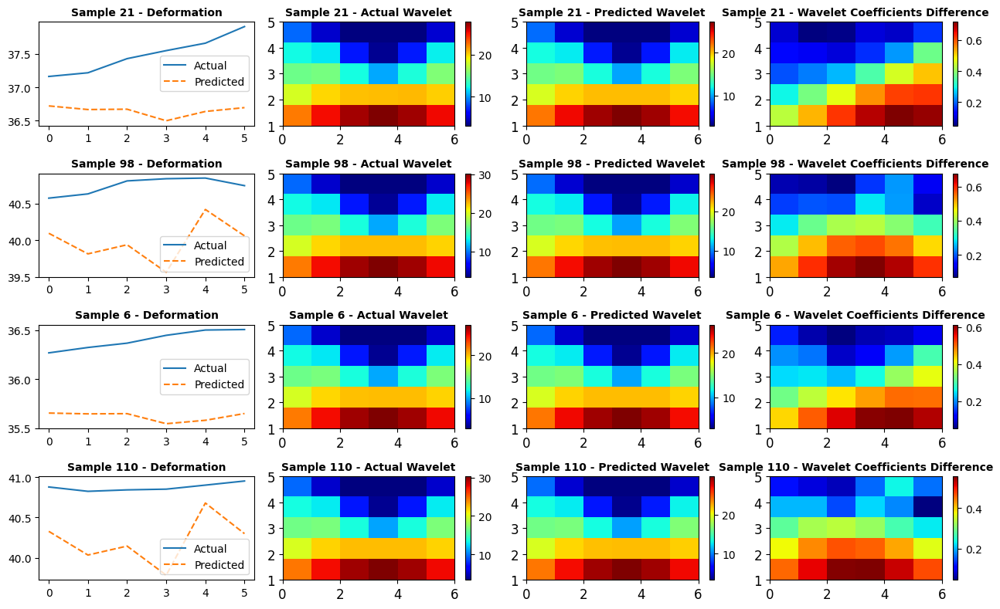

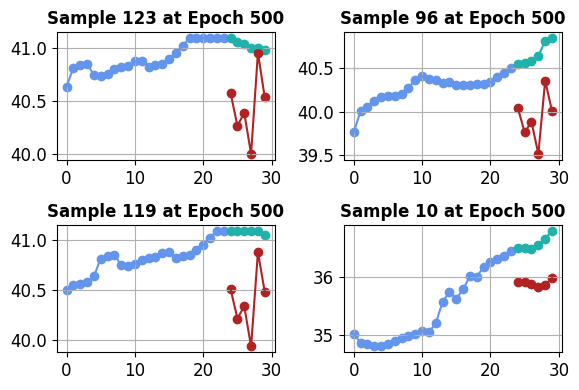

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.51216024, -0.11635825,  0.15774193, -0.23356429,  0.03645277,
       -0.229013  , -0.29766202, -0.0040928 , -0.29977033, -0.34393644,
       -0.31983912,  0.14773536,  0.09343643,  0.55409205,  0.02654319,
       -0.34374273,  0.03002139, -0.0232278 ,  0.11730264, -0.4301011 ,
       -0.6002667 ,  0.6665079 , -0.26648983,  0.28503656], dtype=float32), 'forecast': array([ 0.28139025, -0.10666318,  0.30499196,  0.11139553, -0.32164782,
       -0.34477323], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.11594733, -0.06891815,  0.27933955,  0.39171866, -0.18902484,
        0.16922542, -0.5914869 , -0.6274126 ,  0.08677363, -0.20181777,
       -0.41725022, -0.43456015, -0.4825326 , -0.19199426,  0.11947674,
        0.33610648,  0.21662708, -0.06915008, -0.1271911 ,  0.42192563,
        0.5227708 ,  0.3665696 ,  0.30721375, -0.2764678 ], dtype=float32), 'forecast': array([-0.09040769,  0.17909434, -0.2

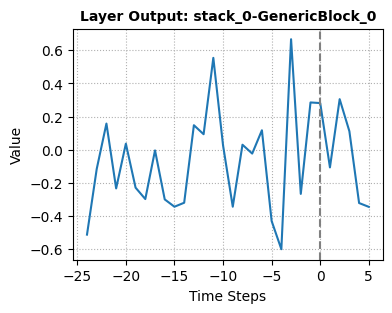

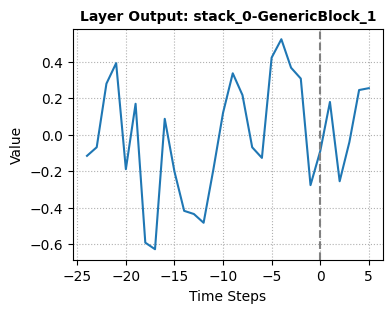

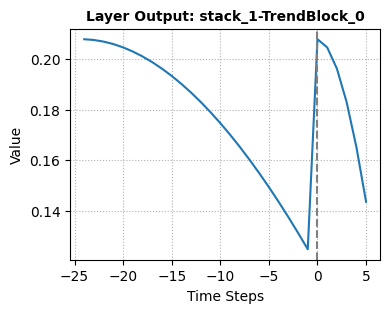

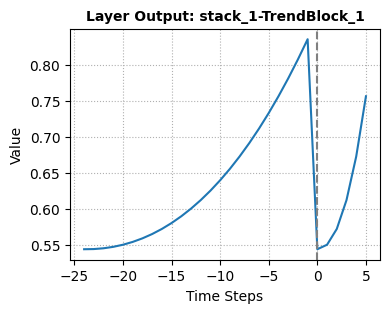

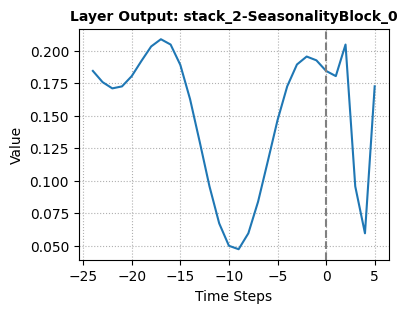

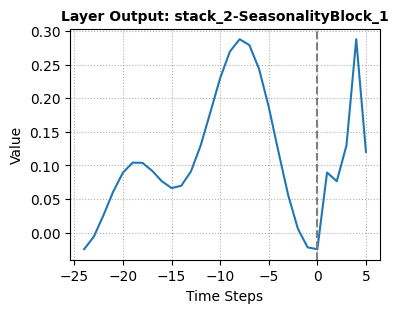

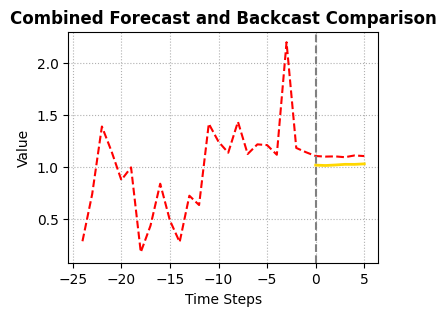

Epoch = 501, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 502, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 503, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 504, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 505, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 506, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 507, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 508, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 509, Train Loss = 0.0001, Test Loss = 0.0006
Epoch = 510, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 511, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 512, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 513, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 514, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 515, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 516, Train Loss = 0.0001, Test Loss = 0.0004
Epoch = 517, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 518, Train Loss = 0.0001, Test Loss = 0.0003
Epoch = 519, Train Loss = 0.0001, Test Loss = 

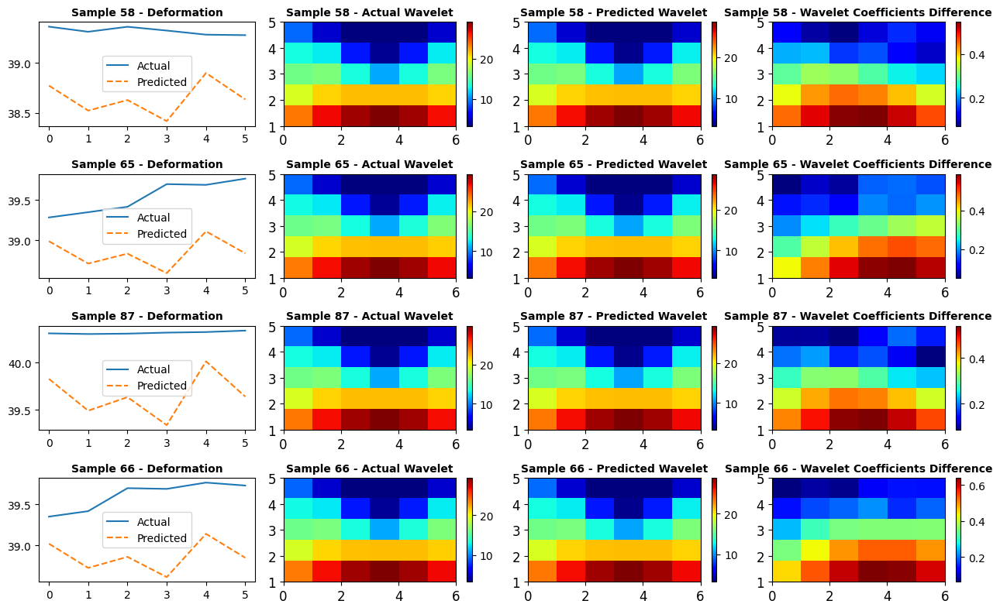

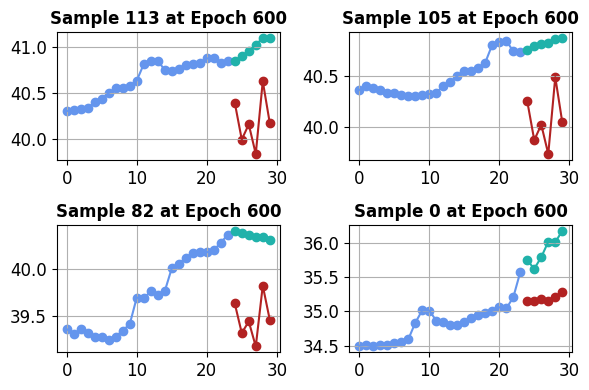

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.51057464, -0.11594605,  0.15966785, -0.22750476,  0.03397671,
       -0.23061885, -0.2973252 , -0.00360284, -0.29991624, -0.3411671 ,
       -0.32043907,  0.14970776,  0.09315825,  0.5542531 ,  0.02815235,
       -0.34503734,  0.02857984, -0.02379749,  0.11939772, -0.42913505,
       -0.6010118 ,  0.66729033, -0.26659402,  0.28492567], dtype=float32), 'forecast': array([ 0.2862701 , -0.11126959,  0.30725032,  0.1075288 , -0.32247186,
       -0.3477246 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.11742795, -0.06938355,  0.27105492,  0.39401016, -0.1906484 ,
        0.17442694, -0.5838317 , -0.6218361 ,  0.08652698, -0.201458  ,
       -0.4062886 , -0.42557132, -0.4849854 , -0.19008686,  0.1277134 ,
        0.32433563,  0.21430139, -0.07679297, -0.12307701,  0.42768985,
        0.5191586 ,  0.36301476,  0.30776015, -0.27586848], dtype=float32), 'forecast': array([-0.09682436,  0.17933887, -0.2

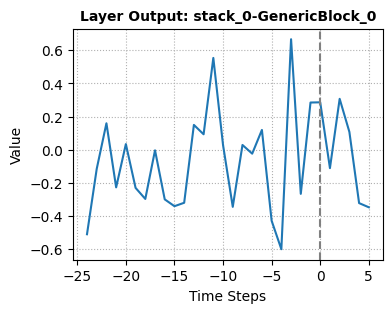

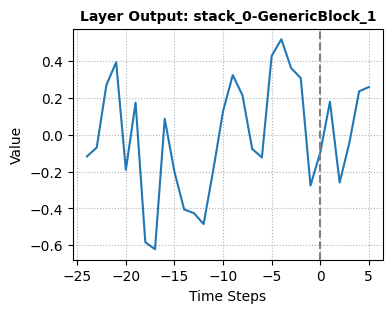

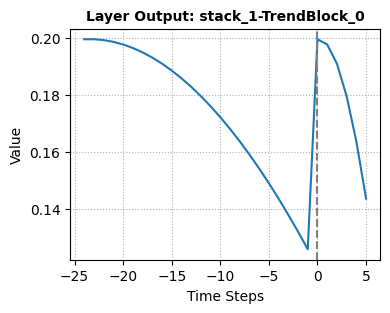

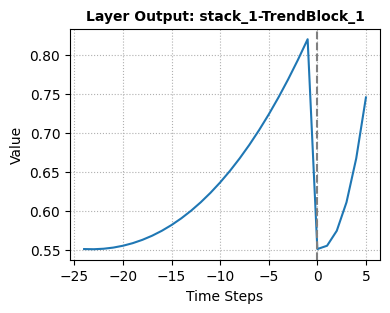

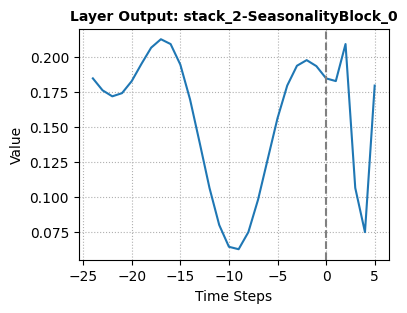

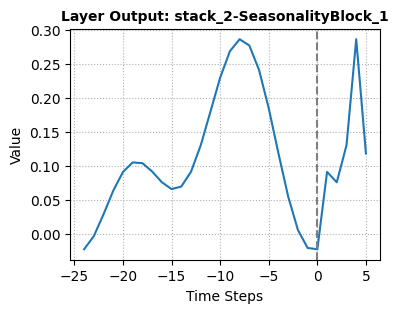

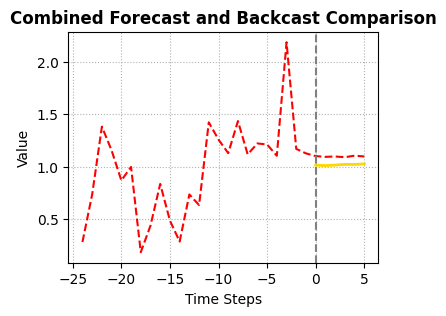

Epoch = 601, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 602, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 603, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 604, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 605, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 606, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 607, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 608, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 609, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 610, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 611, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 612, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 613, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 614, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 615, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 616, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 617, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 618, Train Loss = 0.0001, Test Loss = 0.0005
Epoch = 619, Train Loss = 0.0001, Test Loss = 

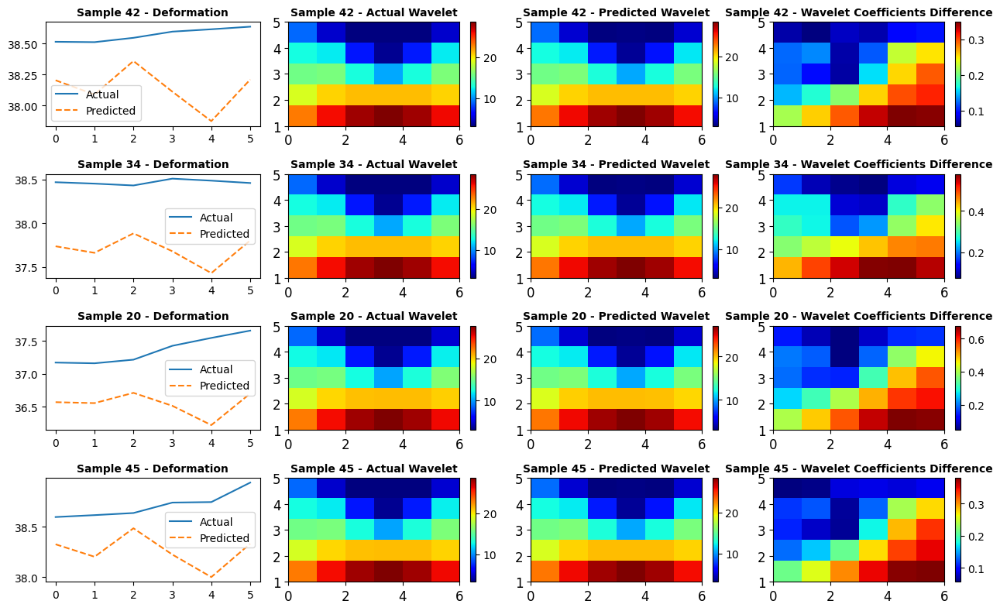

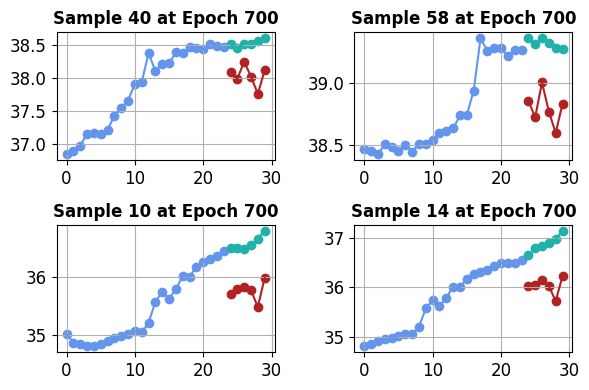

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.5083085 , -0.12043646,  0.16623294, -0.22426018,  0.03423487,
       -0.22833198, -0.28999805, -0.00714503, -0.29302466, -0.34419462,
       -0.31454244,  0.14614397,  0.09665077,  0.55052346,  0.03199235,
       -0.3422254 ,  0.02457392, -0.02243474,  0.12022617, -0.42805263,
       -0.59501797,  0.6629029 , -0.27163094,  0.2912554 ], dtype=float32), 'forecast': array([ 0.28872344, -0.11222359,  0.30657858,  0.100706  , -0.32360396,
       -0.35007107], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.11671026, -0.06518707,  0.2702057 ,  0.40147722, -0.17913185,
        0.17856099, -0.5707078 , -0.61953866,  0.0858759 , -0.20113175,
       -0.3925451 , -0.40891096, -0.47982702, -0.18967251,  0.12695442,
        0.31146023,  0.2145768 , -0.08015762, -0.1190596 ,  0.43148535,
        0.5157383 ,  0.35948423,  0.31547618, -0.2696641 ], dtype=float32), 'forecast': array([-0.1119797 ,  0.17473947, -0.2

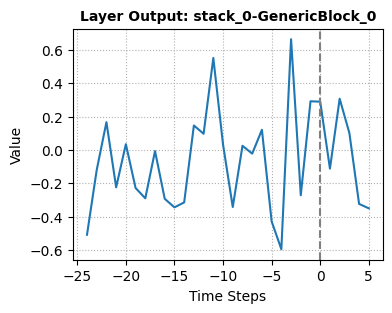

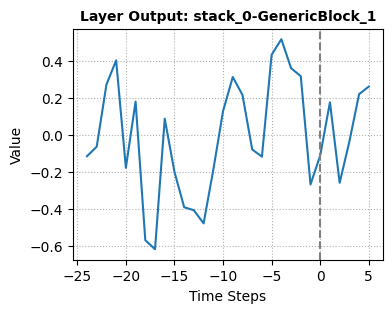

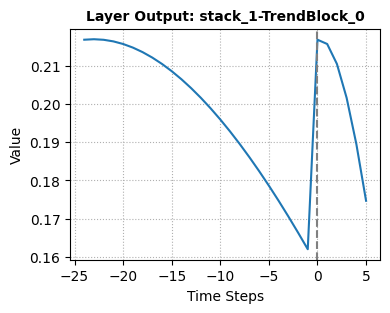

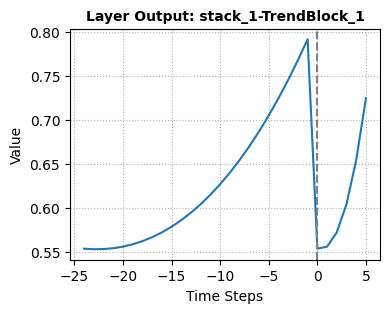

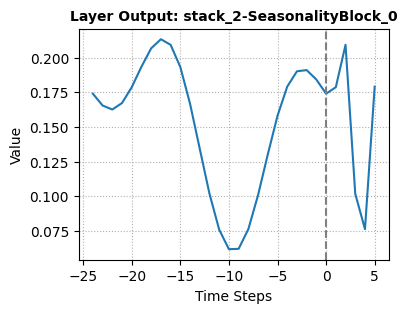

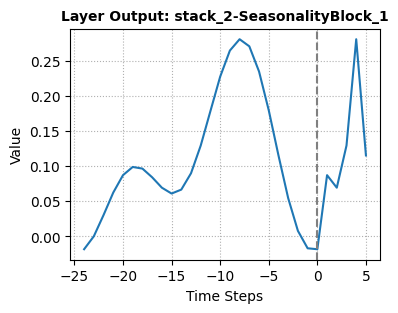

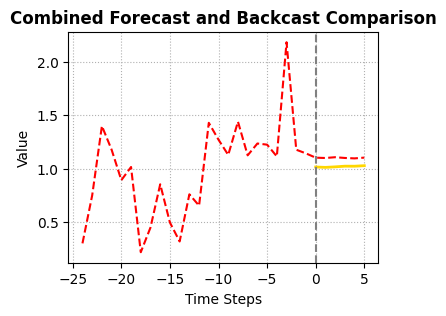

Epoch = 701, Train Loss = 0.0002, Test Loss = 0.0004
Epoch = 702, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 703, Train Loss = 0.0003, Test Loss = 0.0001
Epoch = 704, Train Loss = 0.0003, Test Loss = 0.0001
Epoch = 705, Train Loss = 0.0003, Test Loss = 0.0001
Epoch = 706, Train Loss = 0.0002, Test Loss = 0.0001
Epoch = 707, Train Loss = 0.0002, Test Loss = 0.0002
Epoch = 708, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 709, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 710, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 711, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 712, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 713, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 714, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 715, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 716, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 717, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 718, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 719, Train Loss = 0.0001, Test Loss = 

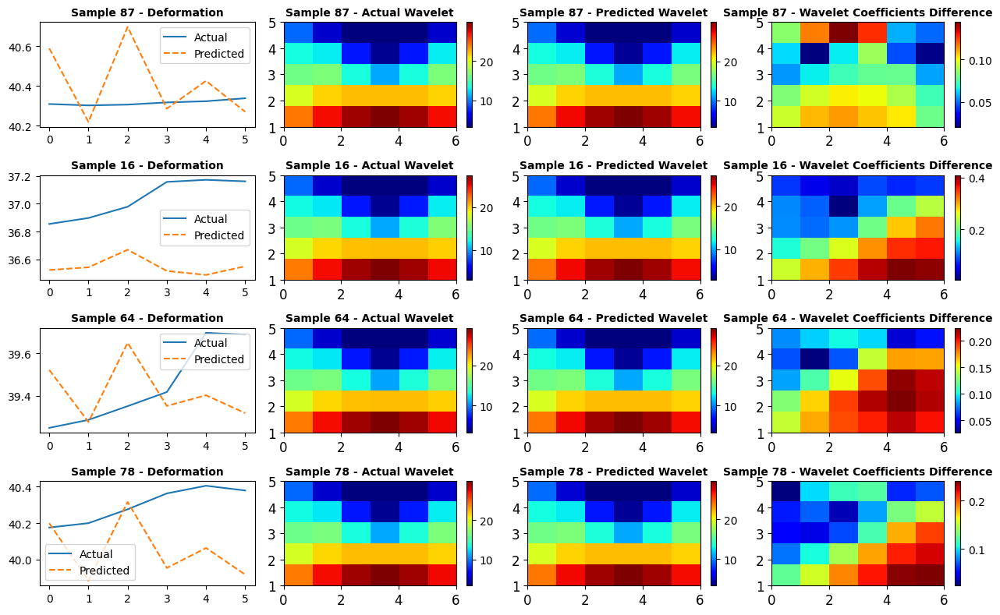

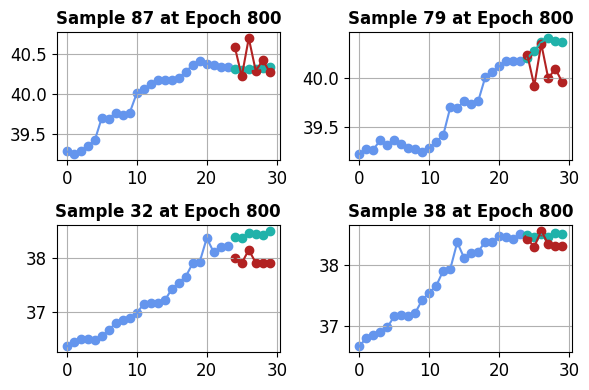

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.51160145, -0.11788528,  0.16015765, -0.22172134,  0.04005365,
       -0.22966664, -0.29399422, -0.00329295, -0.30002296, -0.34126267,
       -0.31845522,  0.1517408 ,  0.09551635,  0.55505323,  0.03072746,
       -0.34471717,  0.02944636, -0.02500144,  0.12067994, -0.4279946 ,
       -0.6006492 ,  0.66616887, -0.26657537,  0.28556398], dtype=float32), 'forecast': array([ 0.29140705, -0.11668409,  0.3098333 ,  0.10178809, -0.3234842 ,
       -0.35066193], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.12950785, -0.07317696,  0.24962161,  0.40048712, -0.18199712,
        0.18625869, -0.56986374, -0.6115379 ,  0.08241322, -0.21468334,
       -0.38475993, -0.40393063, -0.49312493, -0.18824713,  0.14190601,
        0.3018565 ,  0.21874163, -0.0893105 , -0.11613683,  0.4392942 ,
        0.515428  ,  0.35683203,  0.31614453, -0.2699204 ], dtype=float32), 'forecast': array([-0.10777505,  0.17723961, -0.2

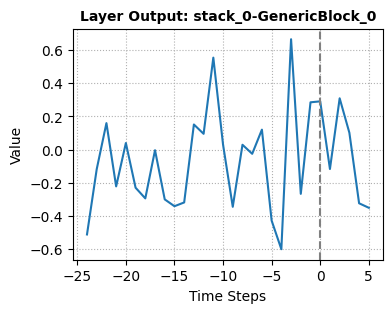

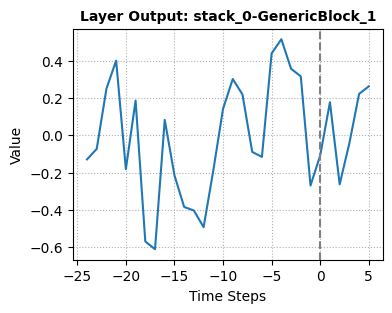

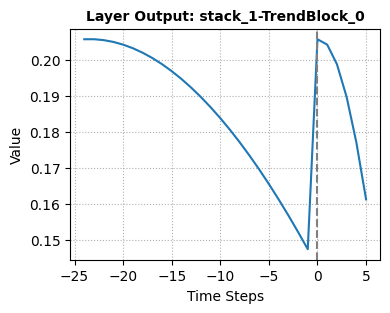

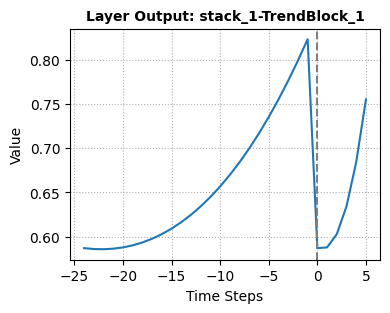

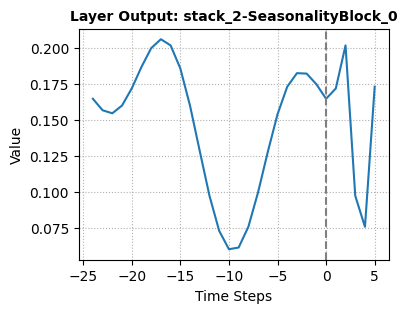

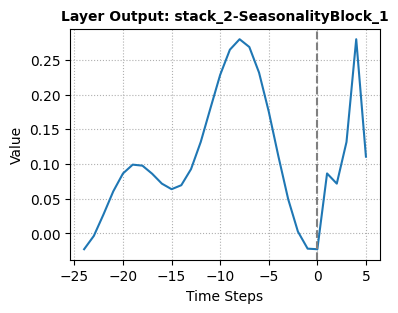

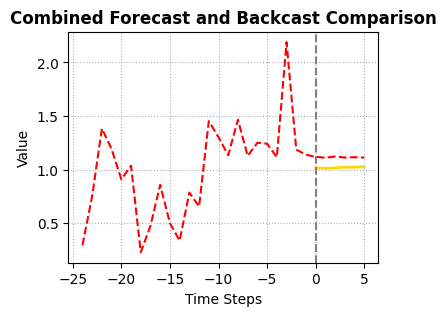

Epoch = 801, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 802, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 803, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 804, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 805, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 806, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 807, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 808, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 809, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 810, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 811, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 812, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 813, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 814, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 815, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 816, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 817, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 818, Train Loss = 0.0000, Test Loss = 0.0001
Epoch = 819, Train Loss = 0.0000, Test Loss = 

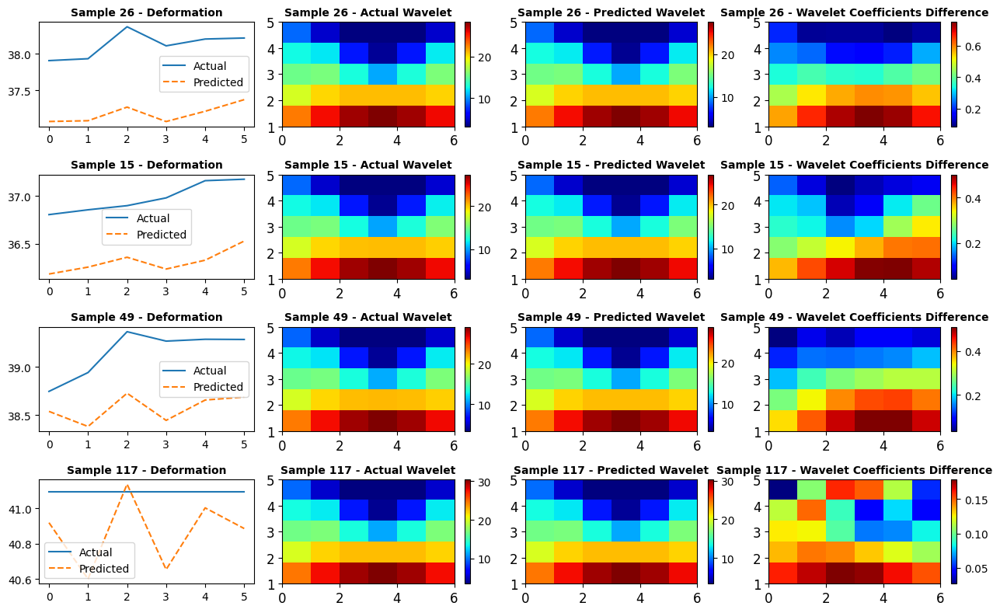

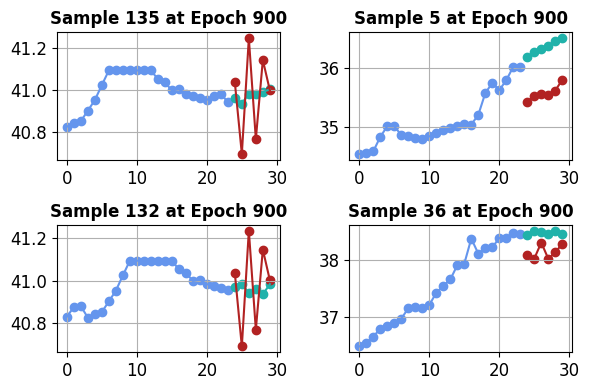

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.50681424, -0.12542245,  0.16391829, -0.22165821,  0.04548056,
       -0.22836582, -0.28295302, -0.0073517 , -0.29684064, -0.34309042,
       -0.30989966,  0.14891781,  0.1027839 ,  0.55120856,  0.02831453,
       -0.33991072,  0.02459289, -0.01997671,  0.12364796, -0.4273516 ,
       -0.59584033,  0.65741503, -0.27199632,  0.29275596], dtype=float32), 'forecast': array([ 0.2923936 , -0.1170507 ,  0.30979338,  0.09396481, -0.32384944,
       -0.35269034], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.1265175 , -0.07121652,  0.24999367,  0.40199763, -0.17306551,
        0.18488114, -0.561652  , -0.6067625 ,  0.0842598 , -0.21080576,
       -0.37663496, -0.3951251 , -0.49019617, -0.19257645,  0.13722463,
        0.2944011 ,  0.21849799, -0.09047689, -0.11730182,  0.43775448,
        0.5110274 ,  0.3533761 ,  0.31881526, -0.26514757], dtype=float32), 'forecast': array([-0.11821974,  0.17283584, -0.2

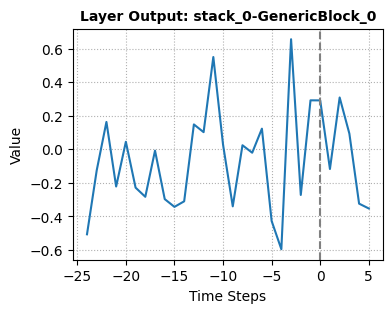

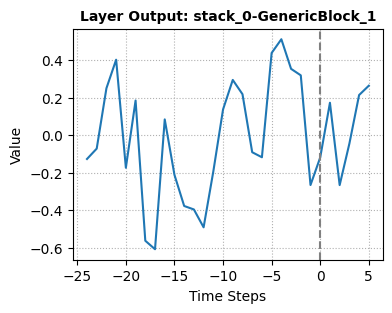

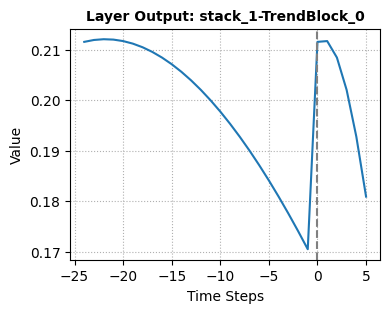

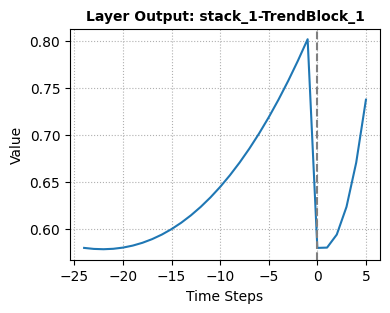

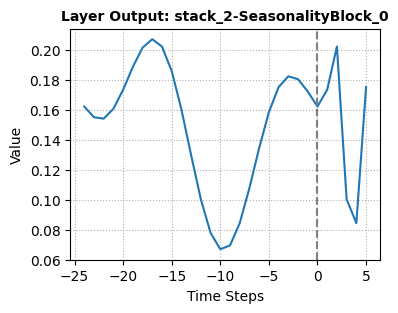

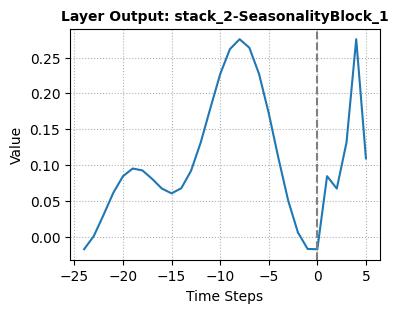

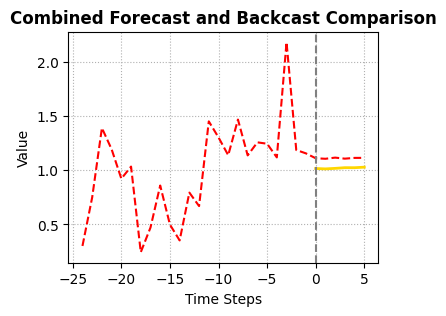

Epoch = 901, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 902, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 903, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 904, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 905, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 906, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 907, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 908, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 909, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 910, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 911, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 912, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 913, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 914, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 915, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 916, Train Loss = 0.0001, Test Loss = 0.0002
Epoch = 917, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 918, Train Loss = 0.0001, Test Loss = 0.0001
Epoch = 919, Train Loss = 0.0001, Test Loss = 

In [35]:
save_dir = 'plots_K1_2B3'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

# Conclusion
Overall, it is observed that in landslides characterized by slow creep patterns, the features extracted by the STEN illustrate that they appear to capture the seasonal deformation patterns of these movements effectively. 

In [36]:
import os
from google.colab import files


# Download all Results
folders_to_zip = [
    '/content/plots_K1_2B3',
    '/content/plots_K1_3B4',
    '/content/plots_K2_2B3',
    '/content/plots_K3_2B3',
    '/content/FFT_analysis_results'
]


zip_path = '/content/collected_data_for_Creepinglandslide.zip'


os.system(f"zip -r {zip_path} " + " ".join(folders_to_zip))

files.download(zip_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>